In [1]:
import torch as tr
import os
import re

if tr.backends.mps.is_available():
    device = tr.device("mps")
    x = tr.ones(1, device=device)
    print (x)
elif tr.cuda.is_available():
    device = tr.device("cuda")
    x = tr.ones(1, device=device)
    print (x)
else:
    print ("MPS or cuda device not found.")

from GP import *
import numpy as np
import matplotlib.pyplot as plt
import statistics as st

import scipy.integrate as integrate
#from orthogonal_poly import legendre_01

from torch.autograd.functional import hessian

import scipy.integrate as integrate

import h5py as h5

# import all packages and set plots to be embedded inline
import datetime
#from pyDOE import lhs 
import time
#load all the Models and Kernels
from functions import *

tensor([1.], device='cuda:0')


## Models 

In [ ]:
#you have the same function "Modeldef" in the functions.py file but for easy editing I will put it here
def Modeldef1(ITD,modelname,kernelname,nugget,device,mode,ID,test,grid,Nx):
    fits_comb=[]
    mean,sigma,config,mod,ker,modfunc,kerfunc,device,mode,ID,x_grid,lab = arguments(modelname,kernelname,nugget,device,mode,ID,grid,Nx)
    nu,rMj,rMe,rM = get_data(ITD)
    now = datetime.datetime.now()
    print("#################Define the model###########################")
    print ("Current date and time :", now.strftime("%Y-%m-%d %H:%M:%S"))
    print("GP specifications \n Sampling or training: "+mode+"\n model: "+modelname+"\n kernel: "+kernelname+" nugget: "+ nugget+"\n Ioffe time Distribution: "+ITD+"(M)",
          "\n mean =",mean,"\n sigma =",sigma,"\n prior dist =",config,"\n model init =",mod,"\n kernel init =",ker,"\n device =",device,"\n mode =",mode,"\n ID =",ID)
    #print("0=gaussian, 1=lognormal, 2=expbeta")
    for i in range(0,12):
        x_gri0,V0,Y0,Gamma0 = preparedata(i,nu,rMj,rMe,rM,x_grid,ITD=ITD)
        myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z={i+1}a",nugget=nugget,device=device,ITD=ITD,labels=lab,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
        myGP0.prior2ndlevel(mode,0.99,mean=mean,sigma=sigma,prior_mode=config)
        fits_comb.append(myGP0)
        #print(fits_comb[i].name, "done")
    if ITD=="Re" and test=="mock":
        numax=[4,10,25]
        for j in range(0,3):
            x_gri0,V0,Y0,Gamma0 = preparemockdata1(numax[j]+1,numax[j],x_grid,ITD)
            myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z=mock({numax[j]})",nugget=nugget,device=device,ITD=ITD,labels=lab,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
            myGP0.prior2ndlevel(mode,0.99,mean=mean,sigma=sigma,prior_mode=config)
            fits_comb.append(myGP0)
            #print(fits_comb[-1].name, "done")
    elif test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        for i in [4,10,25]:
            datanu4 = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax'+str(i)+'.dat',dtype=np.float64)
            x_gri0,V0,Y0,Gamma0 = NNPDFdata(datanu4,x_grid,[1e-12,1e-13,1e-14],[1e-10,1e-10],ITD)
            myGP0= GaussianProcess(x_gri0,V0,Y0,Gamma0,f"z=NNPDF({i})",nugget=nugget,device=device,ITD=ITD,labels=lab,Pd=modfunc, Ker=kerfunc,Pd_args=mod,Ker_args=ker)
            myGP0.prior2ndlevel(mode,0.99,mean=mean,sigma=sigma,prior_mode=config)## 0.99 determines the smoothness of the proposed flat prior
            fits_comb.append(myGP0)
            print(fits_comb[-1].name, "done")
    return fits_comb

In [ ]:
#define the Re and Im
#kernelname="Krbflog"
nugget="no" #only if you want to do another regularization for our GP
device="cpu"#It works in single precision
mode="all" #which parameters are you going to sample or train
grid="lin"
grid2="log_lin"
ID=12
Nx=125*2
ITD="Im"

test="NNPDF"#"mock" #Depending of the test you want to do, mock data need work

fits_comb=Modeldef("Im",'PDF','jacobi',nugget,device,mode,ID,test,grid2,Nx)
#fits_comb_Im=Modeldef("Im",'ModelC','Krbflog',nugget,device,mode,ID,test,grid,Nx)

#################Define the model###########################
Current date and time : 2025-03-07 12:06:25
GP specifications 
 Sampling or training: all
 model: PDF
 kernel: jacobi nugget: no
 Ioffe time Distribution: Im(M) 
 mean = tensor([-1.,  0.,  0.,  0., -1.,  0.,  0.]) 
 sigma = tensor([ 2., 15., 15., 20.,  2., 20., 20.]) 
 prior dist = tensor([2, 2, 2, 2, 2, 2, 2]) 
 model init = (0.0, 1.0, 2.0) 
 kernel init = (2.5, 0.5, 1.0, 2.0) 
 device = cpu 
 mode = all 
 ID = 12


/sciclone/home/yacahuanamedra/.conda/envs/gptorch/lib/python3.12/site-packages/torchquad/integration/utils.py:248: UserWarning: DEPRECATION WARNING: In future versions of torchquad, an array-like object will be returned.
  warnings.warn(


z=NNPDF(4) done
z=NNPDF(10) done
z=NNPDF(25) done


## NNPDF

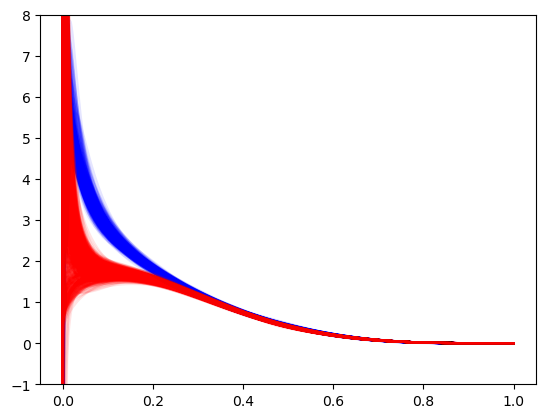

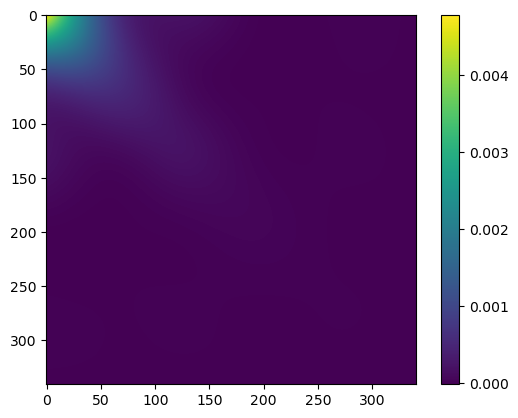

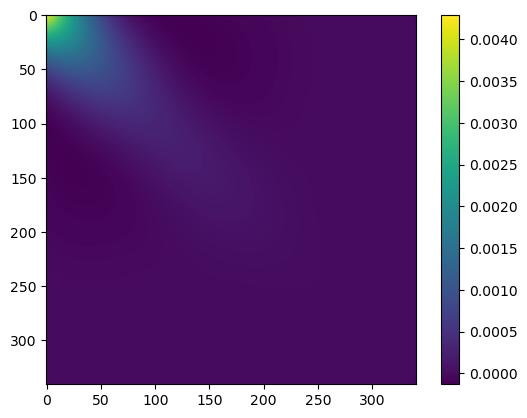

In [32]:
pdfminus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_minus.dat',dtype=np.float64)
pdfplus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_plus.dat',dtype=np.float64)
pdf_bar=pdfplus[:,1:]+pdfminus[:,1:] #We are reconstructing p+ and p-
pdf=pdfplus[:,1:]-pdfminus[:,1:]
#plot the data
for i in range(1,1000):
    plt.plot(pdfplus[:,0],pdfminus[:,i],alpha=0.1,color='blue')
for i in range(1,1000):
    plt.plot(pdfplus[:,0],pdfplus[:,i],alpha=0.1,color='red')

#plot uncertainty of the data

covmin=np.cov(pdfminus[:,1:])
covplus=np.cov(pdfplus[:,1:])
meanplus=pdfplus[:,1:].mean(axis=1)
meanminus=pdfminus[:,1:].mean(axis=1)
#plot the uncertainty
#plt.plot(pdfplus[:,0],meanplus+np.sqrt(np.diag(covplus)),color='blue',ls='--')
#plt.plot(pdfplus[:,0],meanplus-np.sqrt(np.diag(covplus)),color='blue',ls='--')
#plt.plot(pdfplus[:,0],meanminus+np.sqrt(np.diag(covmin)),color='red',ls='--')
#plt.plot(pdfplus[:,0],meanminus-np.sqrt(np.diag(covmin)),color='red',ls='--')

plt.ylim([-1,8])
plt.show()

plt.imshow(covplus[200:,200:])
plt.colorbar()
plt.show()
plt.imshow(covmin[200:,200:])
plt.colorbar()



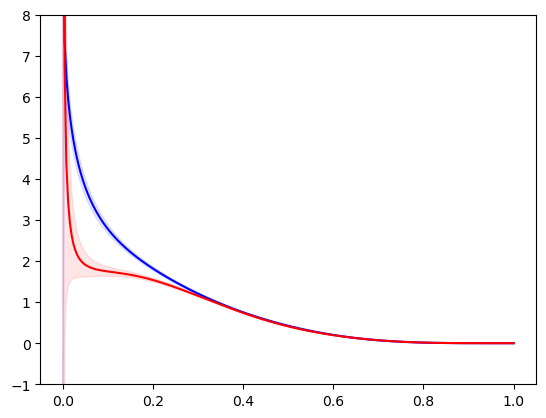

In [ ]:
#Interpolate the data
x_grid=generategrid(Nx,grid2)
pdfminus_interp=np.interp(x_grid,pdfminus[:,0],meanminus)
pdfplus_interp=np.interp(x_grid,pdfplus[:,0],meanplus)
covmin_interp=np.interp(x_grid,pdfminus[:,0],np.diag(covmin))
covplus_interp=np.interp(x_grid,pdfplus[:,0],np.diag(covplus))
plt.plot(x_grid,pdfminus_interp,color='blue')
plt.fill_between(x_grid,pdfminus_interp-np.sqrt(covmin_interp),pdfminus_interp+np.sqrt(covmin_interp),color='blue',alpha=0.1)
plt.plot(x_grid,pdfplus_interp,color='red')
plt.fill_between(x_grid,pdfplus_interp-np.sqrt(covplus_interp),pdfplus_interp+np.sqrt(covplus_interp),color='red',alpha=0.1)
plt.ylim([-1,8])
plt.show()



## optimal truncation

In [14]:
datanu25_re= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_real_numax25.dat',dtype=np.float64)
datanu10_re= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_real_numax10.dat',dtype=np.float64)
datanu4_re= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_real_numax4.dat',dtype=np.float64)
datanu25_im= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_imag_numax25.dat',dtype=np.float64)
datanu10_im= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_imag_numax10.dat',dtype=np.float64)
datanu4_im= np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_imag_numax4.dat',dtype=np.float64)

[1.10736648e-02 3.06822562e-04 1.04355269e-04 4.36235883e-05
 1.24192293e-05 3.96249254e-06 4.28678974e-07 7.08307190e-08
 2.07836981e-09 1.74399859e-11 8.71421472e-14 2.41165000e-16
 6.63013164e-19 4.35251081e-19 3.90907326e-19 2.93183065e-19
 2.72378075e-19 1.98710668e-19 1.50761610e-19 1.26732248e-19
 7.55069496e-20 6.51701279e-20 4.40847260e-20 2.41174301e-20
 1.73217316e-20]
6.630131643899051e-19 9.385173126036966e-10 8.313861009955045e-07


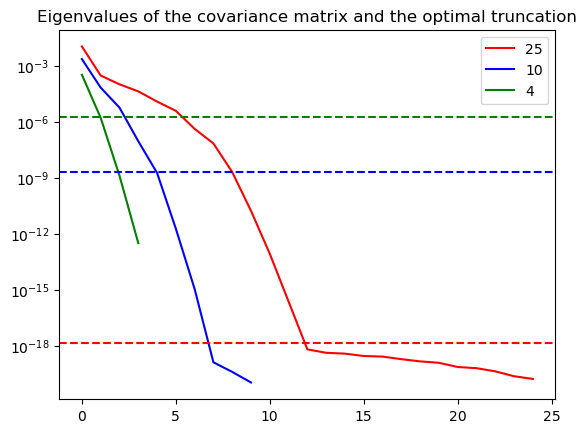

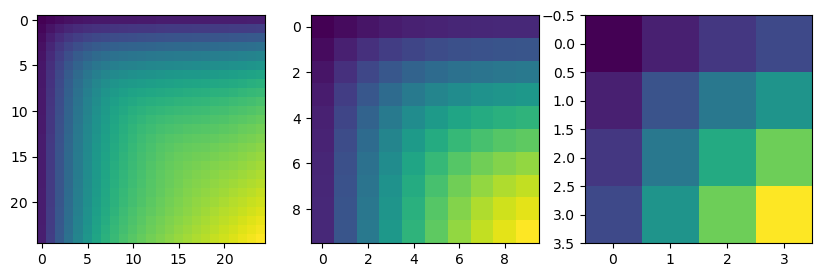

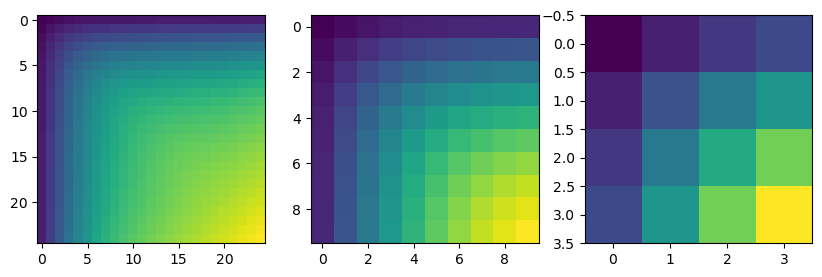

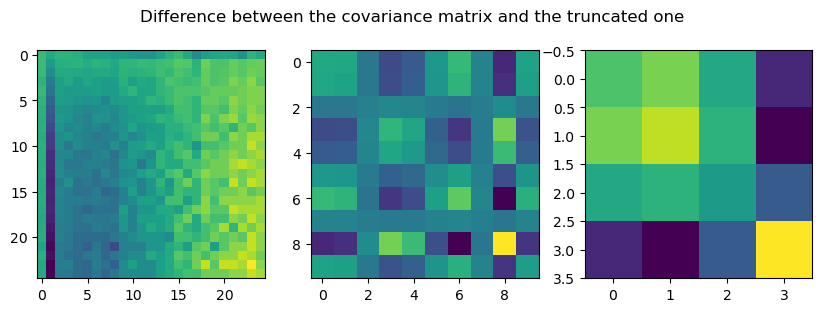

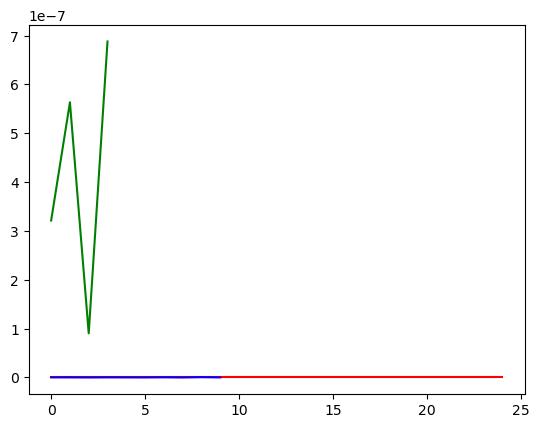

In [24]:
cov25=np.cov(datanu25_im.T[2:].T)
svd25=np.linalg.svd(cov25)
cov10=np.cov(datanu10_im.T[2:].T)
svd10=np.linalg.svd(cov10)
cov4=np.cov(datanu4_im.T[2:].T)
svd4=np.linalg.svd(cov4)
print(svd25[1])
med25=np.median(svd25[1],axis=0)
med10=np.median(svd10[1],axis=0)
med4=np.median(svd4[1],axis=0)
print(med25,med10,med4)
plt.title('Eigenvalues of the covariance matrix and the optimal truncation')
plt.plot(svd25[1],label='25',color='red')
plt.plot(svd10[1],label='10',color='blue')
plt.plot(svd4[1],label='4',color='green')
#plot constant line
optimal25=med25*4/np.sqrt(3)
optimal10=med10*4/np.sqrt(3)
optimal4=med4*4/np.sqrt(3)
#set to 0 all values below the optimal value
svd25[1][svd25[1]<optimal25]=0
svd10[1][svd10[1]<optimal10]=0
svd4[1][svd4[1]<optimal4]=0
cov25r=svd25[0] @ np.diag(svd25[1]) @ svd25[2]
cov10r=svd10[0] @ np.diag(svd10[1]) @ svd10[2]
cov4r=svd4[0] @ np.diag(svd4[1]) @ svd4[2]
plt.axhline(y=med25*4/np.sqrt(3), color='r', linestyle='--')
plt.axhline(y=med10*4/np.sqrt(3), color='b', linestyle='--')
plt.axhline(y=med4*4/np.sqrt(3), color='g', linestyle='--')
plt.legend()
plt.yscale('log')
plt.show()
#compare the covariance matrix
fig, ax = plt.subplots(1, 3, figsize=(10, 10), sharex=False, sharey=False)
ax[0].imshow(cov25)
ax[1].imshow(cov10)
ax[2].imshow(cov4)
plt.show()
fig, ax = plt.subplots(1, 3, figsize=(10, 10), sharex=False, sharey=False)
ax[0].imshow(cov25r)
ax[1].imshow(cov10r)
ax[2].imshow(cov4r)
plt.show()

#diference between the covariance matrix
fig, ax = plt.subplots(1, 3, figsize=(10, 10), sharex=False, sharey=False)
#general common title for all plots
fig.suptitle('Difference between the covariance matrix and the truncated one',y=.65)
ax[0].imshow(cov25-cov25r)
ax[1].imshow(cov10-cov10r)
ax[2].imshow(cov4-cov4r)
plt.show()

#compare diagonals
plt.plot(np.diag(cov25)-np.diag(cov25r),label='25',color='red')
plt.plot(np.diag(cov10)-np.diag(cov10r),label='10',color='blue')
plt.plot(np.diag(cov4)-np.diag(cov4r),label='4',color='green')

#plt.imshow(cov25)

z=NNPDF(25)
torch.Size([27, 27])
tensor([-2.5029e-07, -3.2851e-06, -1.3195e-05, -3.1127e-05, -5.4448e-05,
        -8.0078e-05, -1.0723e-04, -1.3650e-04, -1.6734e-04, -1.9746e-04,
        -2.2469e-04, -2.4877e-04, -2.7109e-04, -2.9303e-04, -3.1491e-04,
        -3.3621e-04, -3.5642e-04, -3.7522e-04, -3.9249e-04, -4.0832e-04,
        -4.2305e-04, -4.3715e-04, -4.5091e-04, -4.6440e-04, -4.7753e-04]) hola


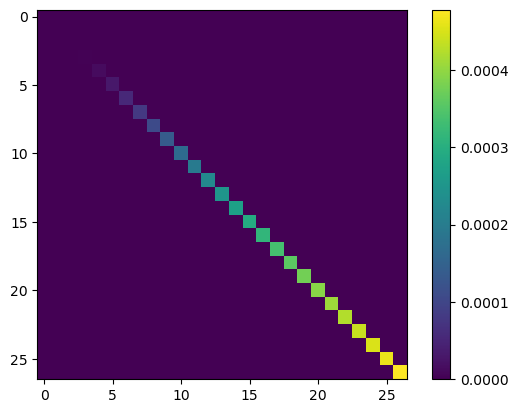

z=NNPDF(10)
torch.Size([12, 12])
tensor([1.0000e-12, 1.0000e-10, 2.5054e-07, 3.2884e-06, 1.3208e-05, 3.1158e-05,
        5.4502e-05, 8.0158e-05, 1.0734e-04, 1.3664e-04, 1.6751e-04, 1.9766e-04])


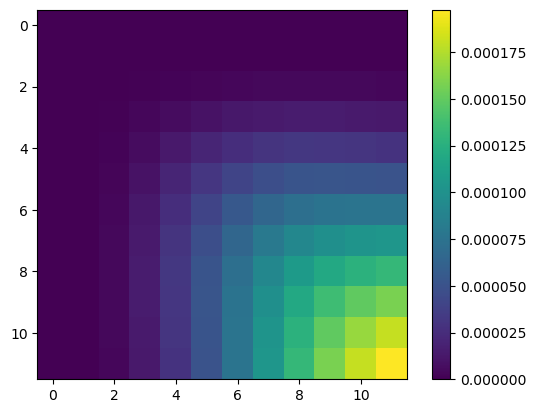

z=NNPDF(4)
torch.Size([6, 6])
tensor([1.0000e-12, 1.0000e-10, 2.5054e-07, 3.2884e-06, 1.3208e-05, 3.1158e-05])


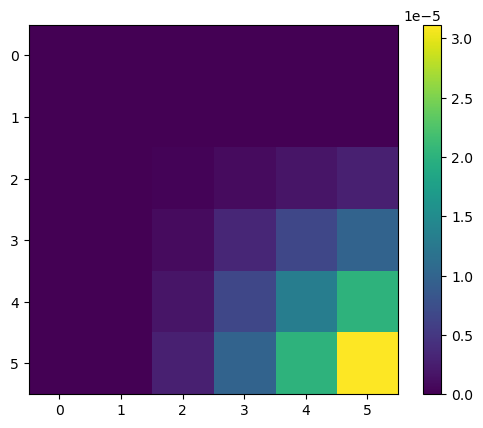

z=12a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 9.8393e-04, 4.1775e-03, 4.3370e-02, 1.2680e-02,
        4.1815e-02, 2.3819e-01])


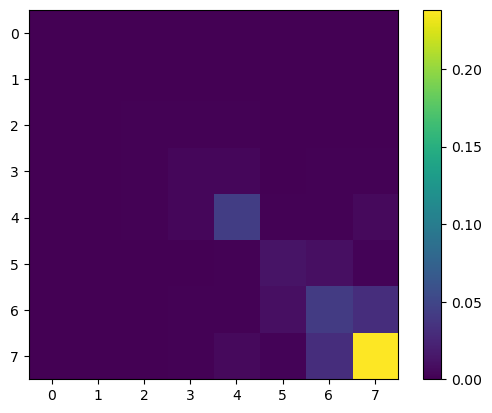

z=11a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 3.4799e-04, 1.4393e-03, 1.5191e-02, 4.4667e-03,
        1.4148e-02, 7.5649e-02])


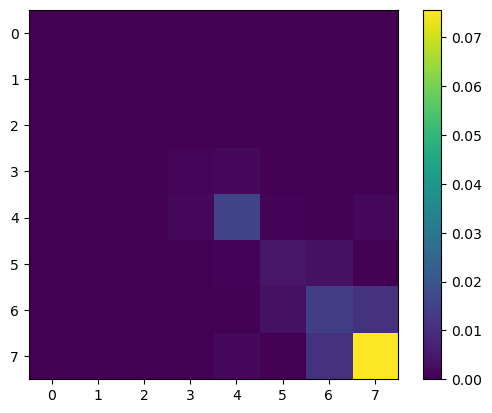

z=10a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 1.2369e-04, 4.7579e-04, 5.5883e-03, 1.8153e-03,
        5.3760e-03, 2.7853e-02])


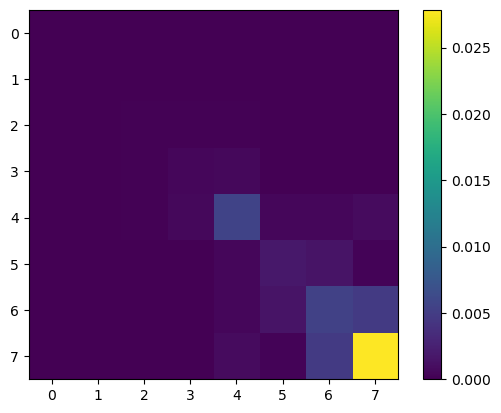

z=9a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 4.7102e-05, 1.6736e-04, 2.2645e-03, 8.4580e-04,
        2.4839e-03, 1.2677e-02])


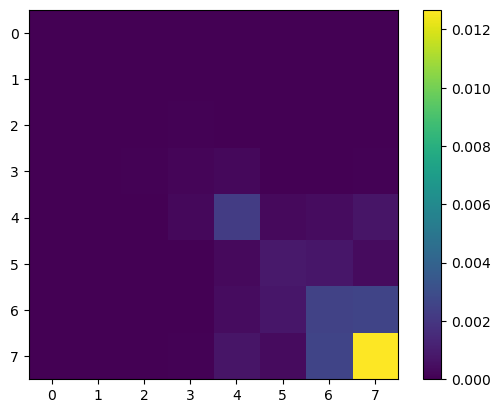

z=8a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 1.9290e-05, 6.5007e-05, 9.9721e-04, 4.3659e-04,
        1.4598e-03, 7.6809e-03])


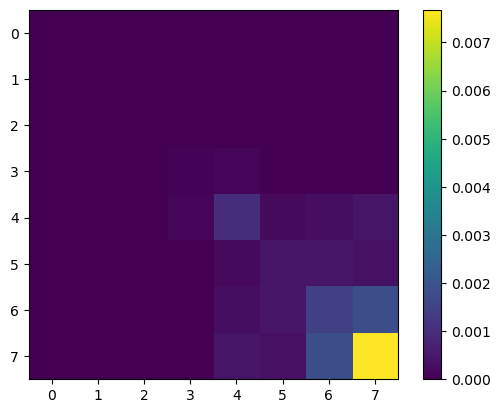

z=7a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 8.4484e-06, 2.7796e-05, 4.8448e-04, 2.3332e-04,
        9.7682e-04, 5.4979e-03])


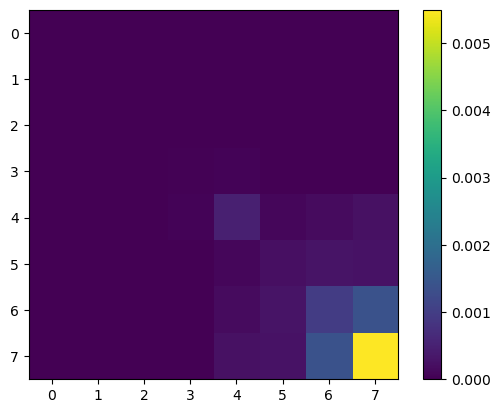

z=6a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 3.8613e-06, 1.2738e-05, 2.3840e-04, 1.2402e-04,
        6.2544e-04, 3.8157e-03])


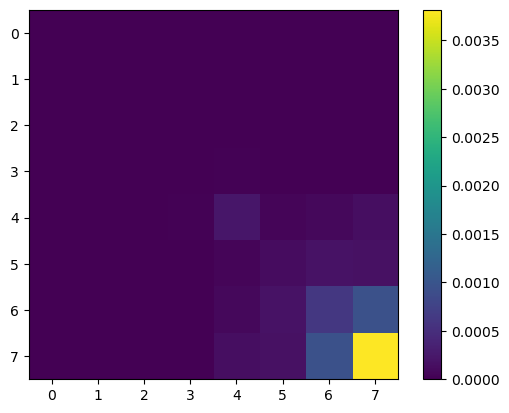

z=5a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 1.7161e-06, 5.7478e-06, 1.0965e-04, 6.0860e-05,
        3.5146e-04, 2.3411e-03])


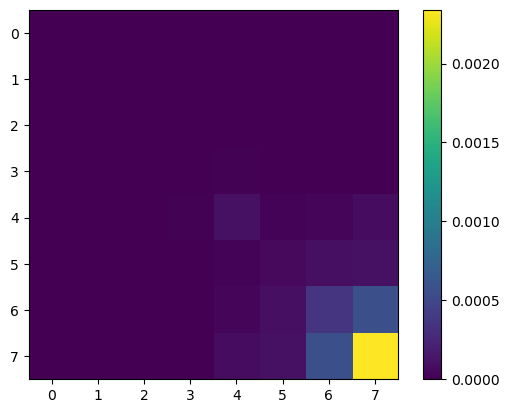

z=4a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 6.8187e-07, 2.2668e-06, 4.3662e-05, 2.5568e-05,
        1.6207e-04, 1.1594e-03])


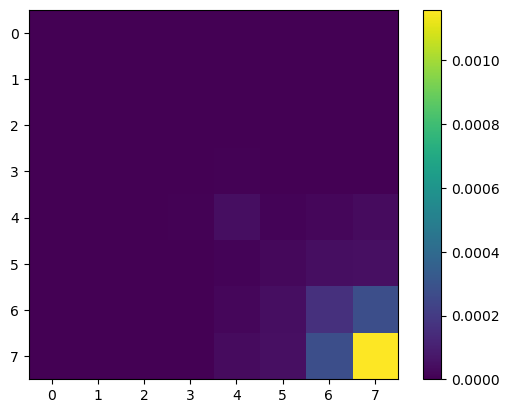

z=3a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 2.2706e-07, 7.3326e-07, 1.3374e-05, 8.1638e-06,
        5.5053e-05, 4.1332e-04])


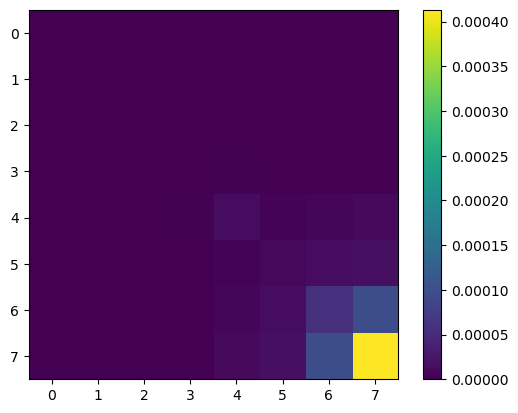

z=2a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 4.7812e-08, 1.5244e-07, 2.6027e-06, 1.6287e-06,
        1.1193e-05, 8.5153e-05])


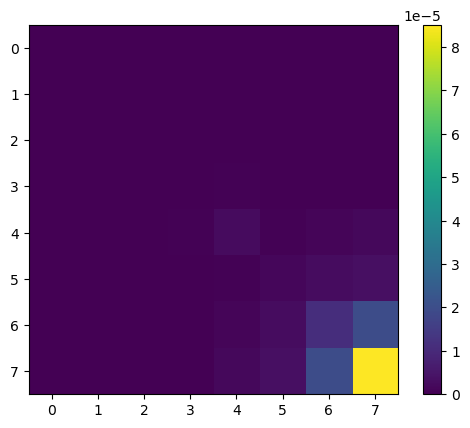

z=1a
torch.Size([8, 8])
tensor([1.0000e-10, 1.0000e-10, 3.6737e-09, 1.1297e-08, 1.7693e-07, 1.0636e-07,
        7.1552e-07, 5.3445e-06])


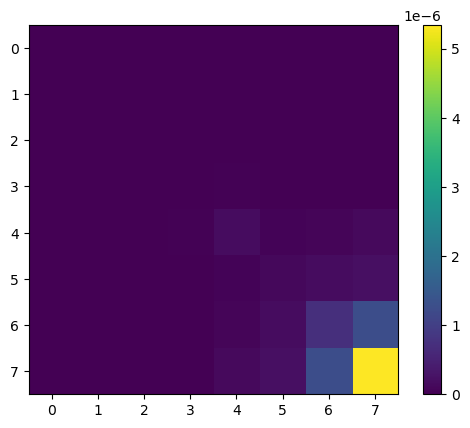

In [11]:
#print Gamma
number=len(fits_comb)
for i in reversed(range(0,number)):
    print(fits_comb[i].name)
    #fits_comb[i].Gamma=(fits_comb[i].Gamma+fits_comb[i].Gamma.T)/2.0
    plt.imshow(fits_comb[i].Gamma)
    print(fits_comb[i].Gamma.shape)
    if i==14:
        print(tr.diag(fits_comb[i].Gamma[2:])-tr.Tensor(datanu25.T[2:].std(axis=0))**2,"hola")
        #print(tr.diag(fits_comb[i].Gamma))
    else:
        print(tr.diag(fits_comb[i].Gamma))
    plt.colorbar()
    plt.show()

## Training or optimizing Hyperparameters

In [22]:
for i in range(0,number):
    fits_comb[i].hyperparametersvalues()

In [21]:
start=time.time()
number=len(fits_comb)
mode="all"
Ntrain=1000
function="nlp"
lr=1e-4
for i in range(0,number):
    if i in [111]:
        fits_comb[i].train(Ntrain,lr=lr*10,mode=mode,function=function)
    elif i in [134]:
        fits_comb[i].train(Ntrain,lr=lr,mode=mode,function=function)
    else:
        fits_comb[i].train(Ntrain,lr=lr*10,mode=mode,function=function)
    print(tr.tensor(fits_comb[i].pd_args +fits_comb[i].ker_args  + (fits_comb[i].sig,)))
end=time.time()
print("time",end-start)

Training everything z=1a
tensor([0.2427, 1.3008, 1.7123, 2.6489, 0.6536, 0.8613, 1.8446, 1.0000])
Training everything z=2a
tensor([0.1036, 1.4219, 1.6776, 2.6208, 0.5961, 0.9064, 1.8585, 1.0000])
Training everything z=3a
tensor([-0.4128,  1.5121,  1.5945,  2.7957,  0.0626,  0.8639,  1.5871,  1.0000])
Training everything z=4a
tensor([-0.4877,  1.2931,  1.7502,  2.9990, -0.2367,  0.3443,  1.4973,  1.0000])
Training everything z=5a
tensor([-0.4924,  1.2844,  1.7946,  3.0094, -0.1491,  0.3140,  1.5043,  1.0000])
Training everything z=6a
tensor([-0.4128,  1.2922,  1.7902,  3.1439, -0.1168,  0.7141,  1.4358,  1.0000])
Training everything z=7a
tensor([-0.3866,  1.2951,  1.8011,  3.1786, -0.1145,  0.8043,  1.4186,  1.0000])
Training everything z=8a
tensor([-0.3739,  1.3032,  1.7821,  3.1466, -0.1487,  0.7677,  1.4253,  1.0000])
Training everything z=9a
tensor([-0.3596,  1.3116,  1.7476,  3.0493, -0.2366,  0.6612,  1.4565,  1.0000])
Training everything z=10a
tensor([-0.3223,  1.3285,  1.7286,  

_LinAlgError: linalg.cholesky: The factorization could not be completed because the input is not positive-definite (the leading minor of order 1 is not positive-definite).

If your input is outside the limits of integration given by (shift, shift+scale) where mean=shift and sigma=scale this optimization runs into nans or inf

## Test Finite elements

In [ ]:
class FE2_Integrator:
    def __init__(self,x):
        self.N = x.shape[0]
        #new grid
        xx = np.append(x,[2.0*x[self.N-1] - x[self.N-2], 3.0*x[self.N-1]-2*x[self.N-2]] )
        #self.x = np.append([-x[0],0],xx)
        self.x = xx#np.append(0,xx)
        self.eI = 0

        self.Norm = np.empty(self.N)
        for i in range(self.N):
            self.Norm[i] = self.ComputeI(i, lambda x : 1)
            
    def pulse(self,x,x1,x2):
        return np.heaviside(x-x1,1.0)* np.heaviside(x2-x,1.0)
    
    def f(self,x,i):
        R=0.0
        ii =i#+1
        if(i==0):

            R+=(x- self.x[1])*(x- self.x[2])/((self.x[0] -self.x[2])*(self.x[0]-self.x[1]))*np.heaviside(x-self.x[0],1.0)* np.heaviside(self.x[2]-x,1.0)

            return R
        
        elif(ii==self.N-1):
            R += (x- self.x[ii-2])*(x- self.x[ii-1])/((self.x[ii] -self.x[ii-2])*(self.x[ii] -self.x[ii-1]))*self.pulse(x,self.x[ii-2],self.x[ii])
            return R
        ii =i#+1
        if((ii+1)%2==0):#Even
            R  += (x- self.x[ii-1])*(x- self.x[ii+1])/((self.x[ii] -self.x[ii+1])*(self.x[ii] -self.x[ii-1]))*self.pulse(x,self.x[ii-1],self.x[ii+1])
            return R
    
        else:#odd?
            R += (x- self.x[ii-2])*(x- self.x[ii-1])/((self.x[ii] -self.x[ii-2])*(self.x[ii] -self.x[ii-1]))*self.pulse(x,self.x[ii-2],self.x[ii  ])
            R += (x- self.x[ii+1])*(x- self.x[ii+2])/((self.x[ii] -self.x[ii+2])*(self.x[ii] -self.x[ii+1]))*self.pulse(x,self.x[ii],self.x[ii+2])
            return R

    
    def set_up_basis(self,newgrid):
        res = np.empty(newgrid.shape[0])
        for i in range(newgrid.shape[0]):
            res[i] = 0.0
            for j in range(self.N):
                res[i] += self.f(newgrid[i],j)#*self.Norm[j]
        return res
    
    def set_up_integration(self,Kernel = lambda x: 1):
        res = np.empty(self.N)
        for i in range(self.N):
            res[i] = self.ComputeI(i,Kernel)
        return res
    
        
    # assume symmetrix function F(x,y) = F(y,x)
    # for efficiency 
    def set_up_dbl_integration(self,Kernel = lambda x,y: 1):
        res = np.empty([self.N,self.N])
        for i in range(self.N):
            for j in range(i,self.N):
                res[i,j] = self.ComputeIJ(i,j,Kernel)
                res[j,i]  = res[i,j]
        return res


    def ComputeI(self,i,Kernel):
        eps=1e-8
        if(i==0):
            I,eI = integrate.quad(lambda x: Kernel(x)*self.f(x,0), self.x[0], self.x[2],epsabs=eps)
            self.eI += eI
            return I
        if(i==self.N):
            I,eI = integrate.quad(lambda x: Kernel(x)*self.f(x,self.N-1), self.x[self.N-3], self.x[self.N-1],epsabs=eps)
            self.eI += eI
        ii=i
        if((ii+1)%2==0):
            I,eI = integrate.quad(lambda x: Kernel(x)*self.f(x,i), self.x[ii-1], self.x[ii+1],epsabs=eps)
            self.eI += eI
        else:
            I,eI = integrate.quad(lambda x: Kernel(x)*self.f(x,i), self.x[ii-2], self.x[ii+2], epsabs=eps)
            self.eI += eI
        return I
    
    def ComputeIJ(self,i,j,Kernel):
        # I need to fix the i=0 case
        ii=i+1
        jj=j+1
        if(ii%2==0):
            xx = (self.x[ii-1], self.x[ii+1])
        else:
            xx = (self.x[ii-2], self.x[ii+2])
        if(jj%2==0):
            yy = (self.x[jj-1], self.x[jj+1])
        else:
            yy = (self.x[jj-2], self.x[jj+2])
        
        I,eI = integrate.dblquad(lambda x,y: self.f(x,i)*Kernel(x,y)*self.f(y,j), yy[0], yy[1],xx[0], xx[1],epsrel=1e-12)
        self.eI += eI

        return I

In [ ]:
Nx=256+1
x_grid = np.linspace(0.0,1.0,np.int32(Nx))
fe = FE2_Integrator(x_grid)
Nx=x_grid.shape[0]
nn = np.linspace(1e-6,6,100, dtype='d')
iB = np.zeros((nn.shape[0],Nx))
for k in range(nn.shape[0]):
    if ITD=="Re":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    elif ITD=="Im":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.sin(nn[k]*x))


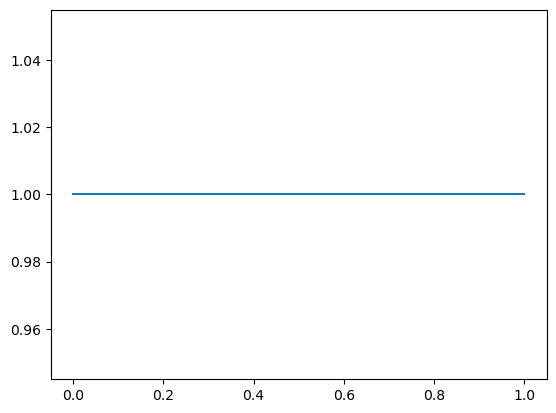

In [47]:
#plot the basis
init=0
fin=1000
newgrid = np.linspace(0.0,1.0,1000)
plt.plot(newgrid[init:fin],fe.set_up_basis(newgrid[init:fin]),label='0')

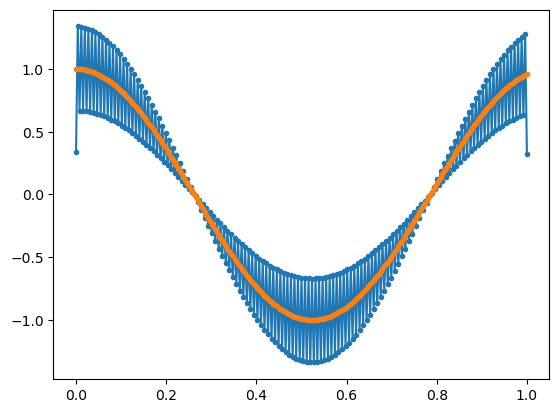

In [44]:
lim1=0
lim=Nx
s=9
#plot with dots and lines
plt.plot(x_grid[lim1:lim],Nx*iB[s,lim1:lim],'.-')
plt.plot(x_grid[lim1:lim],np.cos(nn[s]*x_grid[lim1:lim]),'.-')
#plt.plot(x_grid[0:lim],x_grid[0:lim]**2)

[ 1.11022302e-16  0.00000000e+00 -1.11022302e-16  0.00000000e+00
 -2.77555756e-17  0.00000000e+00  0.00000000e+00 -5.55111512e-17
  0.00000000e+00  0.00000000e+00]


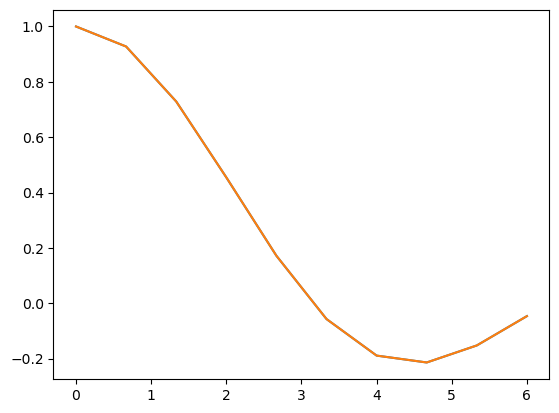

In [45]:
qtest=np.ones_like(x_grid)
integral= iB@qtest
error=integral-np.sin(nn)/nn
print(error)
plt.plot(nn,integral)
plt.plot(nn,np.sin(nn)/nn)

## plot trained GP

In [16]:
x_grid= generategrid(Nx,grid2)
fe = FE2_Integrator1(x_grid)
Nx=x_grid.shape[0]
nn = np.linspace(0,26,128, dtype='d')
iB = np.zeros((nn.shape[0],Nx))
ITD="Im"
for k in range(nn.shape[0]):
    if ITD=="Re":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    elif ITD=="Im":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.sin(nn[k]*x))
print(ITD)


Im


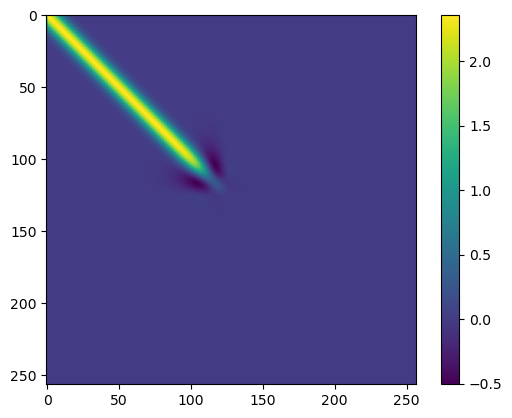

In [12]:
p,Cp = fits_comb[14].ComputePosterior()
plt.imshow(Cp)
plt.colorbar()

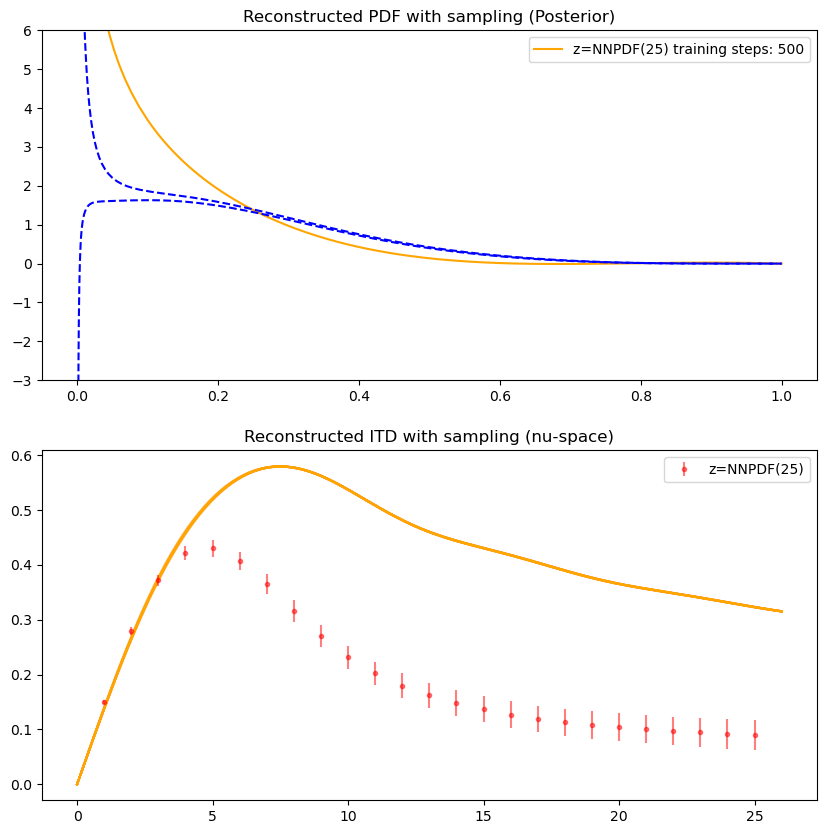

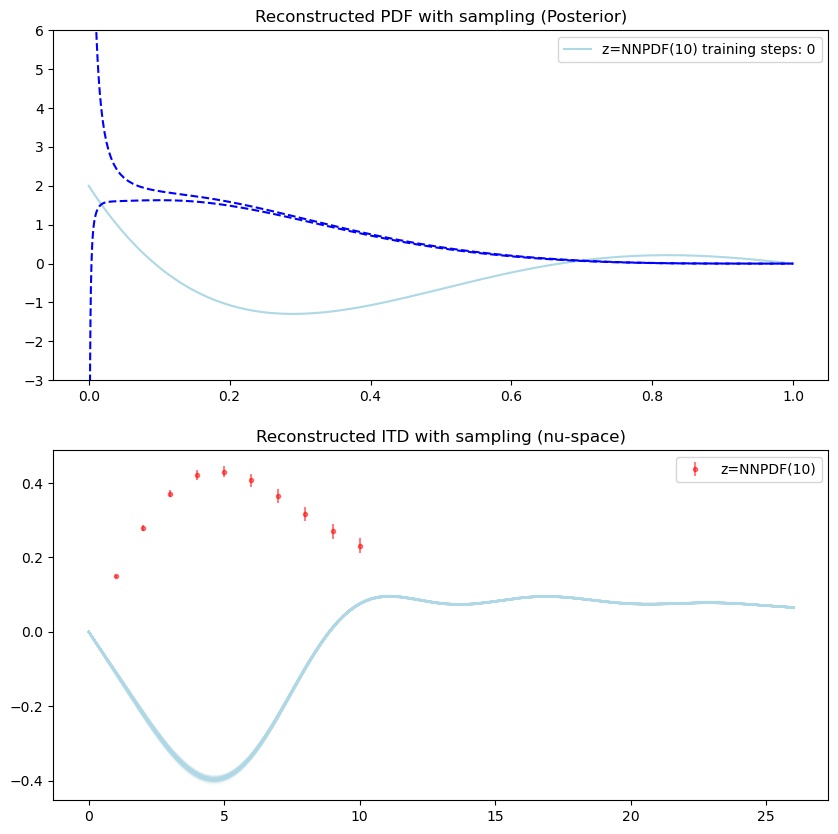

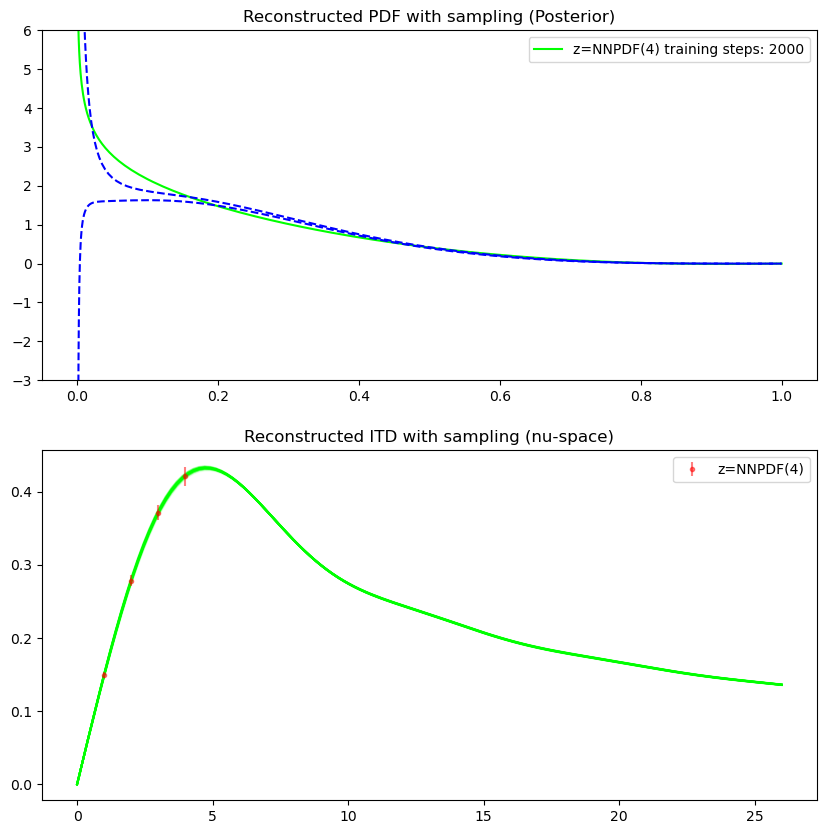

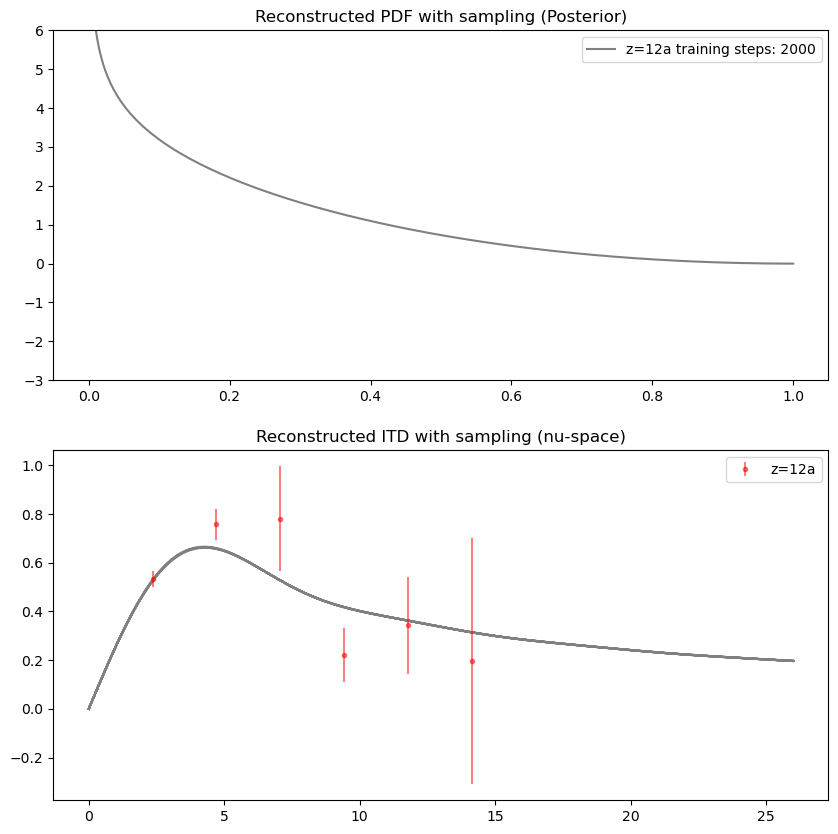

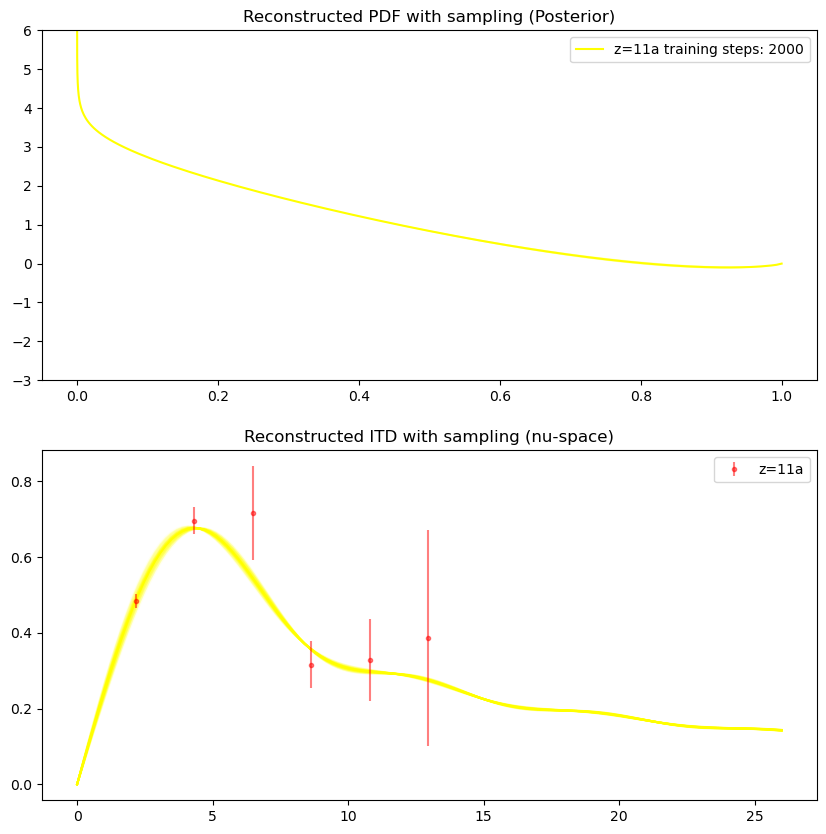

...

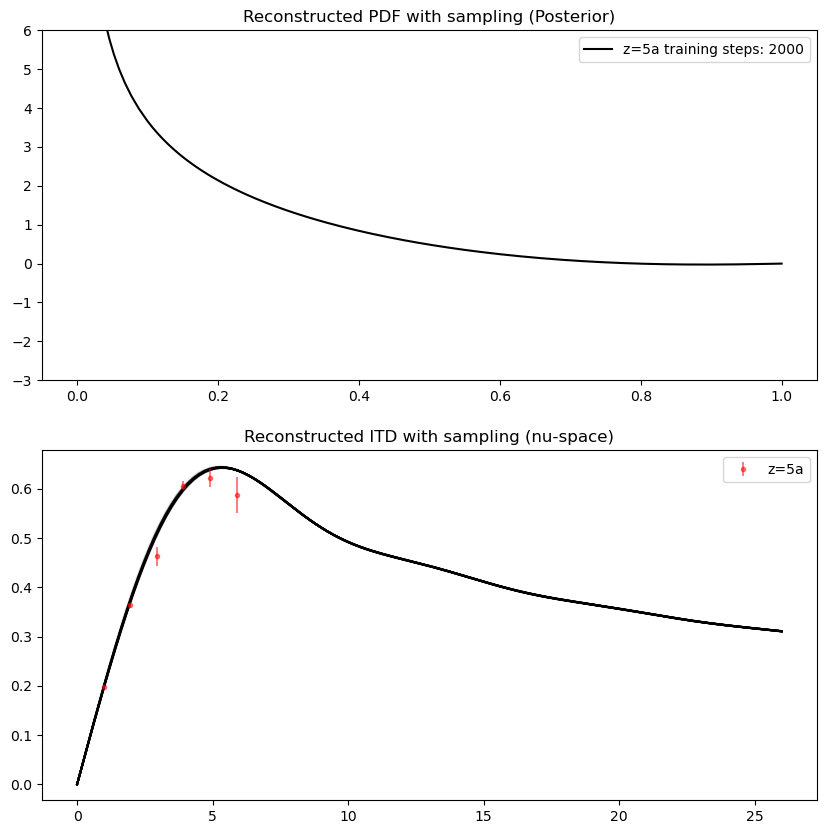

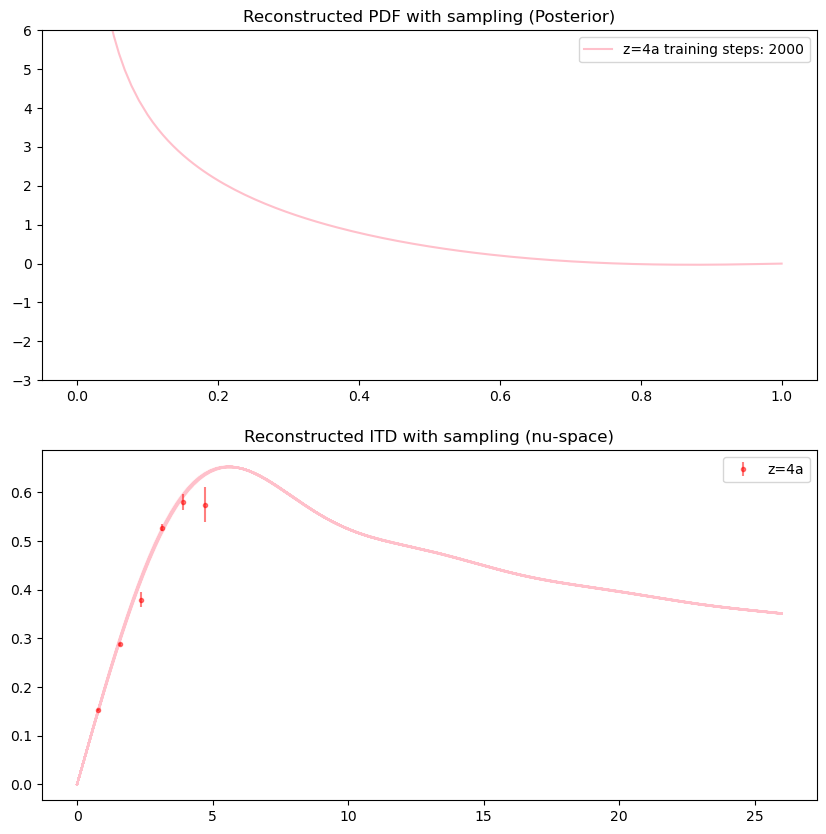

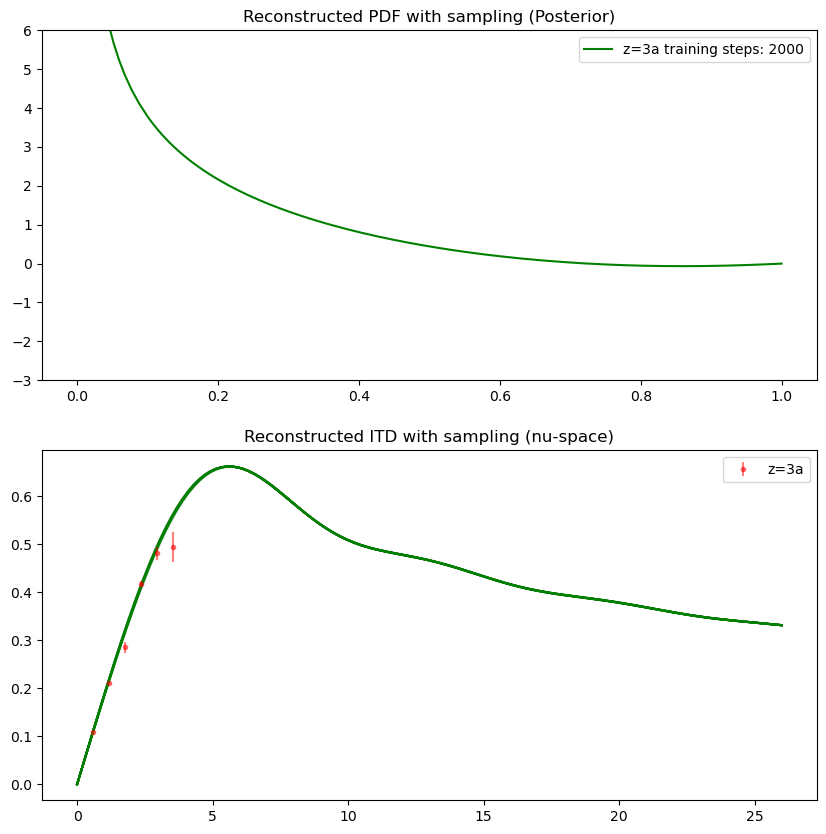

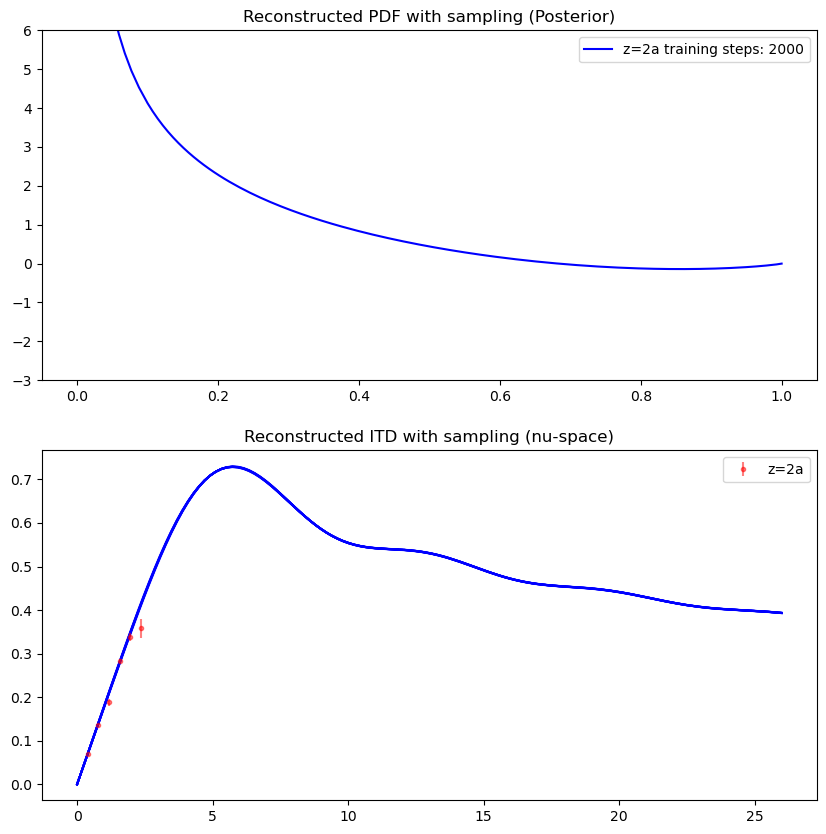

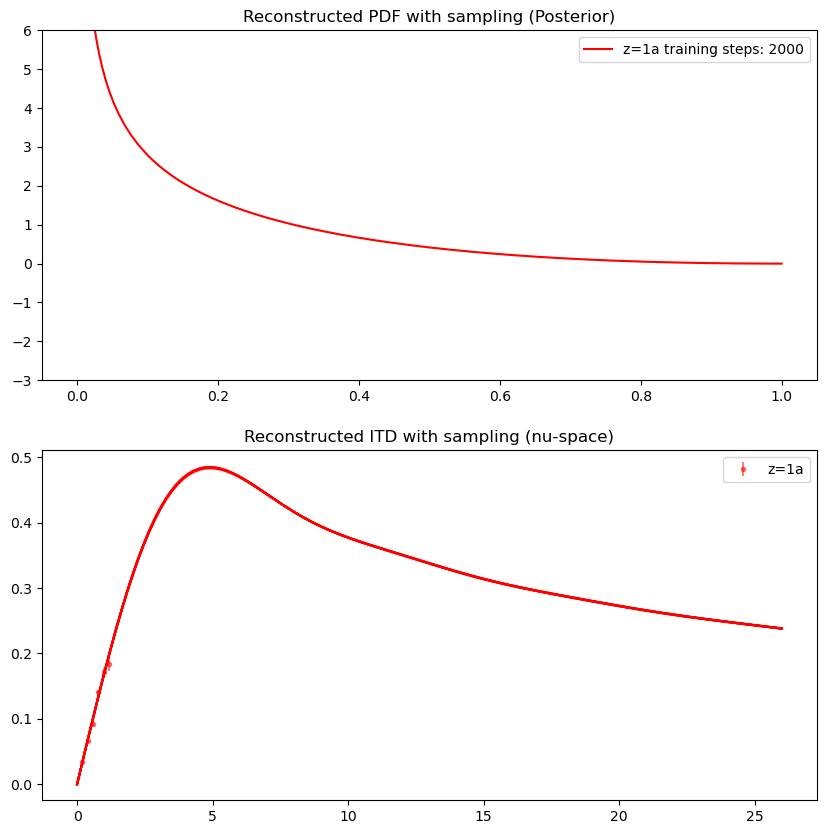

In [17]:
number=len(fits_comb)
col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
for i in reversed(range(0,number)):
    if i in [113]:
        continue
    else:
        x_gri0=x_grid
        nu,rMj,rMe,rM = get_data(ITD)
        fig, ax= plt.subplots(2,figsize=(10, 10))
        ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
        ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
        p,Cp = fits_comb[i].ComputePosterior()
        p,Cp = p.to("cpu"),Cp.to("cpu")
        Cp = 0.5*(Cp+Cp.T) #+1e-6*tr.eye(Cp.shape[0])#regulate the posterior covariance
        #Mc=tr.distributions.MultivariateNormal(p,covariance_matrix=Cp)
        
        svd=np.linalg.svd(Cp)
        #make it positive definite
        #svd[1][svd[1]<1e-10]=1e-10

        Cp=svd[0] @ np.diag(np.abs(svd[1])) @ svd[2]
        Cp=0.5*(Cp+Cp.T) +1e-6*np.eye(Cp.shape[0])#regulate the posterior covariance
        pdfMc= np.random.multivariate_normal(p,Cp,(100,))
        #plot the data
        #pdfMc = Mc.sample((100,))
        #ax[0].plot(x_grid,pdfMc.T,alpha=0.1,color=col[i])
        ax[0].plot(x_gri0,p,label=fits_comb[i].name+' training steps: '+str(fits_comb[i].trainingcount),color=col[i])
        perror=np.diag(Cp)**(0.5)
        #p=fits_comb[i].Pd(fits_comb[i].x_grid.cpu(),*fits_comb[i].pd_args).numpy()
        ax[0].fill_between(x_gri0, p - perror, p + perror, facecolor=col[i], alpha=0.3)
        
        ax[0].legend()
        ax[0].set_ylim([-3.,6])
        #ax[0].ylim([-0.1,4])
        ttQ = pdfMc@iB.T
        mttQ = ttQ.mean(axis=0)
        ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
        ax[1].plot(nn,mttQ,color=col[i])
        if i >=12 and test=="NNPDF":
            if ITD=="Re":
                MMM='real'
            elif ITD=="Im":
                MMM='imag'
            if i==12:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
            elif i==13:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
            elif i==14:
                datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
            #print(datanu.T[1])
            nu_d_grid = datanu.T[1]
            
            M=datanu.T[2:].mean(axis=0)
            eMnu=datanu.T[2:].std(axis=0)#*np.sqrt(M.shape[0]-1)
            pdfminus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_minus.dat',dtype=np.float64)
            pdfplus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_plus.dat',dtype=np.float64)
            covmin=np.cov(pdfminus[:,1:])
            covplus=np.cov(pdfplus[:,1:])
            meanplus=pdfplus[:,1:].mean(axis=1)
            meanminus=pdfminus[:,1:].mean(axis=1)
            #plot the uncertainty
            if ITD=="Im":
                ax[0].plot(pdfplus[:,0],meanplus+np.sqrt(np.diag(covplus)),color='blue',ls='--')
                ax[0].plot(pdfplus[:,0],meanplus-np.sqrt(np.diag(covplus)),color='blue',ls='--')
            else:   
                ax[0].plot(pdfplus[:,0],meanminus+np.sqrt(np.diag(covmin)),color='red',ls='--',alpha=0.5)
                ax[0].plot(pdfplus[:,0],meanminus-np.sqrt(np.diag(covmin)),color='red',ls='--',alpha=0.5)



            plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        elif i<12:
            plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
        plt.legend()
        plt.show()

# Sampling

In [20]:
##sample all the parameters
#momentum=1*tr.tensor([1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0])
#sigma=tr.tensor([3.0,5.0,6.0,5.0,6.0,5.0,5.5,2.0])
momentum=tr.ones_like(mean)
samplers=[]
for i in range(0,13):
    #GPsampler=HMC_sampler(myGP0.nlogpost2levelpdf,grad=myGP0.gradlogpost2levelpdf,diagonal=momentum)
    #shift=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")-tr.ones(8)
    #shift=tr.tensor([0,0, 0.9851, 1.7835, 1.6409, 0.8482, 1.0654,0.0627])-tr.ones(8)
    #fits_comb[i].prior2ndlevel("kernel",1000,mean=shift,sigma=2*tr.ones(8),prior_mode=tr.tensor([2,2,2,2,2,2,2,2]))
    GPsampler=HMC_sampler(fits_comb[i].nlogpost2levelpdf,device="cpu",diagonal=1.0*momentum,grad=None)
    #rand=tr.rand(7)*5
    
    #GPsampler.q0=tr.tensor(fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")
    
    #GPsampler.q0=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args+ (fits_comb[i].sig,)).to("cpu")
    #print(GPsampler.q0)
    GPsampler.q0=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args).to("cpu")#+ (fits_comb[i].sig,))
    samplers.append(GPsampler)
    print(fits_comb[i].name,"sampler done")

z=1a sampler done
z=2a sampler done
z=3a sampler done
z=4a sampler done
z=5a sampler done
z=6a sampler done
z=7a sampler done
z=8a sampler done
z=9a sampler done
z=10a sampler done
z=11a sampler done
z=12a sampler done
z=mock sampler done


The purpose of this nugget hyperparameter is to determine if the kernel with a extra hyperparameter has more or less uncertainty

### Model+ Kernel

In [14]:
##sample all the parameters
momentum=tr.ones_like(mean)
sigma=tr.tensor([3.0,5.0,6.0,5.0,6.0,5.0,5.5,2.0])
samplers=[]
for i in range(0,number):
    #GPsampler=HMC_sampler(myGP0.nlogpost2levelpdf,grad=myGP0.gradlogpost2levelpdf,diagonal=momentum)
    #shift=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")-tr.ones(8)
    #shift=tr.tensor([0,0, 0.9851, 1.7835, 1.6409, 0.8482, 1.0654,0.0627])-tr.ones(8)
    #fits_comb[i].prior2ndlevel("kernel",1000,mean=shift,sigma=2*tr.ones(8),prior_mode=tr.tensor([2,2,2,2,2,2,2,2]))
    GPsampler=HMC_sampler(fits_comb[i].nlogpost2levelpdf,device="cpu",diagonal=1.0*momentum,grad=None)
    #rand=tr.rand(7)*5
    
    #GPsampler.q0=tr.tensor(fits_comb[i].ker_args  + (fits_comb[i].sig,)).to("cpu")
    GPsampler.q0=tr.tensor(fits_comb[i].ker_args).to("cpu")
    #print(GPsampler.q0)
    #GPsampler.q0=tr.tensor(fits_comb[i].pd_args + fits_comb[i].ker_args).to("cpu")+0.02#+ (fits_comb[i].sig,))
    samplers.append(GPsampler)
    print(fits_comb[i].name,"sampler done")

z=1a sampler done
z=2a sampler done
z=3a sampler done
z=4a sampler done
z=5a sampler done
z=6a sampler done
z=7a sampler done
z=8a sampler done
z=9a sampler done
z=10a sampler done
z=11a sampler done
z=12a sampler done
z=NNPDF(4) sampler done
z=NNPDF(10) sampler done
z=NNPDF(25) sampler done


In [15]:
i=14
start=time.time()
traceq,tracep,traceH=samplers[i].sample(samplers[i].q0,100,1.0/1000,500)
end=time.time()
print("time",end-start)

  0%|                                                                                           | 0/99 [00:00<?, ?it/s]

100%|██████████████████████████████████████████████████████████████████████████████████| 99/99 [03:21<00:00,  2.03s/it]
time 201.06494069099426


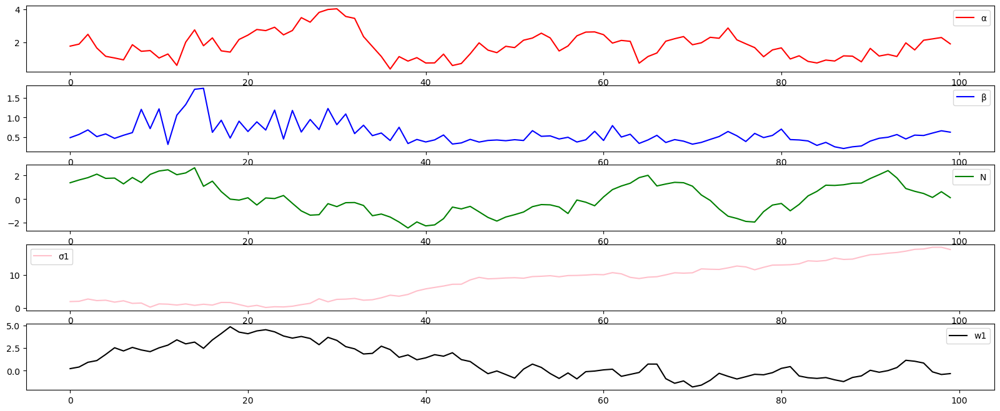

In [16]:
#traceq=tr.load("Krbf+log(z=12a).pt")
plotrace(traceq[0:1000].cpu(),0,kernel='splitrbf')

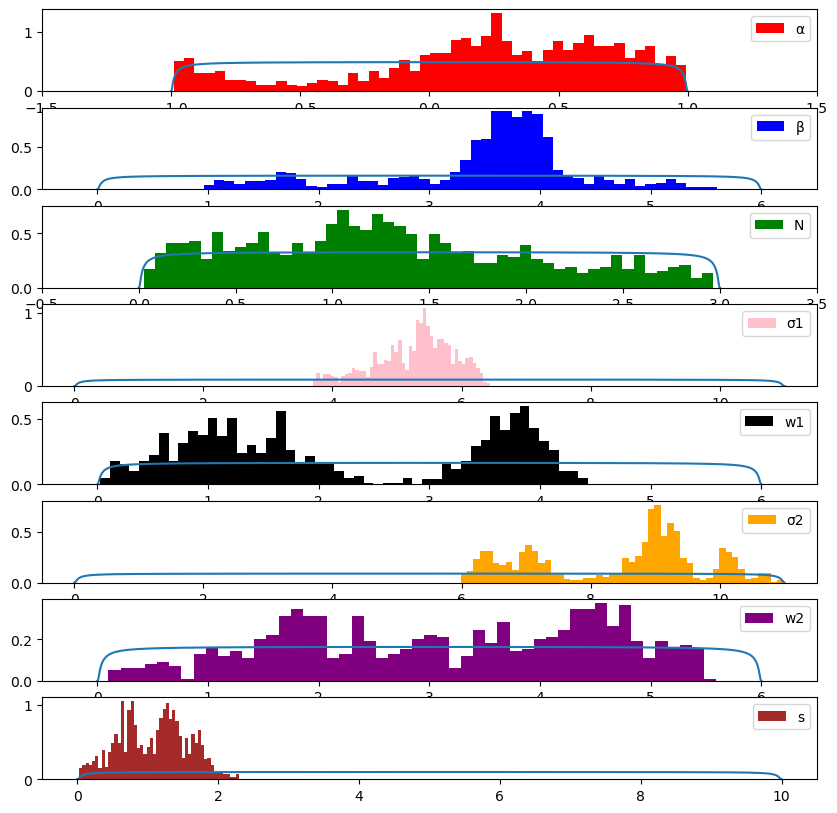

In [18]:
plothist(traceq[0:10000],fits_comb[i],50,prior=True,burn=0,kernel='combinedRBF')

# Load previous data saved

In [23]:
import os
import torch

# Specify the directory containing the tensors
tensor_dir = "./ModelC_rbf_logrbf"

# Define the filename pattern
file_pattern = "KRe(z=7a)"

# List all files in the directory
tensor_files = [f for f in os.listdir(tensor_dir) if f.startswith(file_pattern) and f.endswith(".pt")]

# Load all tensors
traces = []
for file in tensor_files:
    file_path = os.path.join(tensor_dir, file)
    print(f"Loading tensor from: {file_path}")
    tensor = torch.load(file_path)
    traces.append(tensor)

Loading tensor from: ./ModelC_rbf_logrbf/KRe(z=7a)19.pt
Loading tensor from: ./ModelC_rbf_logrbf/KRe(z=7a)45.pt
Loading tensor from: ./ModelC_rbf_logrbf/KRe(z=7a)6.pt
Loading tensor from: ./ModelC_rbf_logrbf/KRe(z=7a)32.pt


/local/scr/yacahuanamedra/TMPDIR/ipykernel_1290107/349225975.py:18: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  tensor = torch.load(file_path)


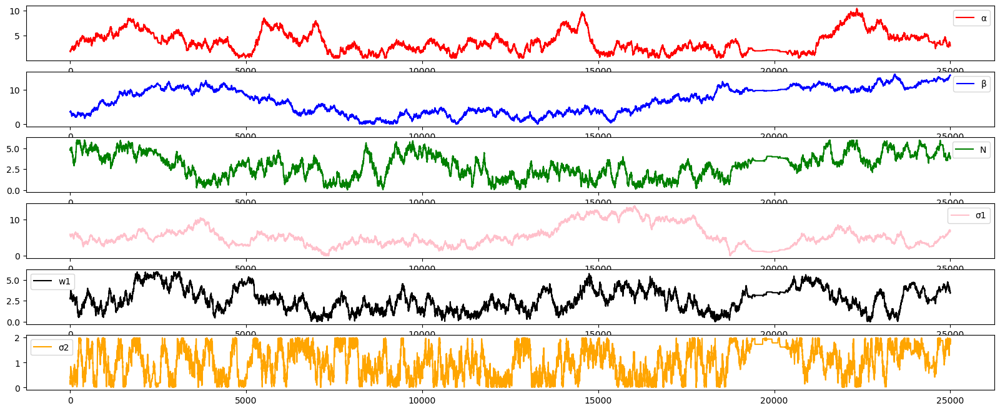

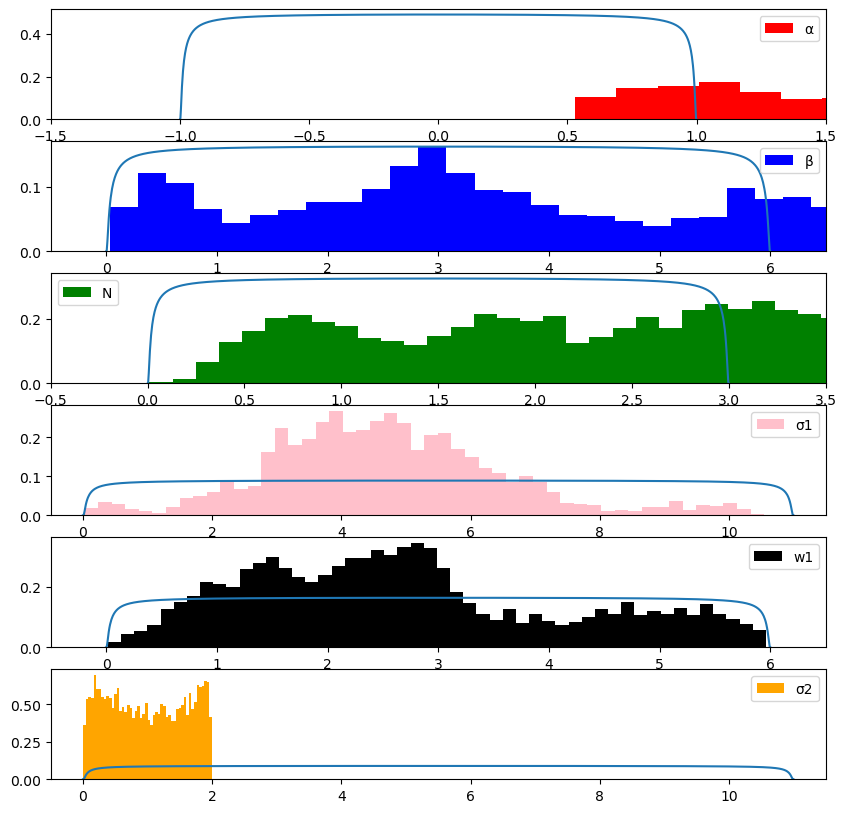

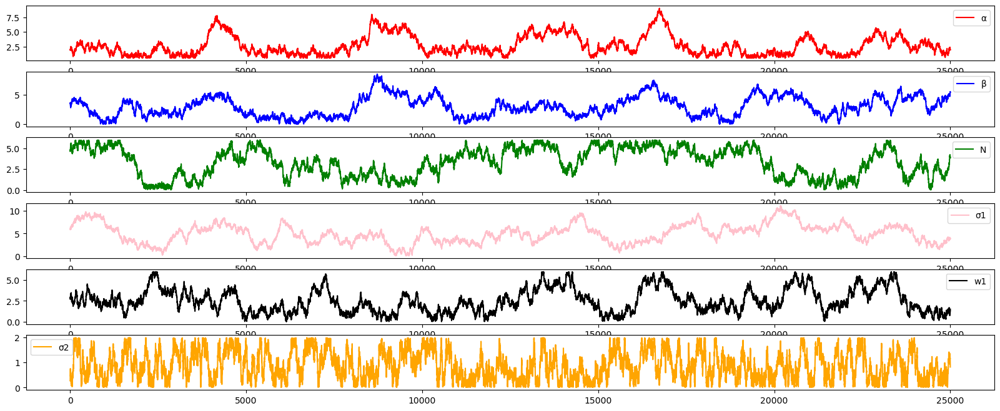

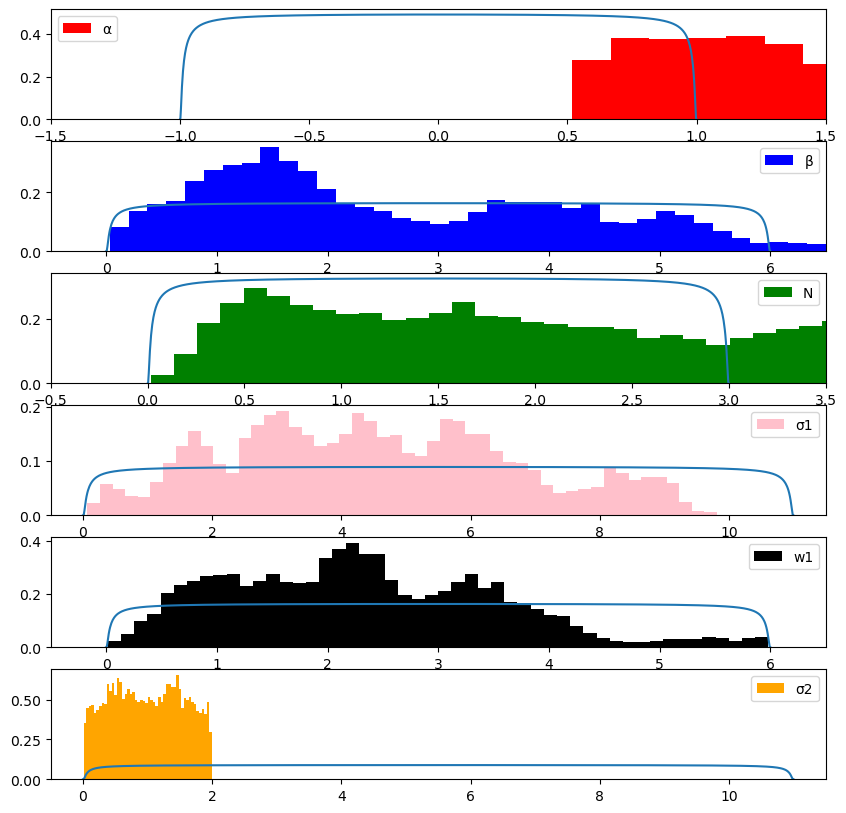

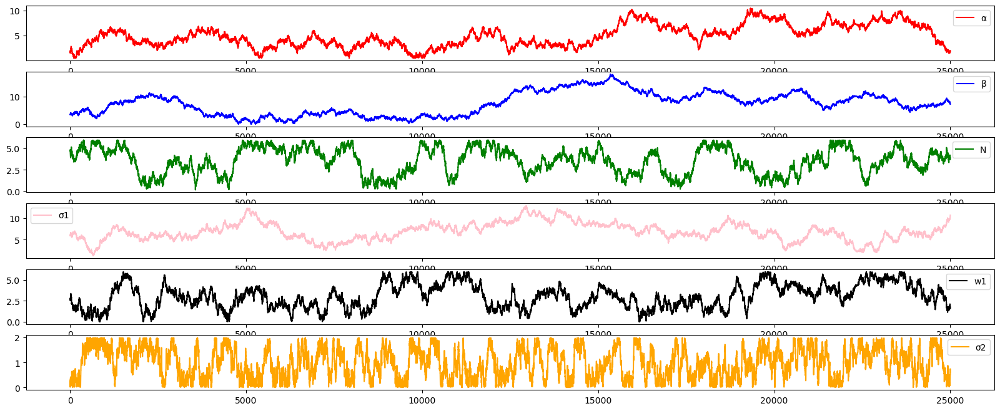

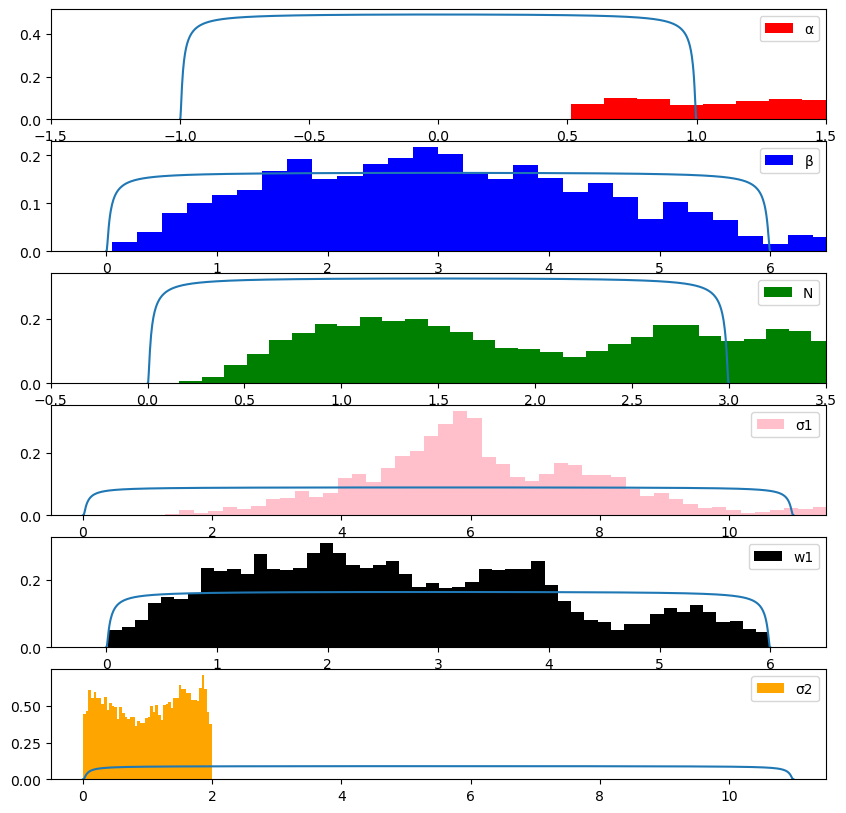

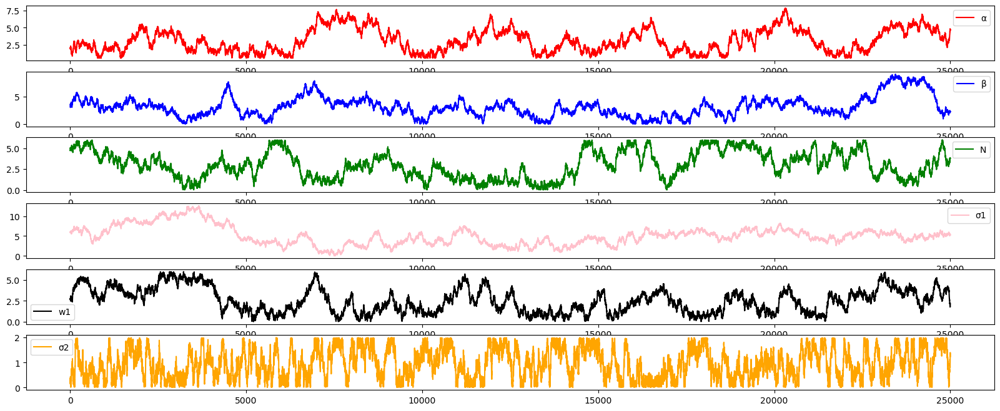

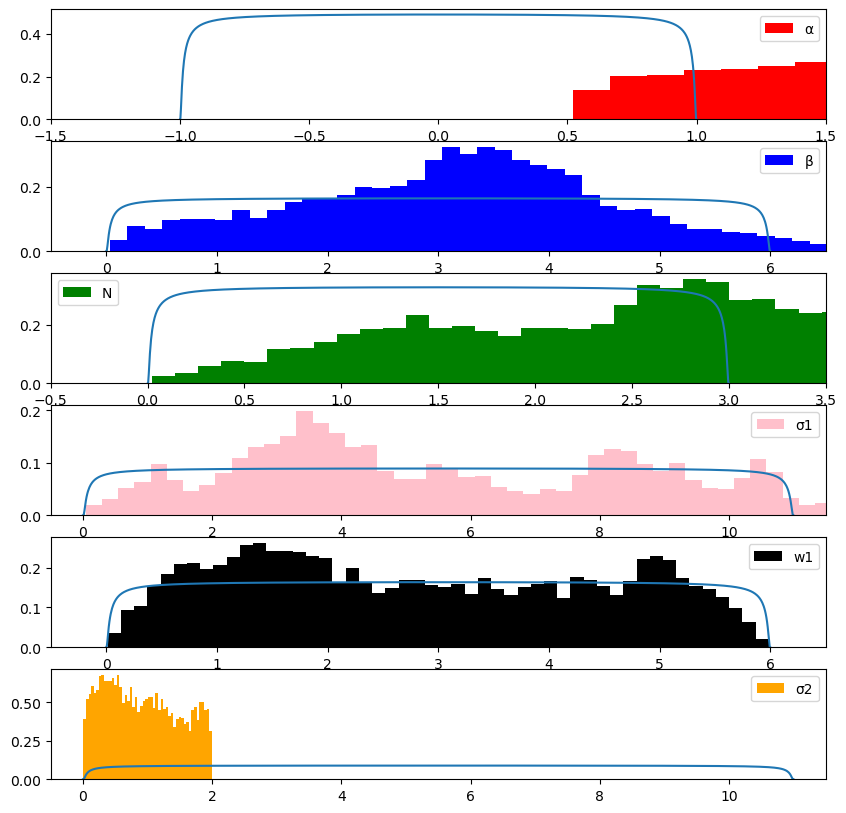

In [24]:
for i in range(0,4):
    plotrace(traces[i][0:100000].cpu(),0,kernel='combinedRBF')
    plothist(traces[i][0:100000].cpu(),fits_comb[i],50,prior=True,burn=0,kernel='combinedRBF')

# Stack different chains to 1 (do not run more than once per directory)


In [40]:
# directory containing the tensor files
folder_path = "/sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)"

# extract the values of z and family (KRe or KIm) from the filename
def extract_z_value_and_family(filename):
    """
    Extract the values of z and family (KRe or KIm) from the filename.
    """
    match = re.search(r'(KRe|KIm)\(z=(\d+a|NNPDF\(\d+\))', filename)
    if match:
        family = match.group(1)  # 'KRe' o 'KIm'
        z_value = match.group(2)  # '11a', 'NNPDF(4)', etc.
        return family, z_value
    return None, None

# List all files in the directory with the '.pt' extension
tensor_files = [f for f in os.listdir(folder_path) if f.endswith('.pt')]

# Group the files by family and z value
grouped_files = {}
for file in tensor_files:
    family, z_value = extract_z_value_and_family(file)
    if family and z_value:
        grouped_files.setdefault((family, z_value), []).append(os.path.join(folder_path, file))

# Combinar los archivos en cada grupo y eliminar los originales
for (family, z_value), files in grouped_files.items():
    files.sort()  # Asegurarse de procesar los archivos en orden
    print(f"Procesando {family}(z={z_value}) con {len(files)} archivos.")
    
    try:
        # Cargar y combinar tensores
        tensors = [tr.load(file) for file in files]
        combined_tensor = tr.cat(tensors, dim=0)  # Ajustar el dim=0 si es necesario

        # Guardar el tensor combinado
        combined_file_name = os.path.join(folder_path, f"{family}(z={z_value}).pt")
        tr.save(combined_tensor, combined_file_name)
        print(f"Guardado tensor combinado para {family}(z={z_value}) en {combined_file_name}")

        # Eliminar los archivos originales
        for file in files:
            os.remove(file)
            print(f"Eliminado archivo: {file}")

    except Exception as e:
        print(f"Error procesando archivos para {family}(z={z_value}): {e}")

Procesando KIm(z=6a) con 1 archivos.
Guardado tensor combinado para KIm(z=6a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=6a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=6a).pt
Procesando KIm(z=NNPDF(4)) con 1 archivos.
Guardado tensor combinado para KIm(z=NNPDF(4)) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=NNPDF(4)).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=NNPDF(4)).pt
Procesando KIm(z=2a) con 1 archivos.
Guardado tensor combinado para KIm(z=2a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=2a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=2a).pt
Procesando KRe(z=8a) con 1 archivos.
Guardado tensor combinado para KRe(z=8a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=8a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=8a).pt
Procesando KRe(z=4a) con 1 archi

/local/scr/yacahuanamedra/TMPDIR/ipykernel_317754/2953108280.py:33: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  tensors = [tr.load(file) for file in files]


Guardado tensor combinado para KIm(z=10a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=10a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=10a).pt
Procesando KRe(z=5a) con 1 archivos.
Guardado tensor combinado para KRe(z=5a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=5a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=5a).pt
Procesando KRe(z=NNPDF(25)) con 1 archivos.
Guardado tensor combinado para KRe(z=NNPDF(25)) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=NNPDF(25)).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KRe(z=NNPDF(25)).pt
Procesando KIm(z=11a) con 1 archivos.
Guardado tensor combinado para KIm(z=11a) en /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=11a).pt
Eliminado archivo: /sciclone/pscr/yacahuanamedra/PDF_rbf_deb(all+log_lin)/KIm(z=11a).pt
Procesando KRe(z=1a) con 1 archivos.
Guardado tensor combi

In [10]:
# Initialize the list to store the loaded tensors
traces = []

# Base path where the combined tensors are located
base_path = f"/sciclone/pscr/yacahuanamedra/PDF_Krbflog({mode}+{grid2})"#/old_data"

# Load the combined tensors Re_combined_0.pt, Re_combined_1.pt, ..., Re_combined_12.pt
for i in range(number):  # Iterates from 0 to 12
    file_path = f"{base_path}/K"+ITD+"("+fits_comb[i].name+").pt"
    try:
        trace = tr.load(file_path)  # Load the tensor
        traces.append(trace)       # Append it to the list
        print(f"Traces loaded from: {file_path} - Shape: {trace.shape}")
    except FileNotFoundError:
        print(f"File not found: {file_path}")
    except Exception as e:
        print(f"Error loading {file_path}: {e}")

# Optional: Combine all traces into a single tensor
if traces:
    all_traces = tr.cat(traces, dim=0)  # Adjust dim as needed
    print(f"Combined tensor size: {all_traces.shape}")
else:
    print("No traces were loaded.")

/local/scr/yacahuanamedra/TMPDIR/ipykernel_199135/520987026.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  trace = tr.load(file_path)  # Load the tensor


Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=1a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=2a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=3a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=4a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=5a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=6a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=7a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/pscr/yacahuanamedra/PDF_Krbflog(mean+log_lin)/KRe(z=8a).pt - Shape: torch.Size([50000, 3])
Traces loaded from: /sciclone/ps

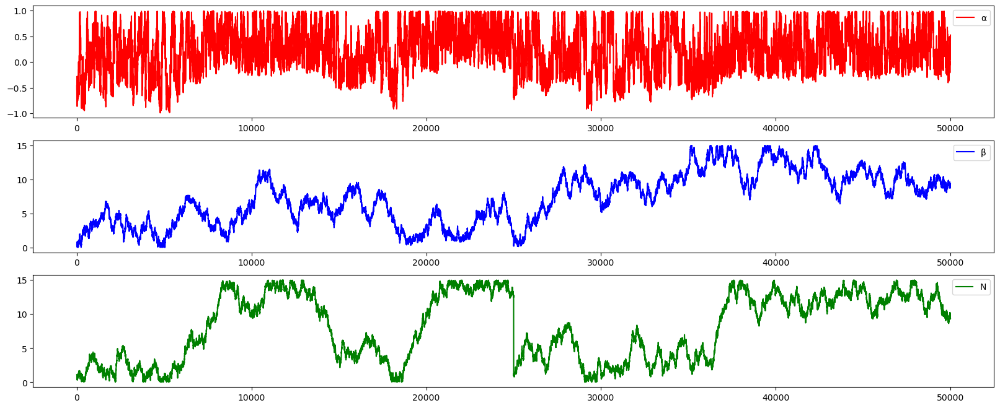

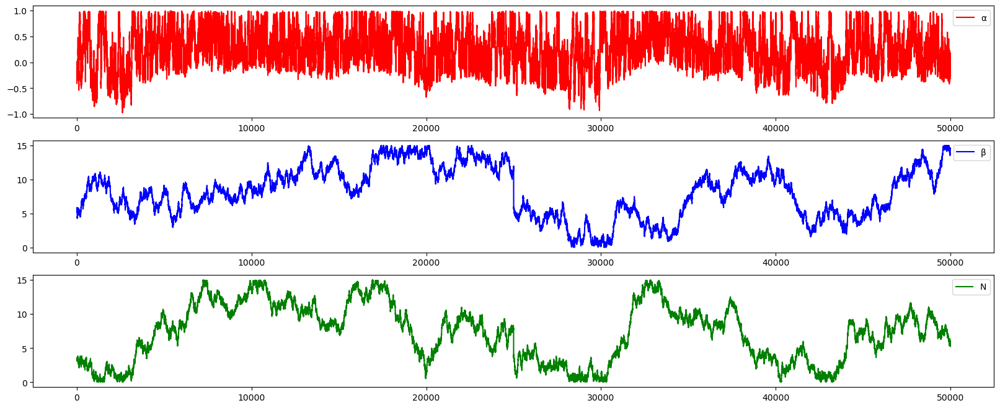

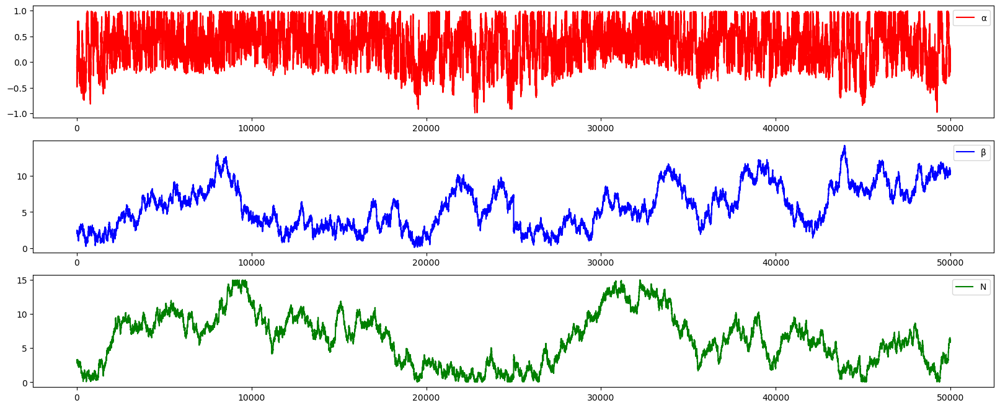

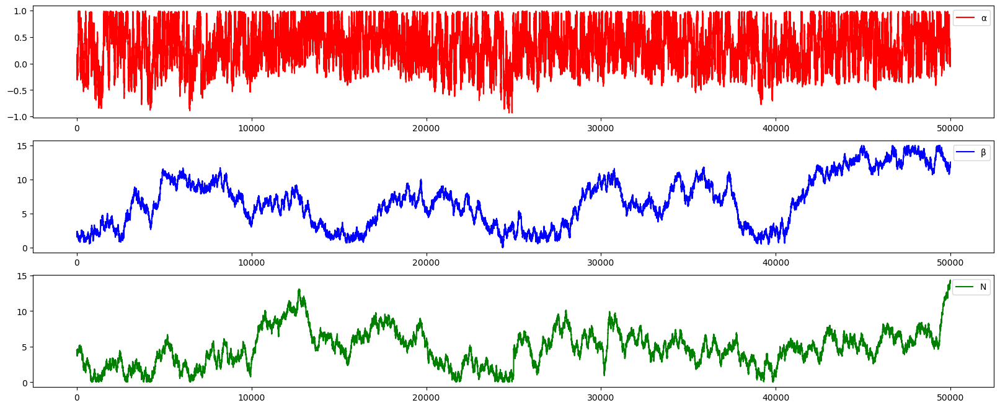

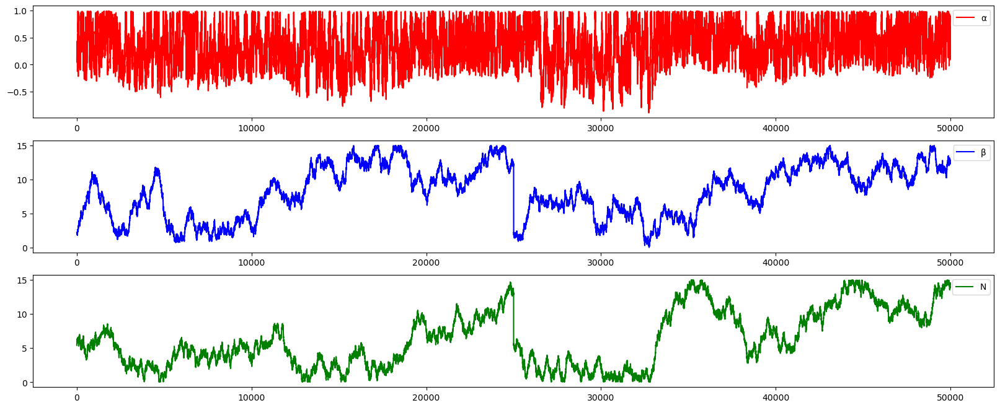

...

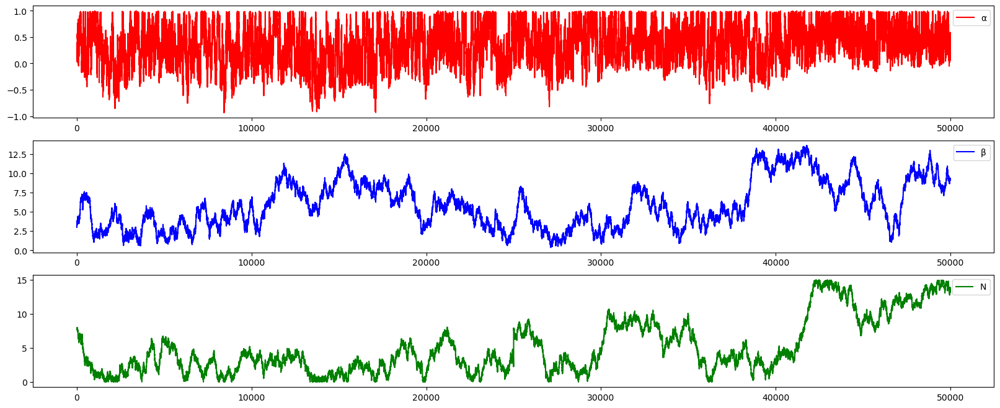

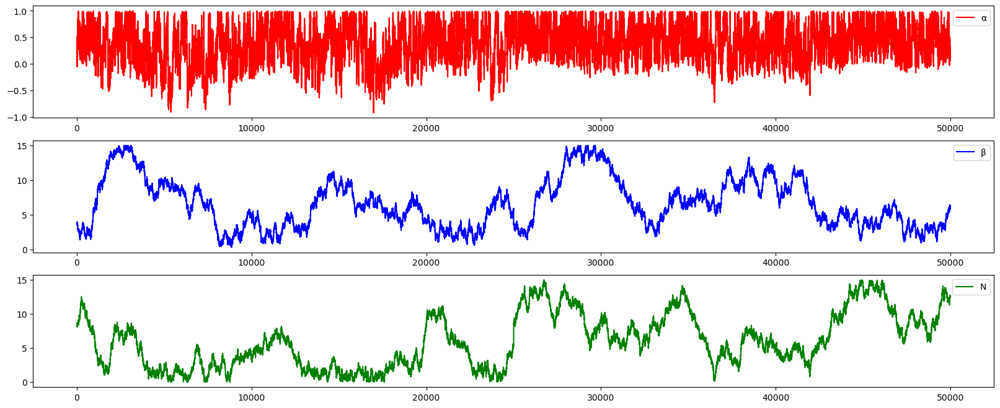

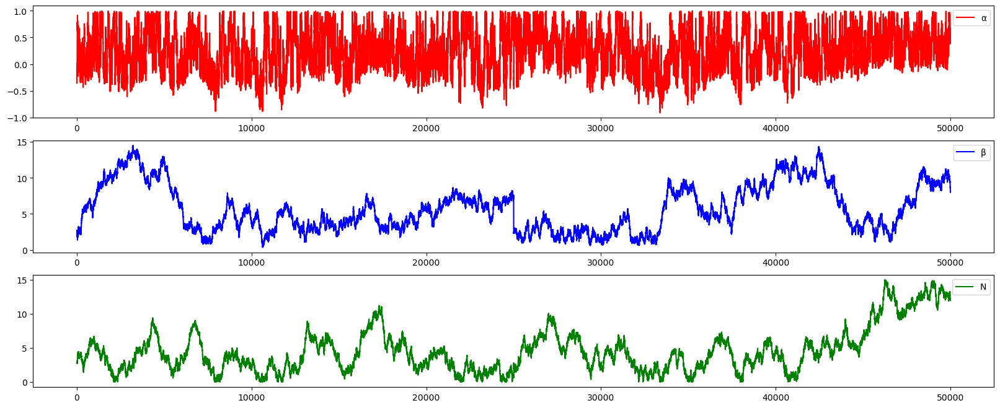

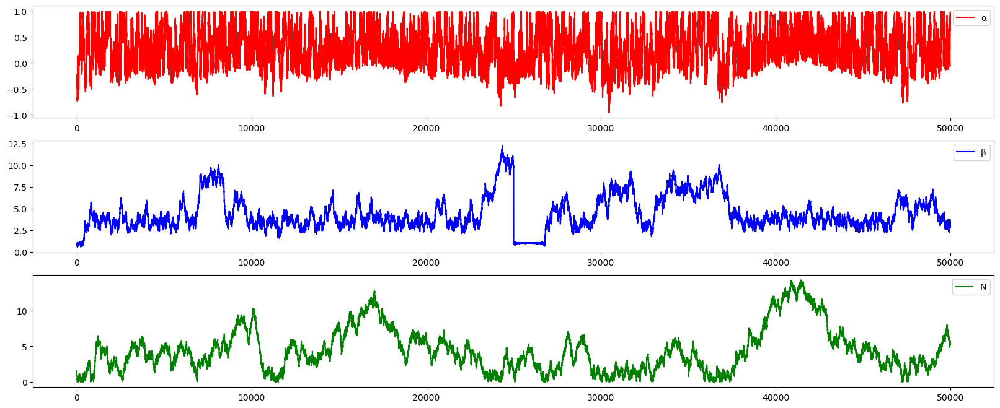

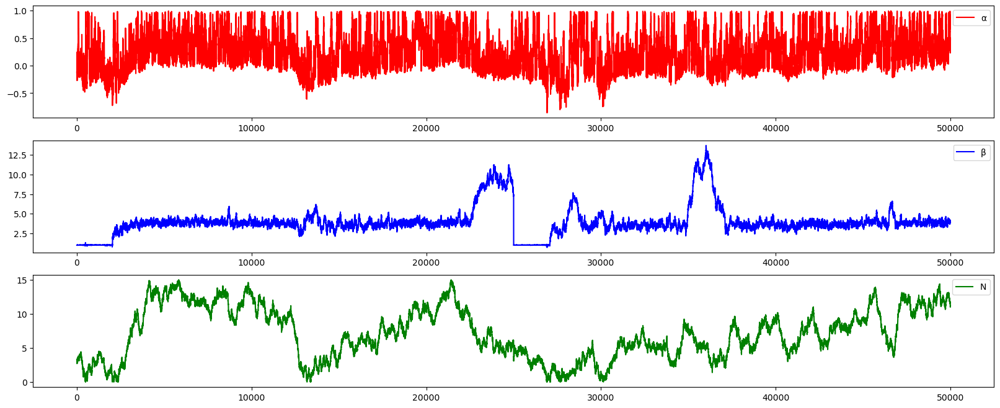

In [12]:
for i in range(0,number):
    plotrace(traces[i][0:200000].cpu(),0,kernel='combinedRBF')
    #plothist(traces[i][0:200000].cpu(),fits_comb[i],100,prior=True,burn=100,kernel='combinedRBF')

In [13]:
#If there is no filtering process
filtered_traces = traces

In [18]:
def filter_constant_sections(tensor, threshold=0.00000001):
    """
    Filtra las secciones constantes de una cadena en el tensor eliminando tramos planos.

    Args:
        tensor (torch.Tensor): Tensor con una cadena (1D o varias columnas).
        threshold (float): Diferencia mínima para considerar un cambio significativo.

    Returns:
        torch.Tensor: Tensor filtrado con solo las fluctuaciones.
    """
    # Calcular diferencias entre elementos consecutivos para cada columna
    diffs = tr.abs(tensor[1:] - tensor[:-1])
    
    # Identificar los índices donde ocurre un cambio significativo
    significant_changes = tr.any(diffs > threshold, dim=1)
    
    # Añadir el primer valor para mantener el inicio de la cadena
    significant_changes = tr.cat([tr.tensor([True]), significant_changes])
    
    # Filtrar el tensor para conservar solo las fluctuaciones
    filtered_tensor = tensor[significant_changes]
    
    return filtered_tensor


# Filtrar las constantes en cada tensor de la lista
filtered_traces = [filter_constant_sections(tensor) for tensor in traces]

# Imprimir el tamaño original y el filtrado para cada tensor
for i, (original, filtered) in enumerate(zip(traces, filtered_traces)):
    print(f"Tensor {i}: Original size {original.size()}, Filtered size {filtered.size()}")

Tensor 0: Original size torch.Size([150000, 6]), Filtered size torch.Size([149073, 6])
Tensor 1: Original size torch.Size([150000, 6]), Filtered size torch.Size([149870, 6])
Tensor 2: Original size torch.Size([150000, 6]), Filtered size torch.Size([119911, 6])
Tensor 3: Original size torch.Size([150000, 6]), Filtered size torch.Size([149936, 6])
Tensor 4: Original size torch.Size([150000, 6]), Filtered size torch.Size([149979, 6])
Tensor 5: Original size torch.Size([150000, 6]), Filtered size torch.Size([149973, 6])
Tensor 6: Original size torch.Size([150000, 6]), Filtered size torch.Size([149993, 6])
Tensor 7: Original size torch.Size([150000, 6]), Filtered size torch.Size([149995, 6])
Tensor 8: Original size torch.Size([150000, 6]), Filtered size torch.Size([149707, 6])
Tensor 9: Original size torch.Size([150000, 6]), Filtered size torch.Size([149893, 6])
Tensor 10: Original size torch.Size([150000, 6]), Filtered size torch.Size([149971, 6])
Tensor 11: Original size torch.Size([15000

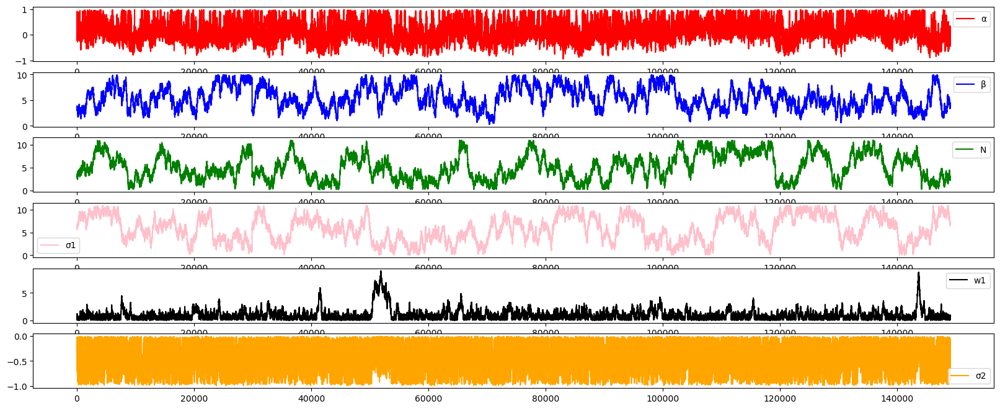

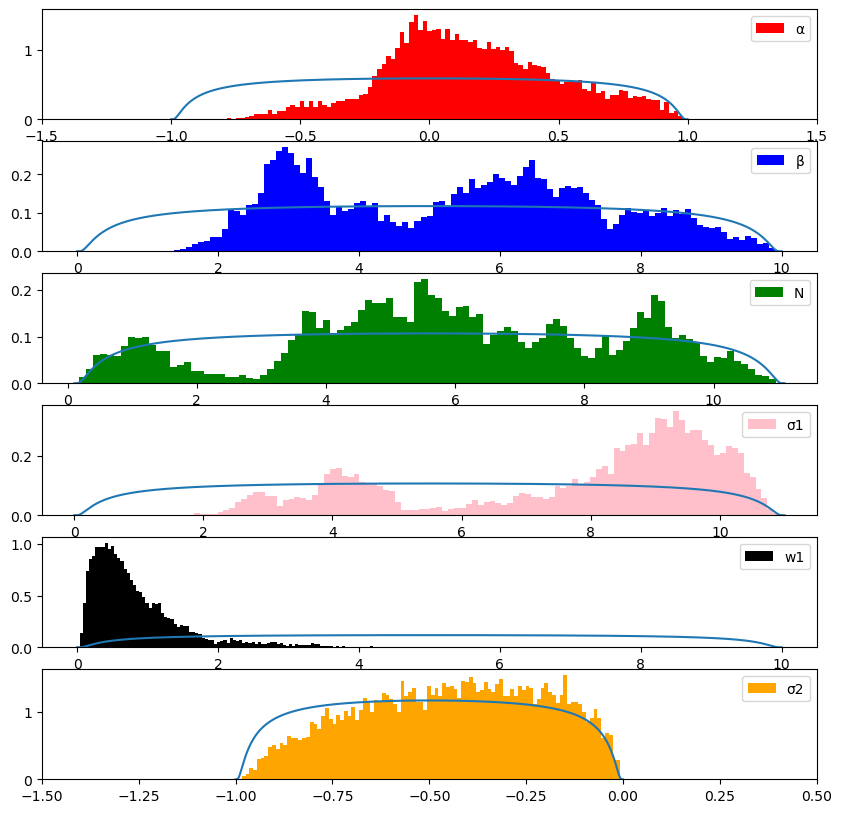

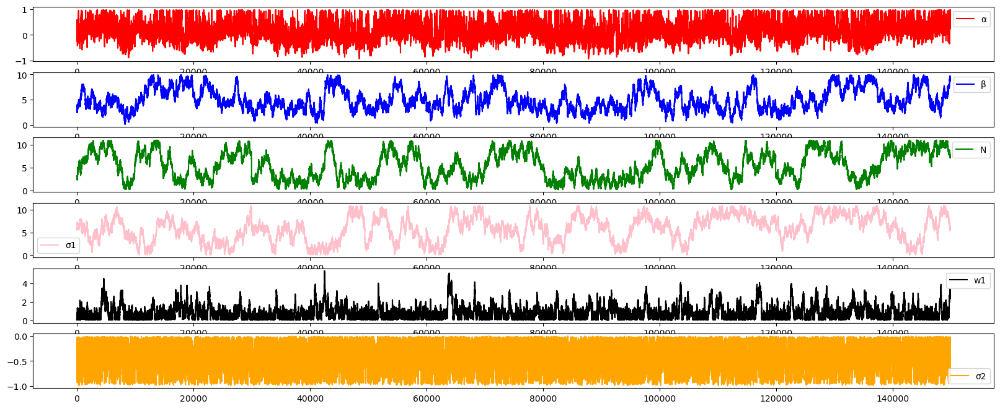

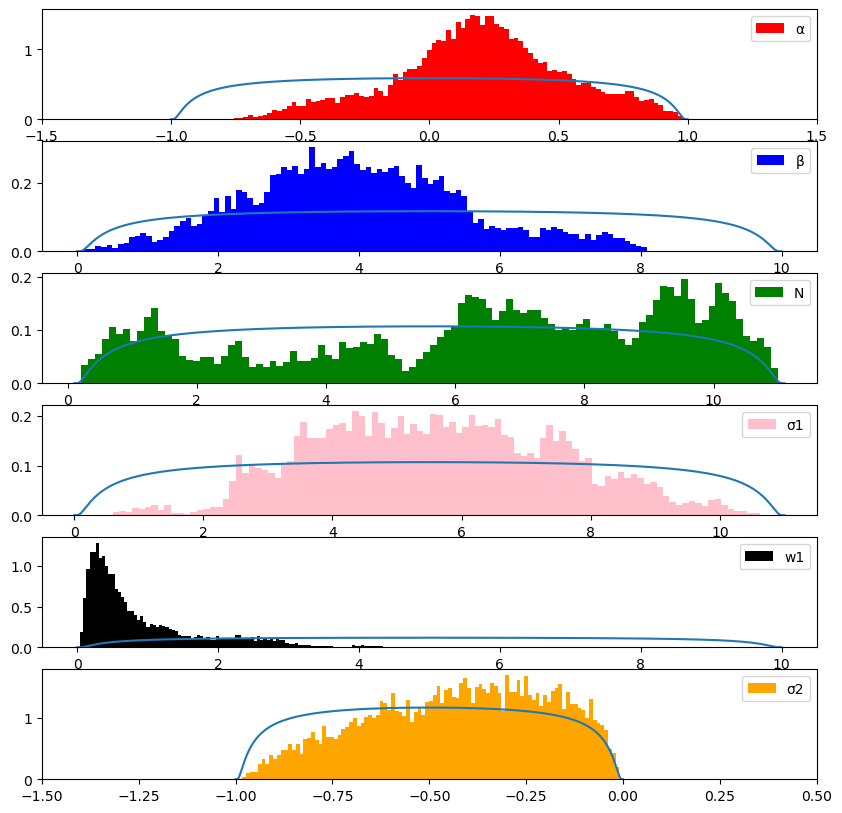

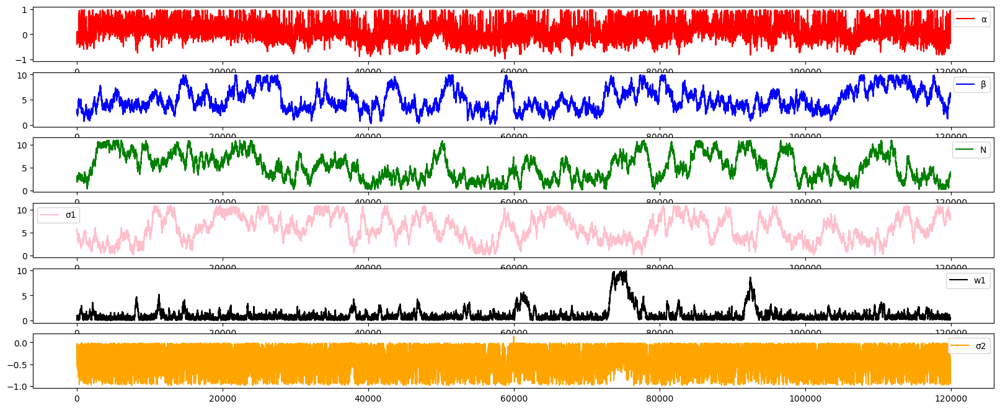

...

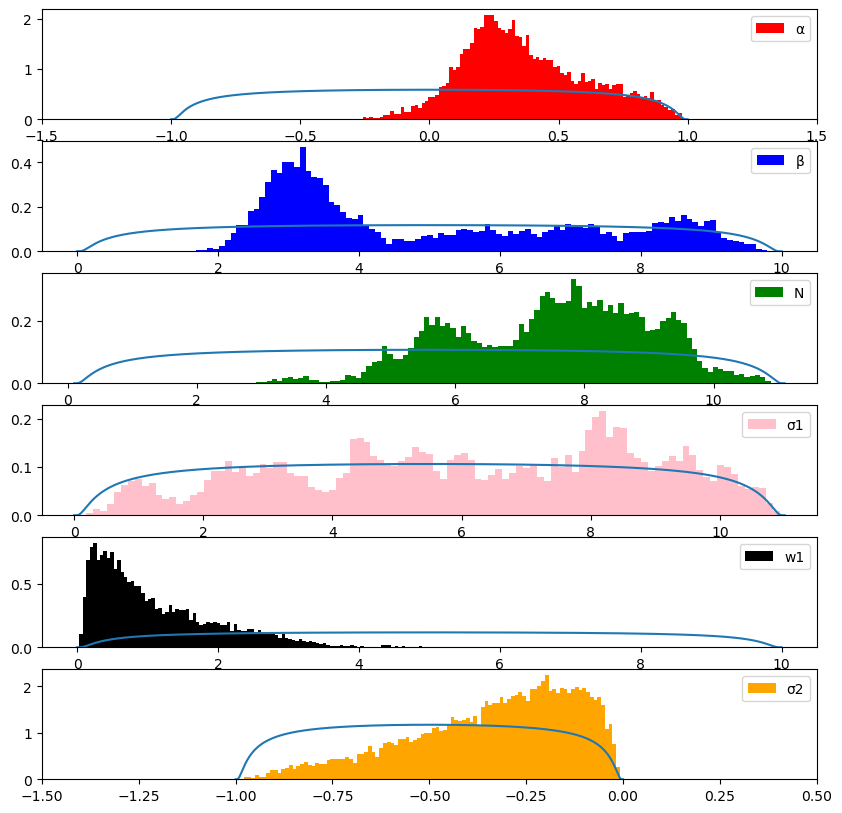

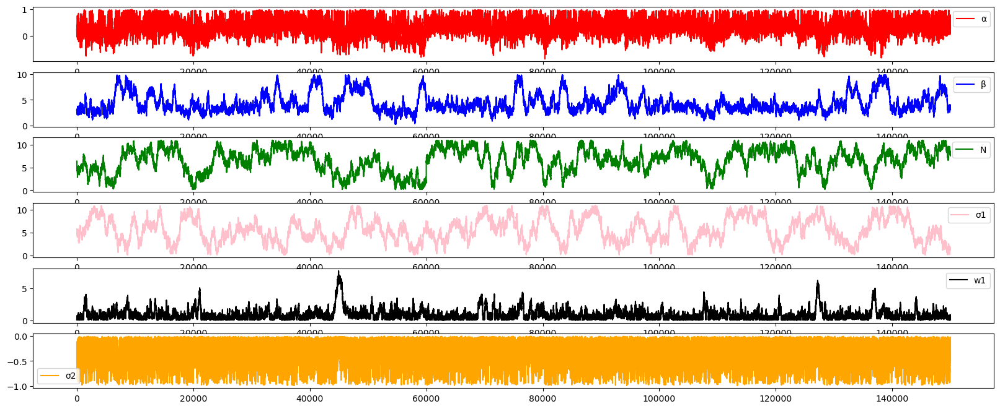

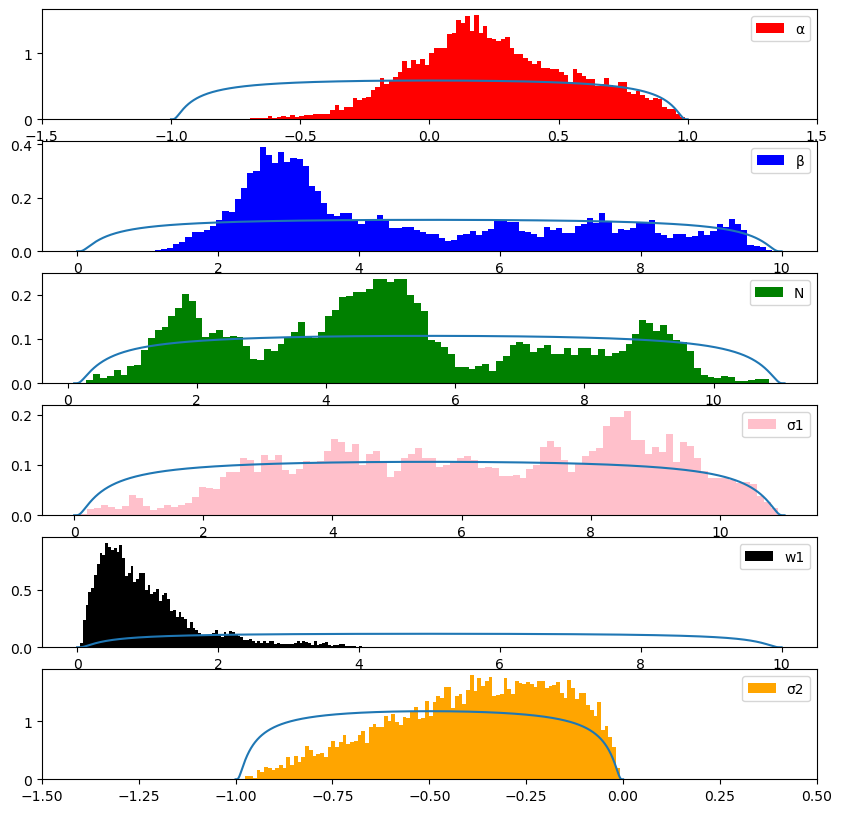

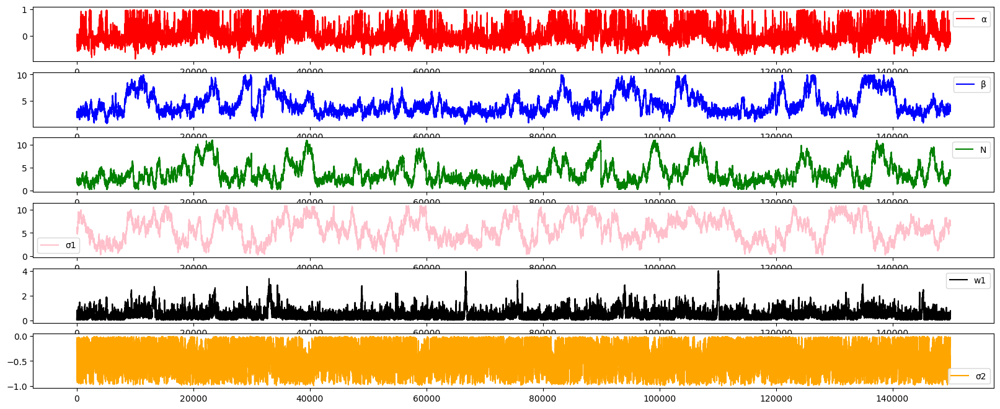

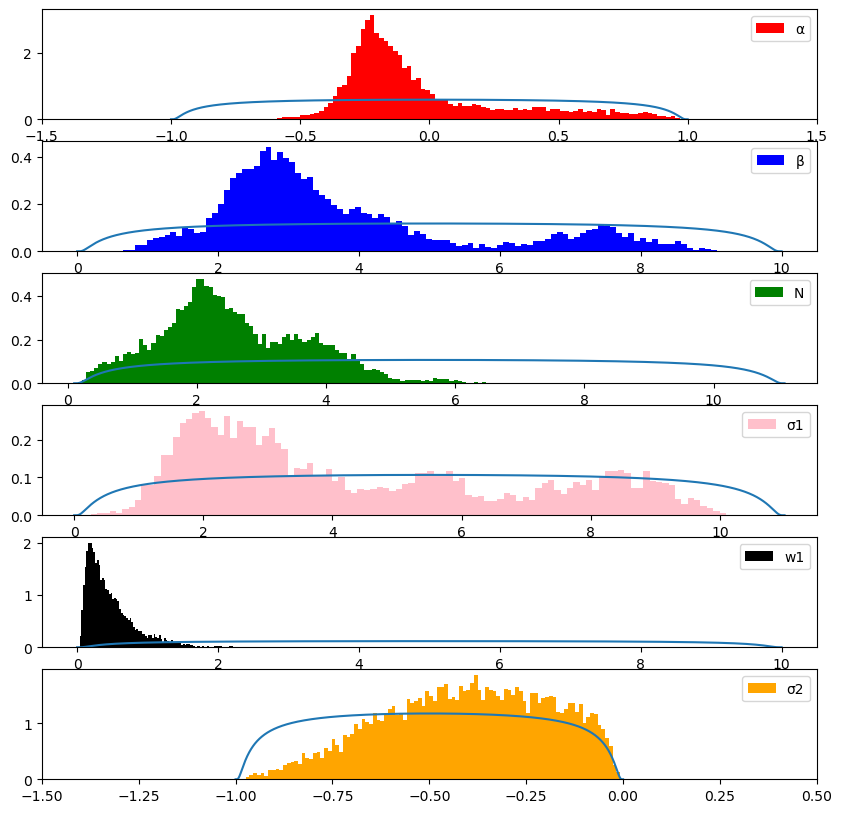

In [19]:
for i in range(0,number):
    plotrace(filtered_traces[i][0:200000].cpu(),0,kernel='combinedRBF')
    plothist(filtered_traces[i][0:200000].cpu(),fits_comb[i],100,prior=True,burn=100,kernel='combinedRBF')

# Uncertainty analysis

In this case the evidence definition includes a factor 1/2
\begin{equation}
    \langle q(x)\rangle= \frac{\sum_i e^{-E(\theta_i)}\bar{q}(x,\theta_i)}{\sum_i e^{-E(\theta_i)}}
\end{equation}
And the covariance matrix can be 
\begin{equation}
    \langle (q(x)-\langle q(x)\rangle)(q(x')-\langle q(x')\rangle)\rangle= \frac{\sum_i e^{-E(\theta_i)}[H^{-1}(\theta)+(\bar{q}(x,\theta)-\langle q(x)\rangle)(\bar{q}(x',\theta)-\langle q(x')\rangle)]}{\sum_i e^{-E(\theta_i)}}
\end{equation}
I add the denominator factor. I follow a similar procedure for the case of the Ioffe time distributions, with the same evidence factor.

In [8]:
samplesqx=[]
samplesQv=[]
qofxs=[]
Qofvs=[]
covs=[]
covsnu=[]
nnn=2000
#remember that for Im(M) the range goes to 12 because there is no mock data set
for i in range(0,number):
    qofx,cov,pms,Qofv,covnu,Qvs=fits_comb[i].model_averaging(filtered_traces[i][::filtered_traces[i].shape[0]//nnn])
    pms=tr.stack(pms)
    Qvs=tr.stack(Qvs)
    samplesqx.append(pms)
    samplesQv.append(Qvs)
    qofxs.append(qofx)
    Qofvs.append(Qofv)
    covs.append(cov)
    covsnu.append(covnu)
    print("Model Averaging (2nd level)",fits_comb[i].name,"done")

Model Averaging (2nd level) z=1a done
Model Averaging (2nd level) z=2a done
Model Averaging (2nd level) z=3a done
Model Averaging (2nd level) z=4a done
Model Averaging (2nd level) z=5a done
Model Averaging (2nd level) z=6a done
Model Averaging (2nd level) z=7a done
Model Averaging (2nd level) z=8a done
Model Averaging (2nd level) z=9a done
Model Averaging (2nd level) z=10a done
Model Averaging (2nd level) z=11a done
Model Averaging (2nd level) z=12a done
Model Averaging (2nd level) z=NNPDF(4) done
Model Averaging (2nd level) z=NNPDF(10) done
Model Averaging (2nd level) z=NNPDF(25) done


In [9]:
#ITD="Im"
nn = np.linspace(0,26,128)
Nx=x_gri0.shape[0]
iB = np.zeros((nn.shape[0],Nx))
fe=FE2_Integrator(x_gri0)
for k in range(nn.shape[0]):
    if ITD=="Re":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    elif ITD=="Im":
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.sin(nn[k]*x))
    #iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
ITD

'Im'

In [10]:
Qnu=[]
for i in range(0,number):
    ttQ = samplesqx[i]@iB.T
    Qnu.append(ttQ)
    print("ITD",fits_comb[i].name,"done")

ITD z=1a done
ITD z=2a done
ITD z=3a done
ITD z=4a done
ITD z=5a done
ITD z=6a done
ITD z=7a done
ITD z=8a done
ITD z=9a done
ITD z=10a done
ITD z=11a done
ITD z=12a done
ITD z=NNPDF(4) done
ITD z=NNPDF(10) done
ITD z=NNPDF(25) done


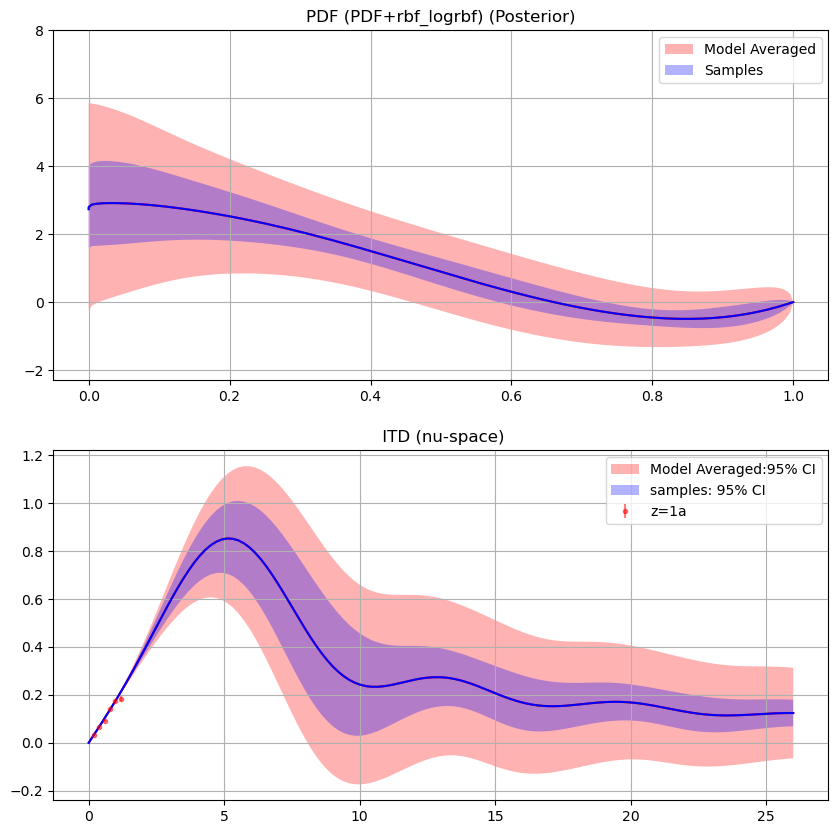

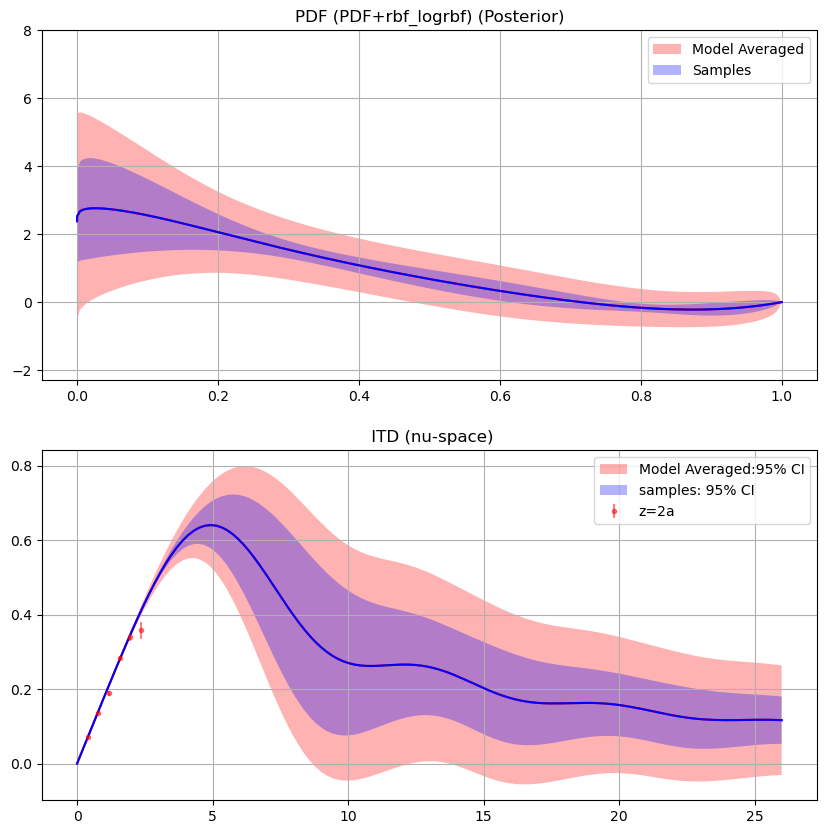

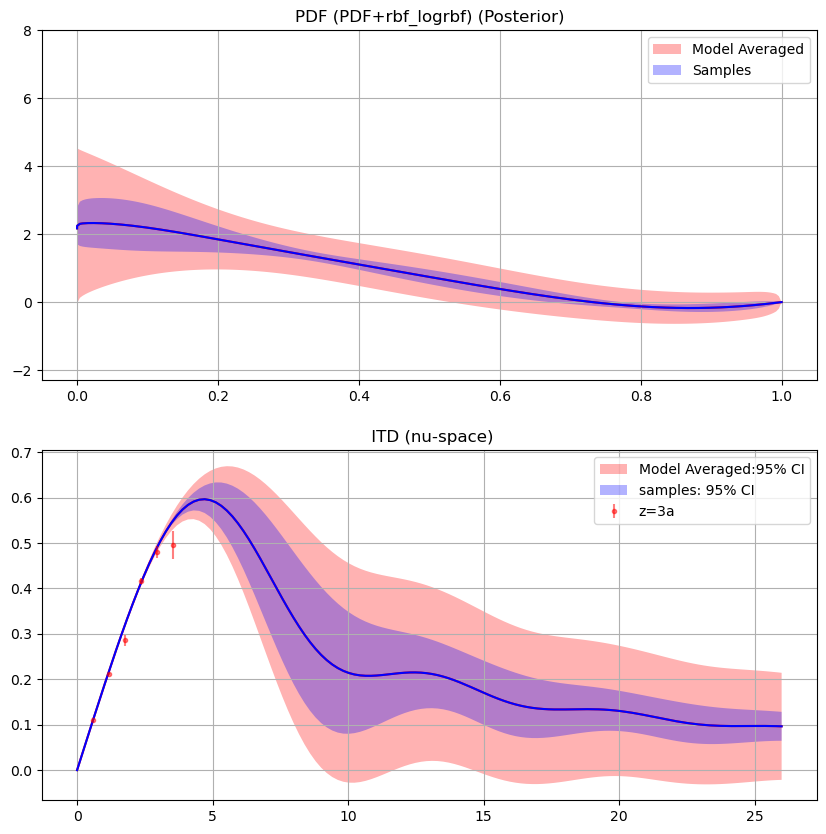

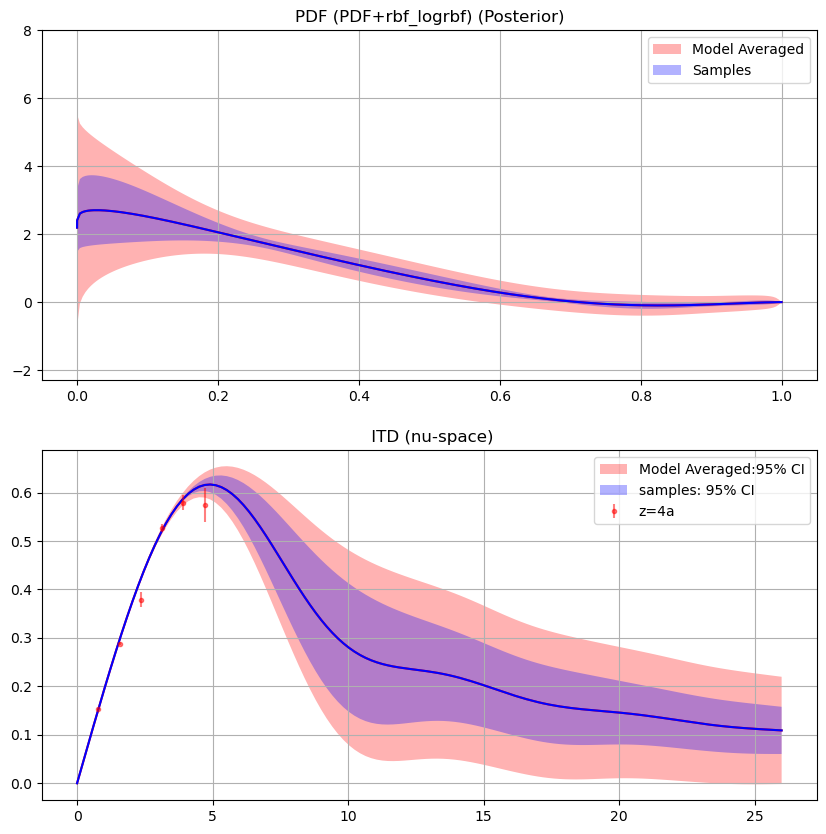

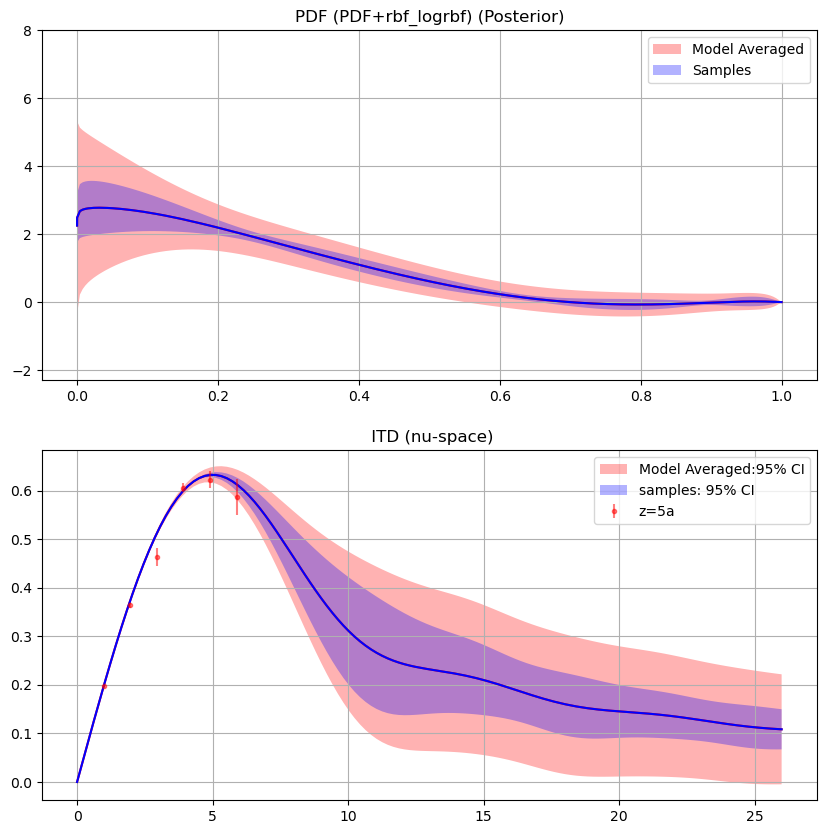

...

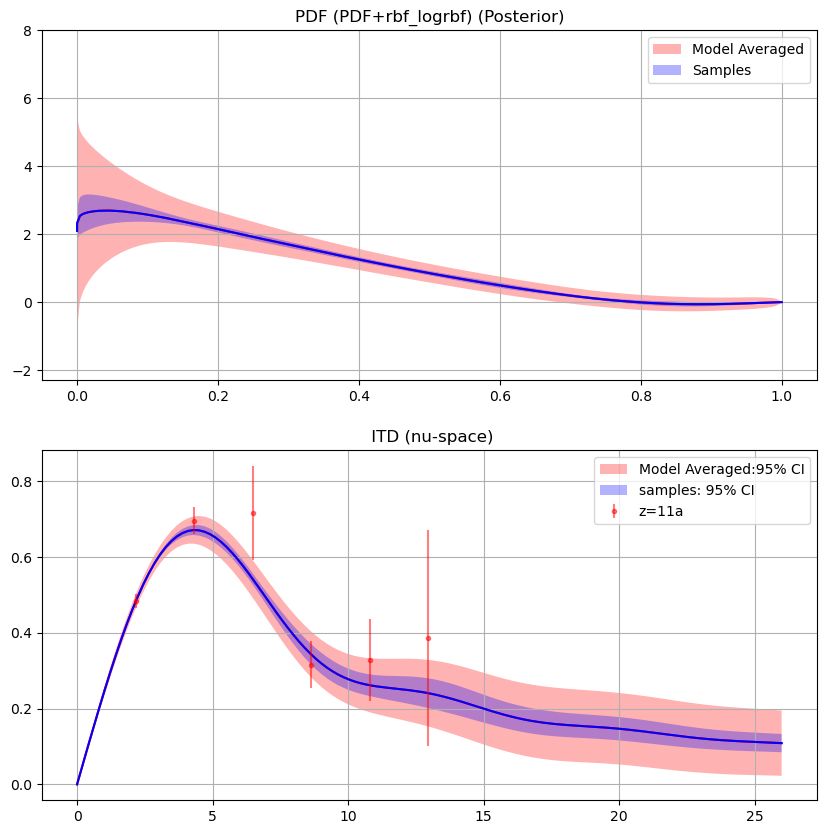

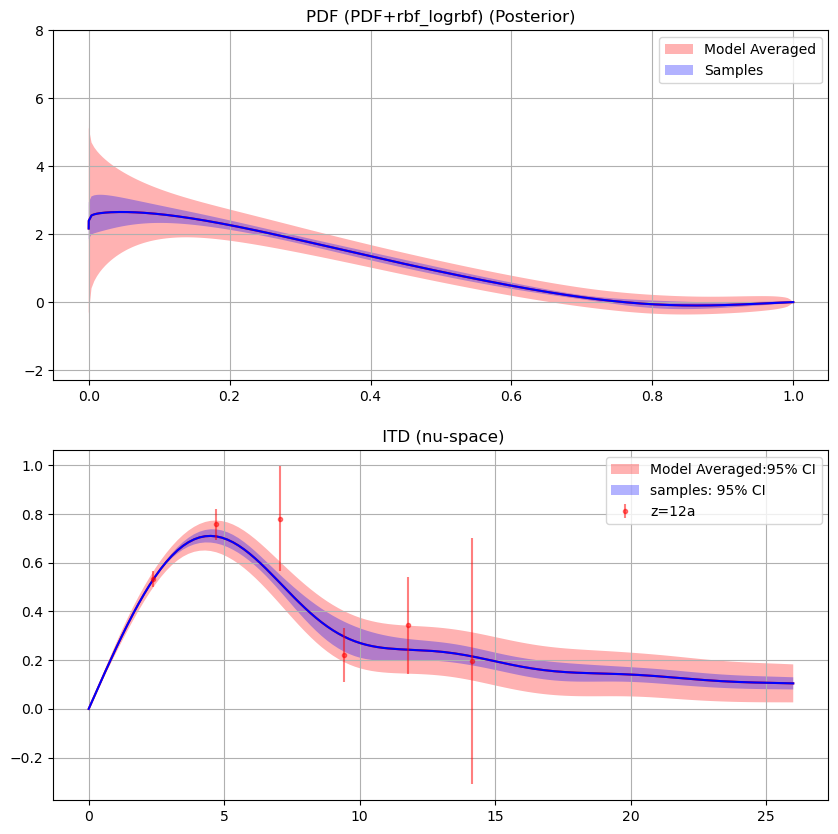

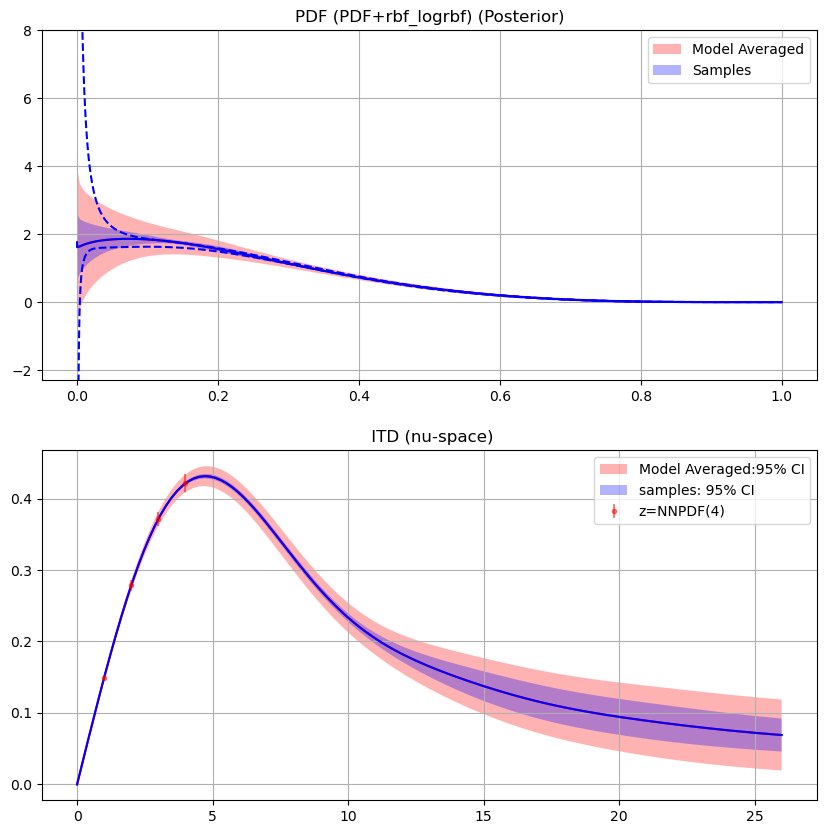

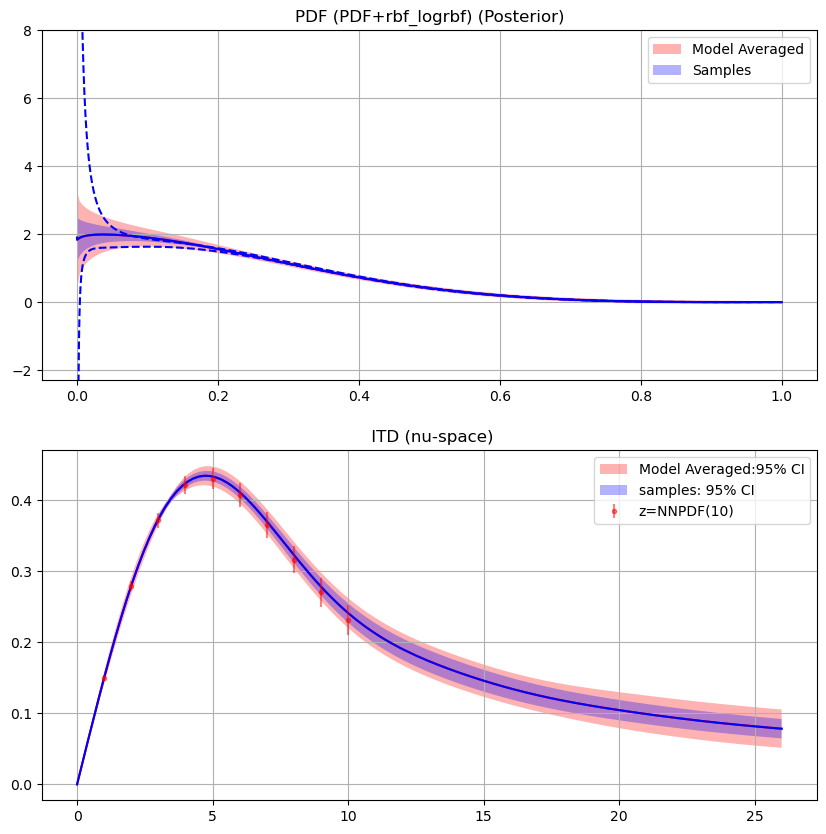

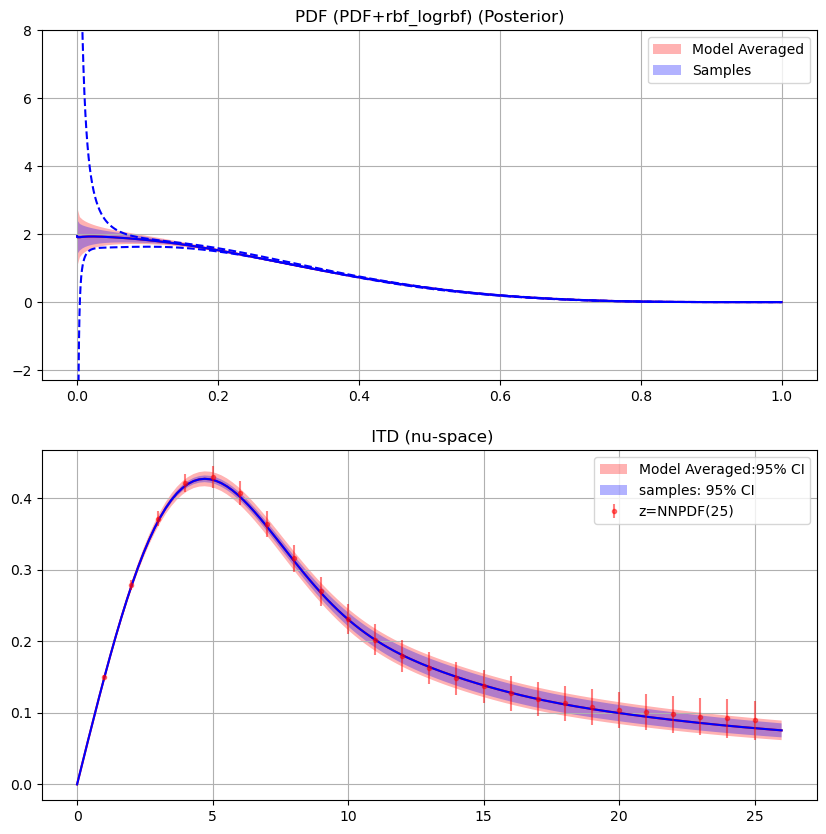

In [11]:
#plot Qnu[0]
fCI=1.0
for i in range(0,number):
    fig, ax= plt.subplots(2,figsize=(10, 10))
    ax[0].set_title(f'PDF ({modelname}+{kernelname}) (Posterior)')
    ax[1].set_title(" ITD (nu-space)")

    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
    meanx=samplesqx[i].mean(axis=0)
    qofx=qofxs[i]
    qsig=fCI*np.diag(np.cov(samplesqx[i].T))**(0.5)
    qerror=fCI*np.diag(tr.abs(covs[i]))**(0.5)

    #plot ttQ with the mean
    #mttQ = Qnu[i].mean(axis=0)
    mttQ=Qofvs[i]
    meanv=samplesQv[i].mean(axis=0)
    Qsig=fCI* np.diag(np.cov(samplesQv[i].T))**0.5
    Qerror=fCI*np.diag(tr.abs(covsnu[i]))**0.5


    ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='red', alpha=0.3,label='Model Averaged')
    ax[0].fill_between(x_gri0, meanx - qsig,  meanx+ qsig, facecolor='blue', alpha=0.3,label='Samples')
    ax[0].legend()
    ax[0].grid()

    #for j in range(len(samplesqx[i])):
    #    ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.03)
    #ax[0].plot(x_gri0,qofx,label=fits_comb[i].name,color='blue')
    ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name,color='red')
    ax[0].plot(x_gri0,meanx,color='blue')

    ax[0].set_ylim([-2.3,8])

    #ax[1].plot(nn,Qnu[i].T,color=col[i],alpha=0.05)
    #Qsig=np.diag(covQ)**(0.5)
    ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor="red", alpha=0.3,label='Model Averaged:95% CI')
    ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor="blue", alpha=0.3,label='samples: 95% CI')
    ax[1].plot(nn,mttQ,color='red')
    ax[1].plot(nn,meanv,color='blue')
    if i >=12 and test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        if i==12:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
        elif i==13:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
        elif i==14:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
        nu_d_grid = datanu.T[1]
        M=datanu.T[2:].mean(axis=0)
        eMnu=datanu.T[2:].std(axis=0)


        pdfminus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_minus.dat',dtype=np.float64)
        pdfplus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_plus.dat',dtype=np.float64)
        covmin=np.cov(pdfminus[:,1:])
        covplus=np.cov(pdfplus[:,1:])
        meanplus=pdfplus[:,1:].mean(axis=1)
        meanminus=pdfminus[:,1:].mean(axis=1)
        #plot the uncertainty
        if ITD=="Im":
            ax[0].plot(pdfplus[:,0],meanplus+np.sqrt(np.diag(covplus)),color='blue',ls='--')
            ax[0].plot(pdfplus[:,0],meanplus-np.sqrt(np.diag(covplus)),color='blue',ls='--')
        else:   
            ax[0].plot(pdfplus[:,0],meanminus+np.sqrt(np.diag(covmin)),color='red',ls='--',alpha=0.5)
            ax[0].plot(pdfplus[:,0],meanminus-np.sqrt(np.diag(covmin)),color='red',ls='--',alpha=0.5)

        
        plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    elif i<12:
        plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    plt.legend()
    plt.grid()
    plt.show()


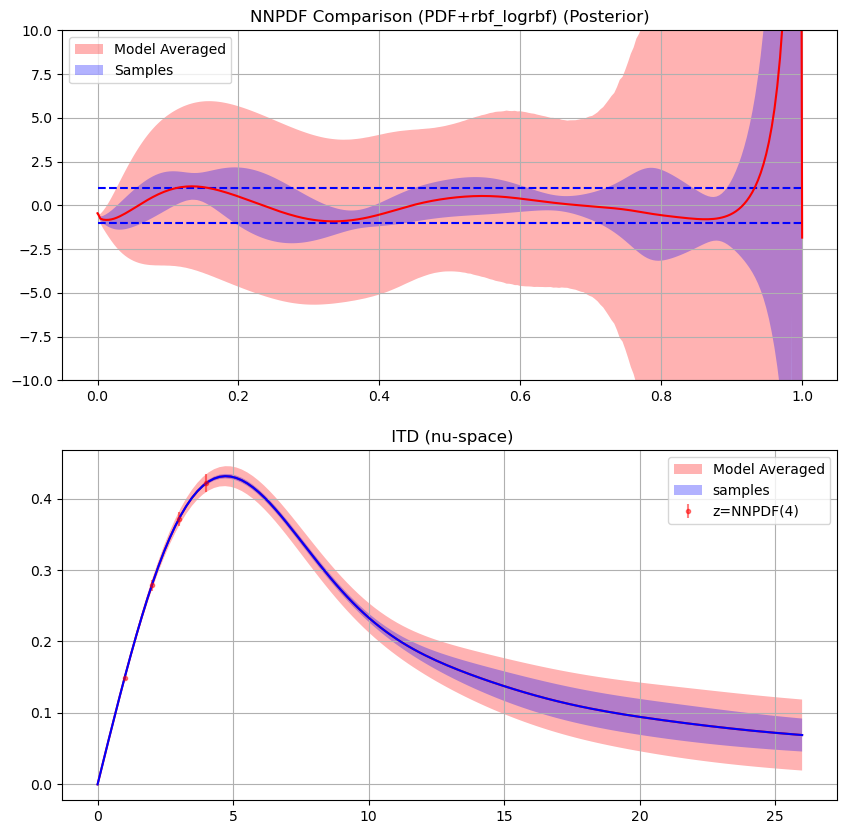

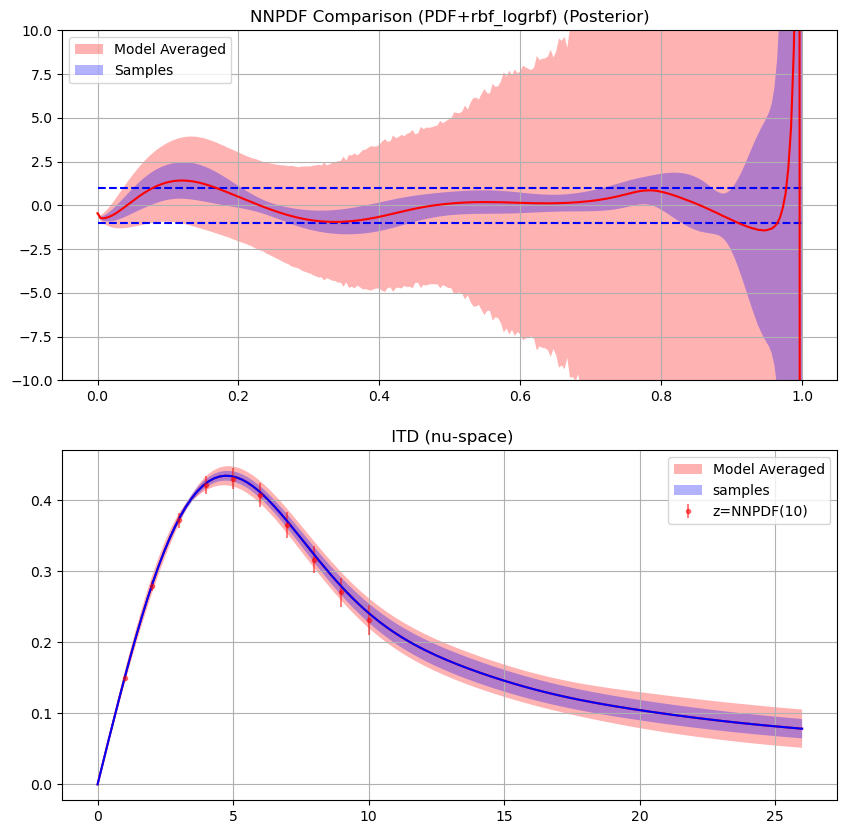

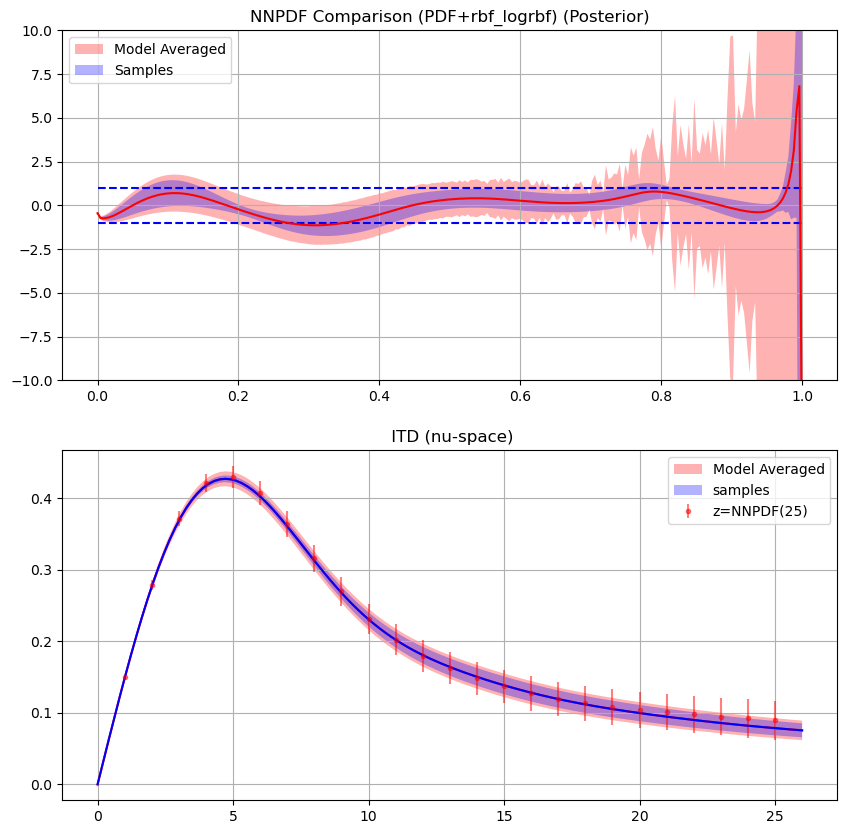

In [12]:
#plot Qnu[0]
fCI=1.00
for i in range(12,number):
    fig, ax= plt.subplots(2,figsize=(10, 10))
    ax[0].set_title(f'NNPDF Comparison ({modelname}+{kernelname}) (Posterior)')
    ax[1].set_title(" ITD (nu-space)")

    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
    meanx=samplesqx[i].mean(axis=0)
    qofx=qofxs[i]
    qsig=fCI*np.diag(np.cov(samplesqx[i].T))**(0.5)
    qerror=fCI*np.diag(np.abs((covs[i]+covs[i].T)/2.0 + 1e-13*np.eye(covs[i].shape[0]))**(0.5))

    mttQ=Qofvs[i]
    meanv=samplesQv[i].mean(axis=0)
    Qsig=fCI* np.diag(np.cov(samplesQv[i].T))**0.5
    Qerror=fCI*np.diag(np.abs(covsnu[i]))**0.5

    if i >=12 and test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        if i==12:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
        elif i==13:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
        elif i==14:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
        nu_d_grid = datanu.T[1]
        M=datanu.T[2:].mean(axis=0)
        eMnu=datanu.T[2:].std(axis=0)


        pdfminus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_minus.dat',dtype=np.float64)
        pdfplus = np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_pdf_plus.dat',dtype=np.float64)
        covmin=np.cov(pdfminus[:,1:])
        covplus=np.cov(pdfplus[:,1:])
        meanplus=pdfplus[:,1:].mean(axis=1)
        meanminus=pdfminus[:,1:].mean(axis=1)

        # interpolations
        pdfminus_interp=np.interp(x_grid,pdfminus[:,0],meanminus)
        pdfplus_interp=np.interp(x_grid,pdfplus[:,0],meanplus)
        covmin_interp=np.interp(x_grid,pdfminus[:,0],np.diag(covmin))
        covplus_interp=np.interp(x_grid,pdfplus[:,0],np.diag(covplus))

        #plot the uncertainty
        if ITD=="Im":
            ax[0].plot(x_grid,np.ones_like(x_grid),color='blue',ls='--')
            ax[0].plot(x_grid,-np.ones_like(x_grid),color='blue',ls='--')
            pdf_interp=np.interp(x_grid,pdfplus[:,0],meanplus)
            cov_interp=np.interp(x_grid,pdfplus[:,0],np.diag(covplus))
        else:   
            ax[0].plot(x_grid,np.ones_like(x_grid),color='red',ls='--',alpha=0.5)
            ax[0].plot(x_grid,-np.ones_like(x_grid),color='red',ls='--',alpha=0.5)
            pdf_interp=np.interp(x_grid,pdfminus[:,0],meanminus)
            cov_interp=np.interp(x_grid,pdfminus[:,0],np.diag(covmin+1e-13*np.eye(covmin.shape[0])))

        
        plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    elif i<12:
        plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')


    ax[0].fill_between(x_grid, ((qofxs[i]-pdf_interp)-qerror)/np.sqrt(cov_interp),((qofxs[i]-pdf_interp)+qerror)/np.sqrt(cov_interp), facecolor='red', alpha=0.3,label='Model Averaged')
    ax[0].fill_between(x_grid, ((meanx-pdf_interp) - qsig)/np.sqrt(cov_interp), ((meanx-pdf_interp) +qsig)/np.sqrt(cov_interp), facecolor='blue', alpha=0.3,label='Samples')
    ax[0].legend()
    ax[0].grid()


    ax[0].plot(x_grid,(qofxs[i]-pdf_interp)/np.sqrt(cov_interp),label=fits_comb[i].name,color='red')
    #ax[0].plot(x_gri0,meanx,color='blue')

    ax[0].set_ylim([-10,10])

    #plot ttQ with the mean

    ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor="red", alpha=0.3,label='Model Averaged')
    ax[1].fill_between(nn, meanv - Qsig, meanv + Qsig, facecolor="blue", alpha=0.3,label='samples')
    ax[1].plot(nn,mttQ,color='red')
    ax[1].plot(nn,meanv,color='blue')

    plt.legend()
    plt.grid()
    plt.show()


/sciclone/home/yacahuanamedra/.conda/envs/gptorch/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/sciclone/home/yacahuanamedra/.conda/envs/gptorch/lib/python3.12/site-packages/numpy/lib/function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


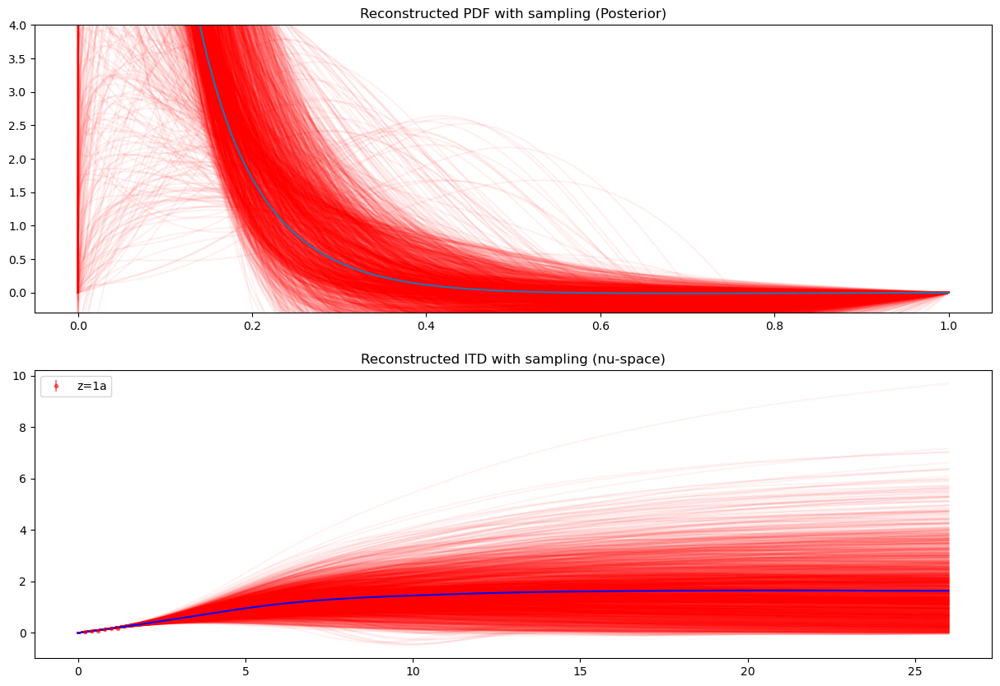

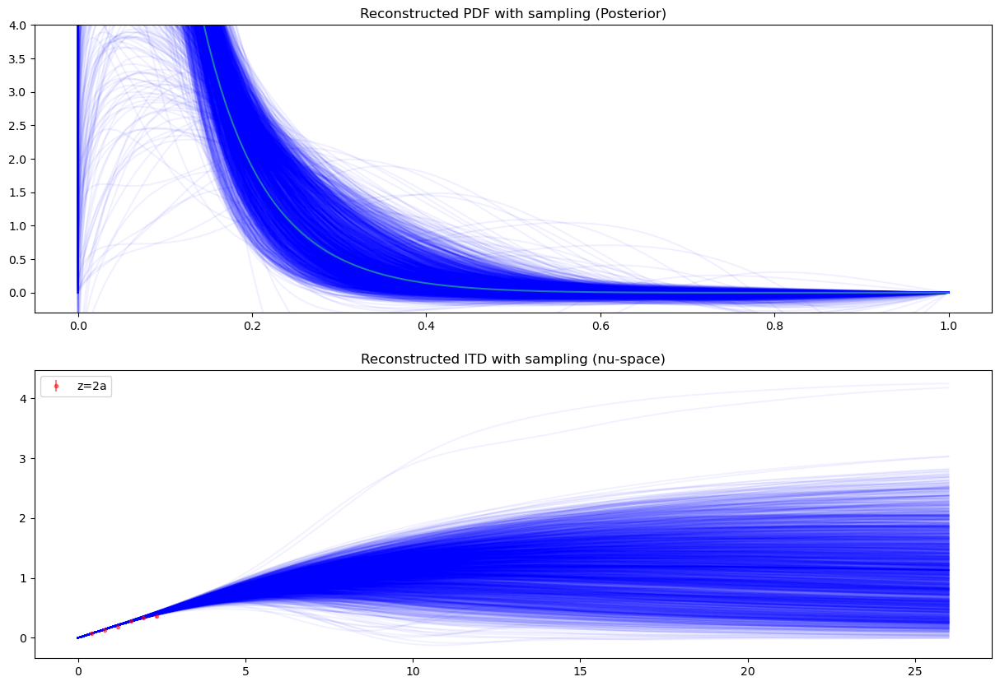

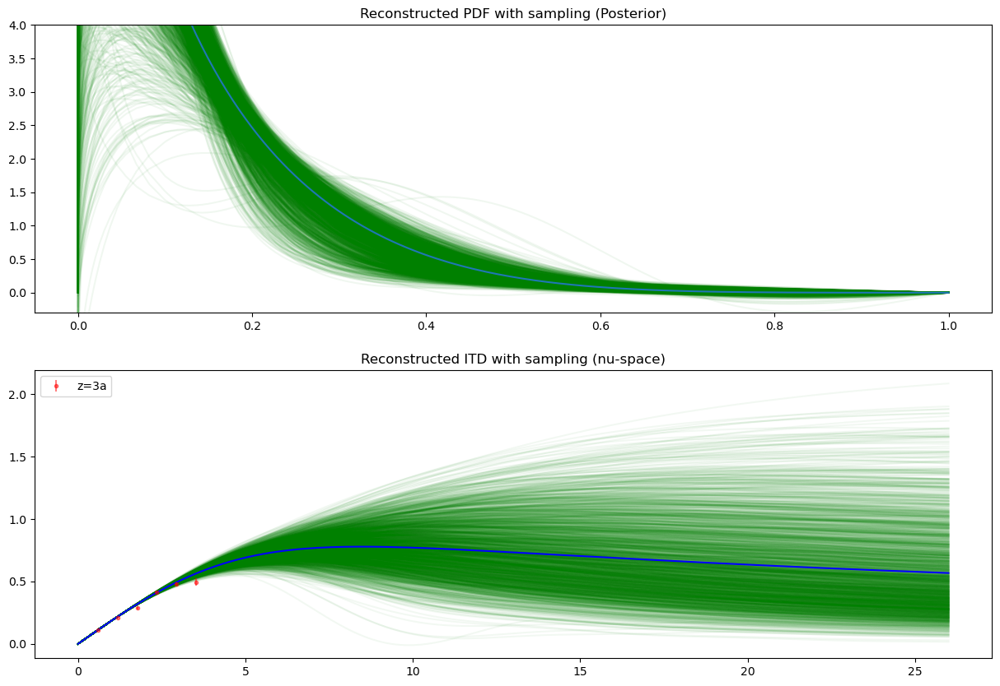

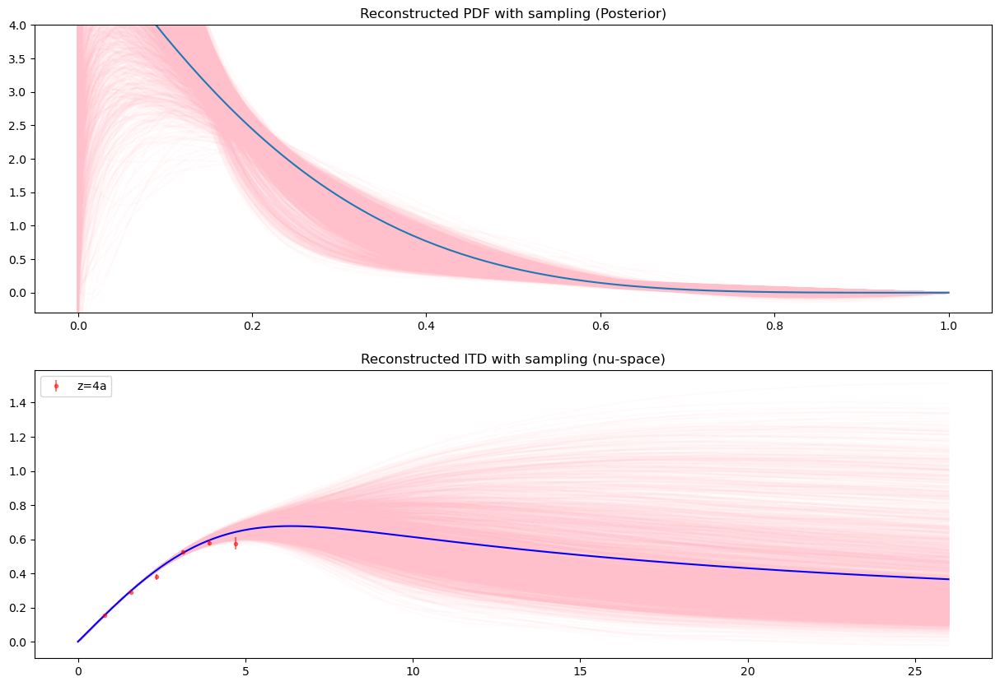

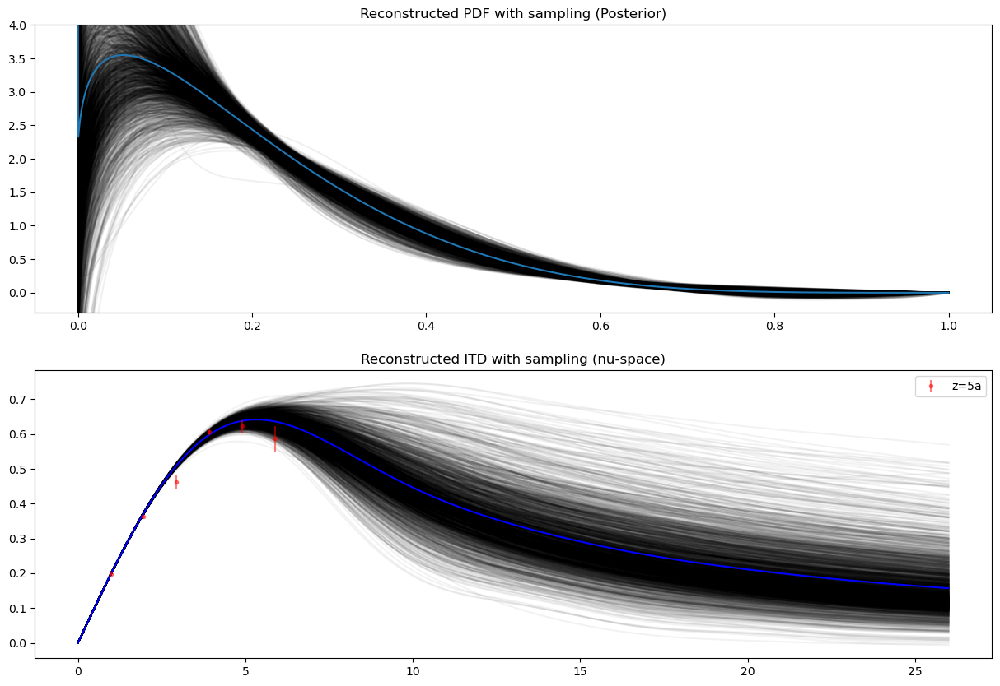

...

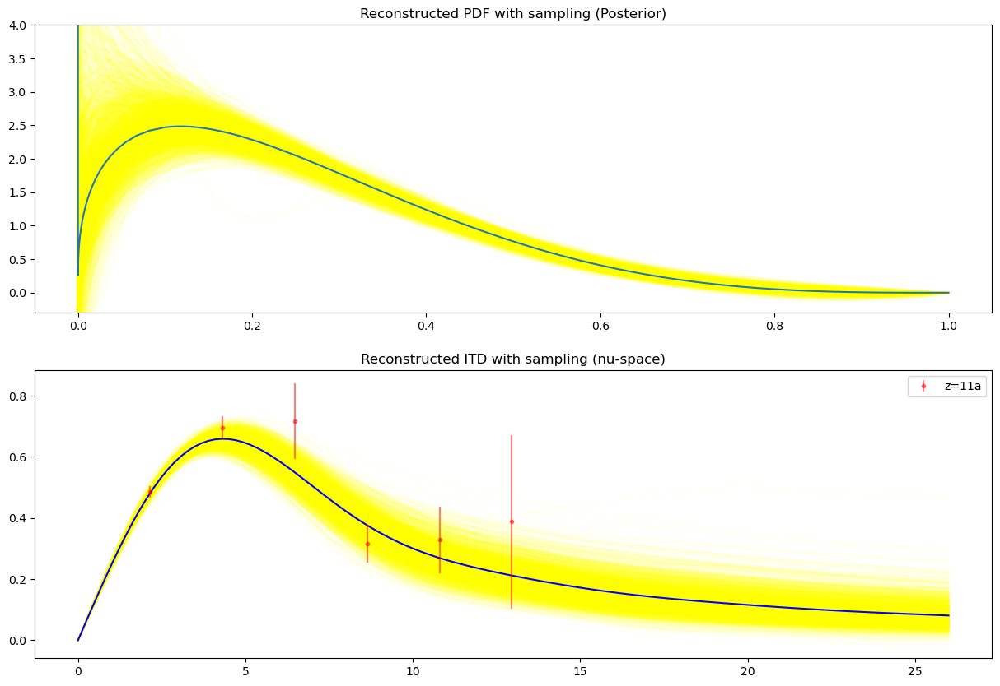

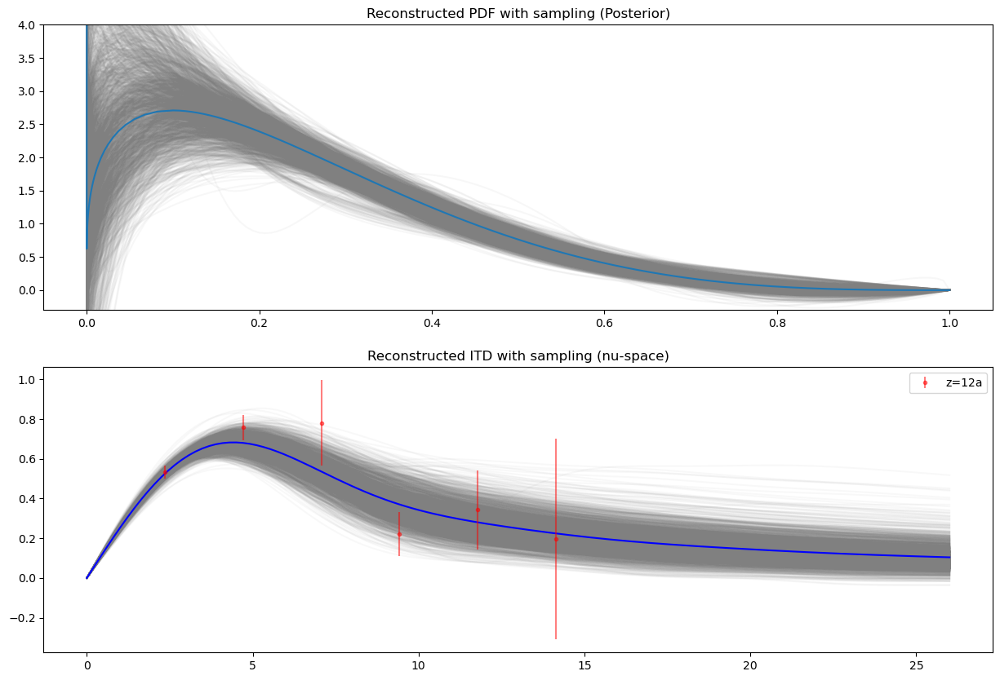

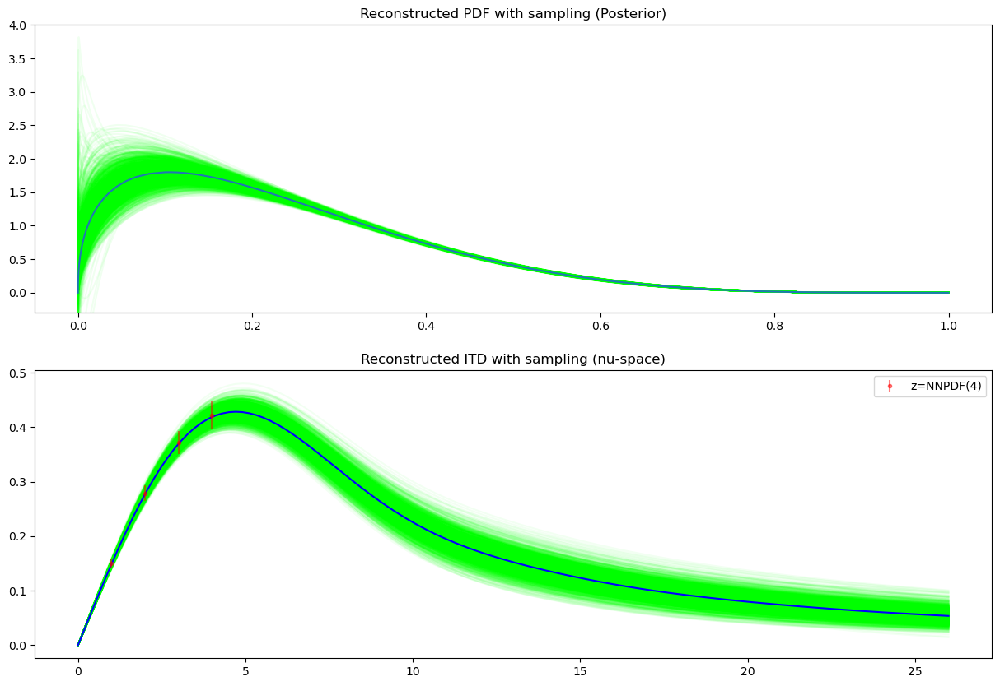

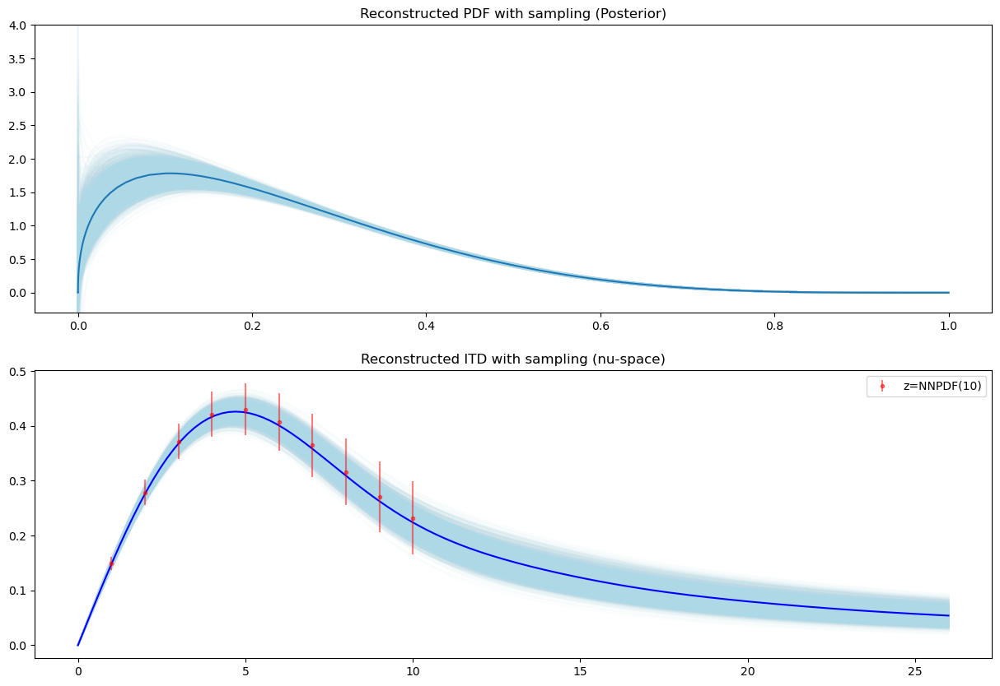

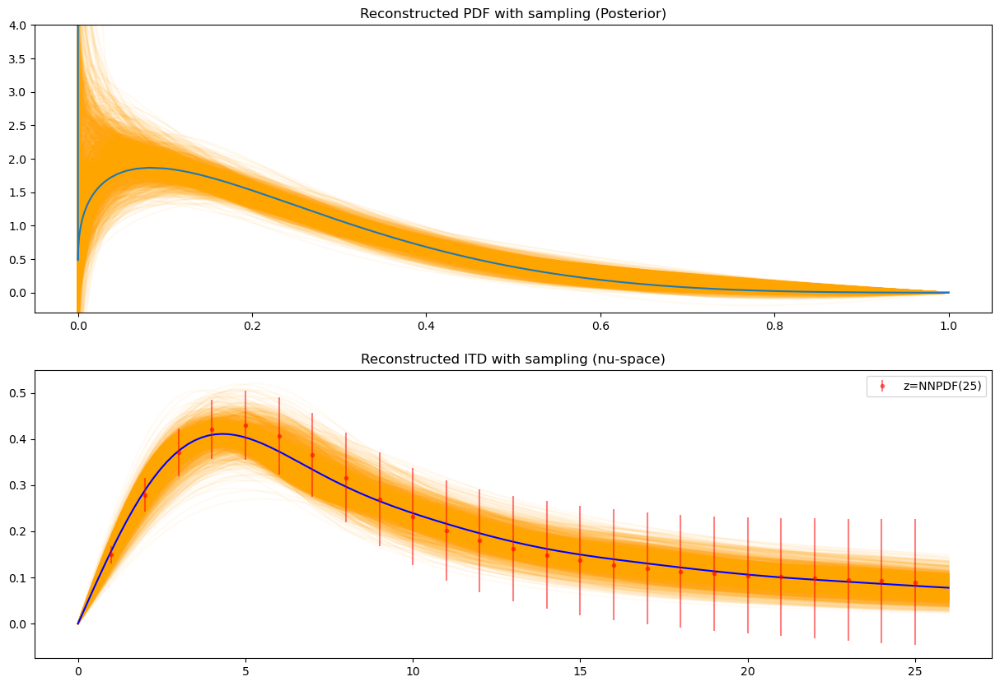

In [13]:
for i in range(0,number):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    #qofx,cov,pms,Qofv,covnu,Qvs=fits_comb[i].Uncertaintyanalysis(traceq[0:10000])
    #=fits_comb[i].Uncertaintyanalysis(traceq[0:10000])
    covs[i] = 0.5*(covs[i]+covs[i].T) #+1e-5*tr.eye(cov.shape[0])
    #pms=tr.stack(pms)
    ttQ = samplesqx[i]@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime','lightblue','orange']
    for j in range(len(samplesqx[i])):
        ax[0].plot(x_gri0,samplesqx[i][j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofxs[i],label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])


    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i >=12 and test=="NNPDF":
        if ITD=="Re":
            MMM='real'
        elif ITD=="Im":
            MMM='imag'
        if i==12:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax4.dat',dtype=np.float64)
        elif i==13:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax10.dat',dtype=np.float64)
        elif i==14:
            datanu=np.loadtxt('NNPDF/NNPDF40_nnlo_as_01180_1000_itd_'+MMM+'_numax25.dat',dtype=np.float64)
        nu_d_grid = datanu.T[1]
        M=datanu.T[2:].mean(axis=0)
        eMnu=datanu.T[2:].std(axis=0)*np.sqrt(datanu.shape[0])
        plt.errorbar(nu_d_grid,M,eMnu,fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    if i<12:
        plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label=fits_comb[i].name,color='red')
    plt.legend()
    plt.show()

z=1a tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.0611e-05, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 1.0629e-04, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 4.2062e-04, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.2613e-04,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         8.4588e-04, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 2.3118e-03]])


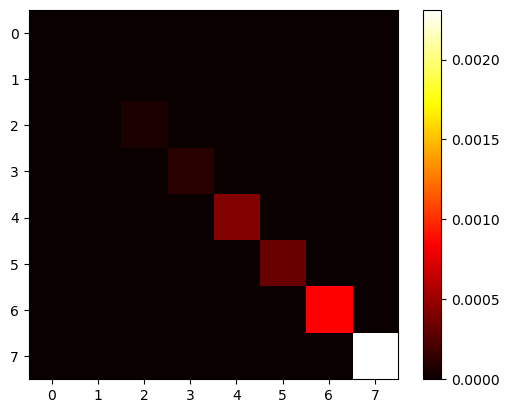

z=2a tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.1866e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 3.9044e-04, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.6133e-03, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 1.2762e-03,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         3.3457e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 9.2278e-03]])


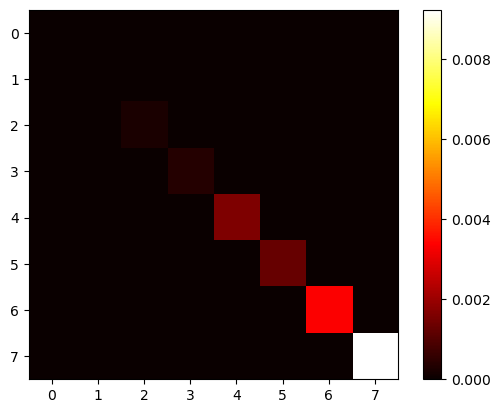

z=3a tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.7651e-04, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 8.5631e-04, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 3.6570e-03, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 2.8572e-03,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         7.4198e-03, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 2.0330e-02]])


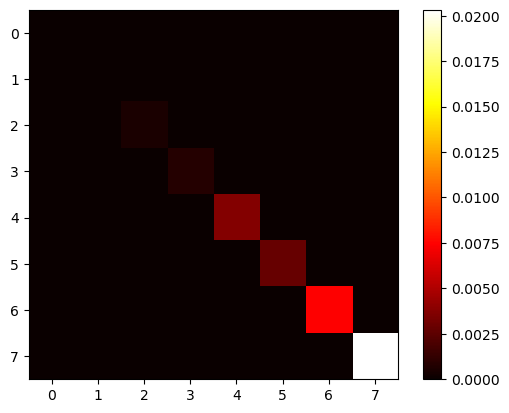

z=4a tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.8187e-07, 8.0225e-07, 7.1709e-07, 2.8206e-07,
         1.1174e-08, 1.2782e-06],
        [0.0000e+00, 0.0000e+00, 8.0225e-07, 2.2668e-06, 5.1541e-06, 1.5841e-06,
         9.8719e-07, 2.6502e-06],
        [0.0000e+00, 0.0000e+00, 7.1709e-07, 5.1541e-06, 4.3662e-05, 1.0965e-05,
         1.8673e-05, 3.2788e-05],
        [0.0000e+00, 0.0000e+00, 2.8206e-07, 1.5841e-06, 1.0965e-05, 2.5568e-05,
         4.2005e-05, 4.9245e-05],
        [0.0000e+00, 0.0000e+00, 1.1174e-08, 9.8719e-07, 1.8673e-05, 4.2005e-05,
         1.6207e-04, 2.7862e-04],
        [0.0000e+00, 0.0000e+00, 1.2782e-06, 2.6502e-06, 3.2788e-05, 4.9245e-05,
         2.7862e-04, 1.1594e-03]])


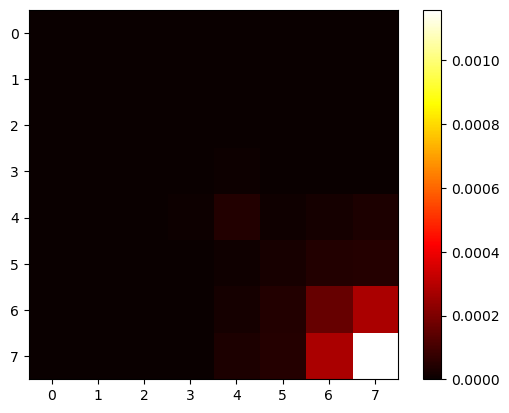

z=5a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  1.7161e-06,  1.9742e-06,  1.5457e-06,
          5.8268e-07, -2.5324e-07,  2.7135e-06],
        [ 0.0000e+00,  0.0000e+00,  1.9742e-06,  5.7478e-06,  1.2610e-05,
          3.7388e-06,  2.0910e-06,  5.1065e-06],
        [ 0.0000e+00,  0.0000e+00,  1.5457e-06,  1.2610e-05,  1.0965e-04,
          2.6707e-05,  4.3523e-05,  7.3825e-05],
        [ 0.0000e+00,  0.0000e+00,  5.8268e-07,  3.7388e-06,  2.6707e-05,
          6.0860e-05,  9.5002e-05,  1.0205e-04],
        [ 0.0000e+00,  0.0000e+00, -2.5324e-07,  2.0910e-06,  4.3523e-05,
          9.5002e-05,  3.5146e-04,  5.7416e-04],
        [ 0.0000e+00,  0.0000e+00,  2.7135e-06,  5.1065e-06,  7.3825e-05,
          1.0205e-04,  5.7416e-04,  2.3411e-03]])


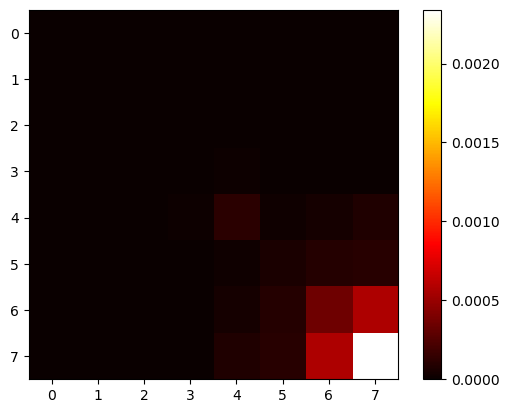

z=6a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  3.8613e-06,  4.1610e-06,  2.3186e-06,
          1.2090e-06, -8.0852e-07,  1.7557e-06],
        [ 0.0000e+00,  0.0000e+00,  4.1610e-06,  1.2738e-05,  2.6795e-05,
          8.0779e-06,  4.7598e-06,  5.5499e-06],
        [ 0.0000e+00,  0.0000e+00,  2.3186e-06,  2.6795e-05,  2.3840e-04,
          5.6164e-05,  8.8478e-05,  1.4325e-04],
        [ 0.0000e+00,  0.0000e+00,  1.2090e-06,  8.0779e-06,  5.6164e-05,
          1.2402e-04,  1.7887e-04,  1.7333e-04],
        [ 0.0000e+00,  0.0000e+00, -8.0852e-07,  4.7598e-06,  8.8478e-05,
          1.7887e-04,  6.2544e-04,  9.5357e-04],
        [ 0.0000e+00,  0.0000e+00,  1.7557e-06,  5.5499e-06,  1.4325e-04,
          1.7333e-04,  9.5357e-04,  3.8157e-03]])


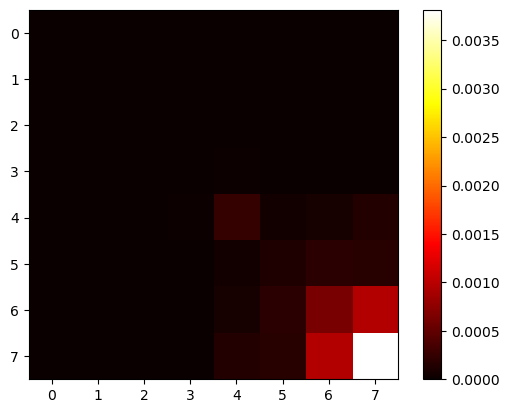

z=7a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  8.4484e-06,  8.6251e-06,  2.7413e-06,
          2.1951e-06, -1.1668e-06, -1.4640e-06],
        [ 0.0000e+00,  0.0000e+00,  8.6251e-06,  2.7796e-05,  5.3953e-05,
          1.6008e-05,  1.0729e-05,  8.3823e-06],
        [ 0.0000e+00,  0.0000e+00,  2.7413e-06,  5.3953e-05,  4.8448e-04,
          1.0659e-04,  1.6201e-04,  2.5405e-04],
        [ 0.0000e+00,  0.0000e+00,  2.1951e-06,  1.6008e-05,  1.0659e-04,
          2.3332e-04,  2.9992e-04,  2.6521e-04],
        [ 0.0000e+00,  0.0000e+00, -1.1668e-06,  1.0729e-05,  1.6201e-04,
          2.9992e-04,  9.7682e-04,  1.3806e-03],
        [ 0.0000e+00,  0.0000e+00, -1.4640e-06,  8.3823e-06,  2.5405e-04,
          2.6521e-04,  1.3806e-03,  5.4979e-03]])


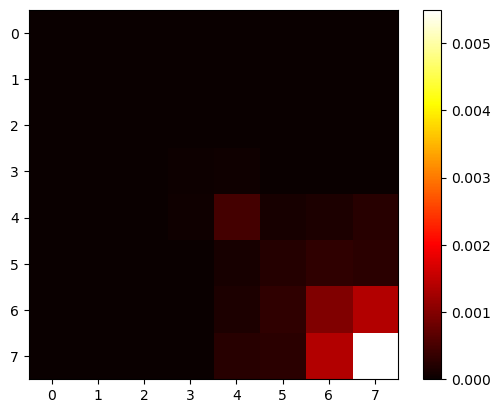

z=8a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  1.9290e-05,  1.9836e-05,  7.2751e-06,
          2.6881e-06, -1.5060e-06, -8.6124e-06],
        [ 0.0000e+00,  0.0000e+00,  1.9836e-05,  6.5007e-05,  1.1324e-04,
          2.4499e-05,  1.7481e-05,  2.2025e-05],
        [ 0.0000e+00,  0.0000e+00,  7.2751e-06,  1.1324e-04,  9.9721e-04,
          1.8359e-04,  2.7175e-04,  4.3577e-04],
        [ 0.0000e+00,  0.0000e+00,  2.6881e-06,  2.4499e-05,  1.8359e-04,
          4.3659e-04,  4.7145e-04,  3.4201e-04],
        [ 0.0000e+00,  0.0000e+00, -1.5060e-06,  1.7481e-05,  2.7175e-04,
          4.7145e-04,  1.4598e-03,  1.8305e-03],
        [ 0.0000e+00,  0.0000e+00, -8.6124e-06,  2.2025e-05,  4.3577e-04,
          3.4201e-04,  1.8305e-03,  7.6809e-03]])


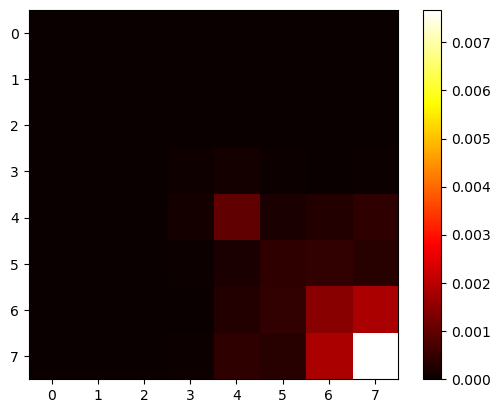

z=9a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  4.7102e-05,  4.9718e-05,  3.2389e-05,
         -2.7577e-06, -1.0414e-05, -7.1674e-06],
        [ 0.0000e+00,  0.0000e+00,  4.9718e-05,  1.6736e-04,  2.6150e-04,
          2.2180e-05,  7.8238e-06,  5.6317e-05],
        [ 0.0000e+00,  0.0000e+00,  3.2389e-05,  2.6150e-04,  2.2645e-03,
          3.0659e-04,  4.1991e-04,  7.1123e-04],
        [ 0.0000e+00,  0.0000e+00, -2.7577e-06,  2.2180e-05,  3.0659e-04,
          8.4580e-04,  7.8166e-04,  3.5669e-04],
        [ 0.0000e+00,  0.0000e+00, -1.0414e-05,  7.8238e-06,  4.1991e-04,
          7.8166e-04,  2.4839e-03,  2.5873e-03],
        [ 0.0000e+00,  0.0000e+00, -7.1674e-06,  5.6317e-05,  7.1123e-04,
          3.5669e-04,  2.5873e-03,  1.2677e-02]])


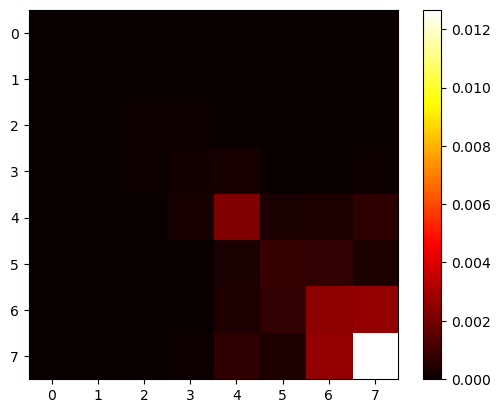

z=10a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  1.2369e-04,  1.3739e-04,  1.2227e-04,
         -3.1018e-05, -3.2751e-05,  2.3674e-05],
        [ 0.0000e+00,  0.0000e+00,  1.3739e-04,  4.7579e-04,  6.3771e-04,
         -1.3171e-05, -4.7884e-05,  4.3474e-05],
        [ 0.0000e+00,  0.0000e+00,  1.2227e-04,  6.3771e-04,  5.5883e-03,
          5.1859e-04,  4.6981e-04,  8.4850e-04],
        [ 0.0000e+00,  0.0000e+00, -3.1018e-05, -1.3171e-05,  5.1859e-04,
          1.8153e-03,  1.5219e-03,  3.1195e-04],
        [ 0.0000e+00,  0.0000e+00, -3.2751e-05, -4.7884e-05,  4.6981e-04,
          1.5219e-03,  5.3760e-03,  4.7791e-03],
        [ 0.0000e+00,  0.0000e+00,  2.3674e-05,  4.3474e-05,  8.4850e-04,
          3.1195e-04,  4.7791e-03,  2.7853e-02]])


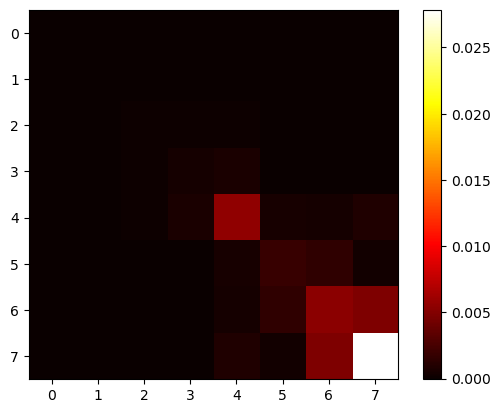

z=11a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  3.4799e-04,  4.0517e-04,  3.9018e-04,
         -9.7959e-05, -2.4570e-05,  9.5224e-05],
        [ 0.0000e+00,  0.0000e+00,  4.0517e-04,  1.4393e-03,  1.6740e-03,
         -1.8018e-04, -2.5780e-04,  8.4498e-05],
        [ 0.0000e+00,  0.0000e+00,  3.9018e-04,  1.6740e-03,  1.5191e-02,
          8.8344e-04,  5.0649e-04,  1.5234e-03],
        [ 0.0000e+00,  0.0000e+00, -9.7959e-05, -1.8018e-04,  8.8344e-04,
          4.4667e-03,  3.4478e-03, -2.7045e-04],
        [ 0.0000e+00,  0.0000e+00, -2.4570e-05, -2.5780e-04,  5.0649e-04,
          3.4478e-03,  1.4148e-02,  1.1083e-02],
        [ 0.0000e+00,  0.0000e+00,  9.5224e-05,  8.4498e-05,  1.5234e-03,
         -2.7045e-04,  1.1083e-02,  7.5649e-02]])


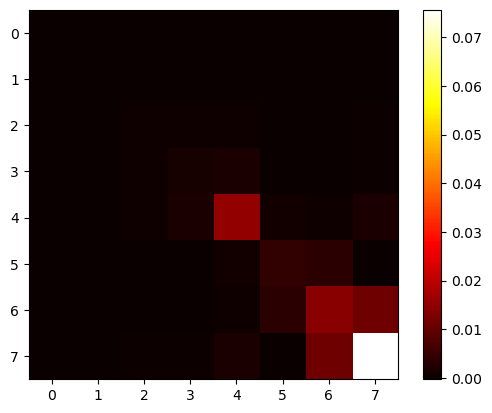

z=12a tensor([[ 1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  1.0000e-10,  0.0000e+00,  0.0000e+00,  0.0000e+00,
          0.0000e+00,  0.0000e+00,  0.0000e+00],
        [ 0.0000e+00,  0.0000e+00,  9.8393e-04,  1.1178e-03,  1.0756e-03,
         -3.6076e-04, -1.2257e-04,  3.9022e-04],
        [ 0.0000e+00,  0.0000e+00,  1.1178e-03,  4.1775e-03,  4.5925e-03,
         -7.6697e-04, -1.0209e-03,  1.4248e-03],
        [ 0.0000e+00,  0.0000e+00,  1.0756e-03,  4.5925e-03,  4.3370e-02,
          1.6581e-03,  1.4258e-03,  6.0528e-03],
        [ 0.0000e+00,  0.0000e+00, -3.6076e-04, -7.6697e-04,  1.6581e-03,
          1.2680e-02,  9.4553e-03, -2.3968e-03],
        [ 0.0000e+00,  0.0000e+00, -1.2257e-04, -1.0209e-03,  1.4258e-03,
          9.4553e-03,  4.1815e-02,  3.1537e-02],
        [ 0.0000e+00,  0.0000e+00,  3.9022e-04,  1.4248e-03,  6.0528e-03,
         -2.3968e-03,  3.1537e-02,  2.3819e-01]])


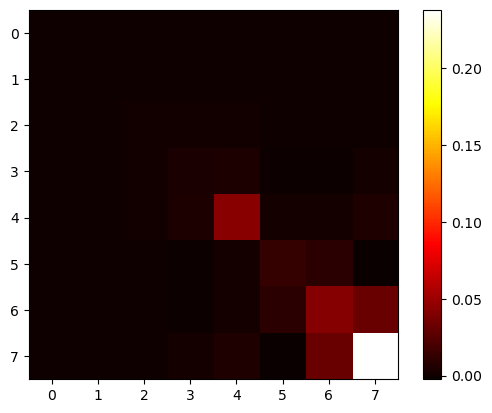

z=mock tensor([[1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 1.0000e-10, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
         0.0000e+00, 0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.7928e-04, 2.3690e-04, 2.8130e-04, 2.2918e-04,
         1.7547e-04, 1.5507e-04],
        [0.0000e+00, 0.0000e+00, 2.3690e-04, 7.9743e-04, 8.2296e-04, 6.7961e-04,
         5.1277e-04, 4.5686e-04],
        [0.0000e+00, 0.0000e+00, 2.8130e-04, 8.2296e-04, 1.0917e-03, 8.2764e-04,
         6.4040e-04, 5.6889e-04],
        [0.0000e+00, 0.0000e+00, 2.2918e-04, 6.7961e-04, 8.2764e-04, 8.3079e-04,
         5.7849e-04, 5.1938e-04],
        [0.0000e+00, 0.0000e+00, 1.7547e-04, 5.1277e-04, 6.4040e-04, 5.7849e-04,
         5.6050e-04, 4.2317e-04],
        [0.0000e+00, 0.0000e+00, 1.5507e-04, 4.5686e-04, 5.6889e-04, 5.1938e-04,
         4.2317e-04, 4.7144e-04]])


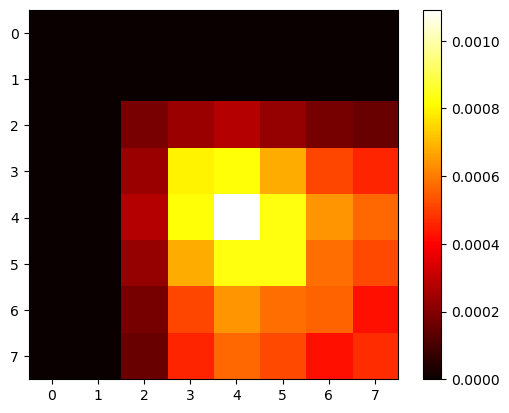

In [14]:
for i in range(0,number):
    print(fits_comb[i].name,fits_comb[i].Gamma)
    #plot gamma
    plt.imshow(fits_comb[i].Gamma.cpu().detach().numpy(),cmap='hot',interpolation='nearest')
    plt.colorbar()
    plt.show()

### Save data files

In [138]:
#save xgrid values, qofx, qsig, qerror, Qnu, Qsig
i=6
qofx=samplesqx[i].mean(axis=0)
qsig=1.96*np.diag(np.cov(samplesqx[i].T))**(0.5)
qerror=1.96*np.diag(covs[i])**(0.5)
mttQ = Qnu[i].mean(axis=0)
Qsig= 1.97*np.diag(np.cov(Qnu[i].T))**0.5
#stack everything with numpy
qofx=qofx.numpy()
mttQ=mttQ.numpy()

allarrays= np.row_stack([x_gri0,qofx,qsig,qerror])

np.savetxt("pdf(z=7).txt",allarrays.T,fmt='%.16f')


In [142]:
i=6
mttQ = Qnu[i].mean(axis=0)
Qsig= 1.97*np.diag(np.cov(Qnu[i].T))**0.5
allarrays= np.row_stack([nn,mttQ,Qsig])

np.savetxt("itd(z=7).txt",allarrays.T,fmt='%.16f')

Correlation Coefficients z=1a done


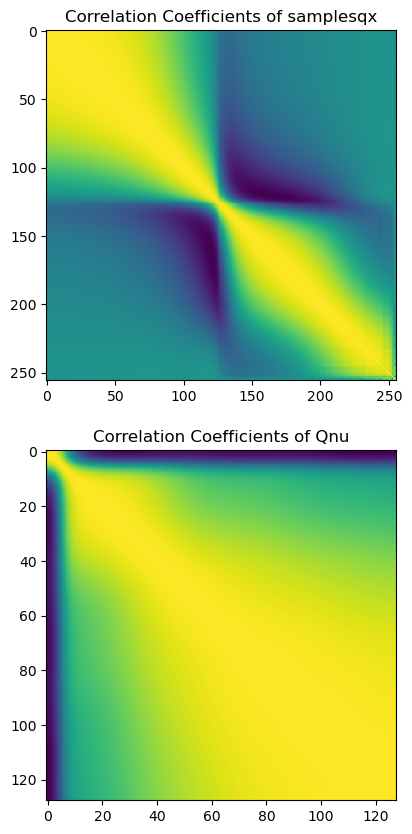

Correlation Coefficients z=2a done


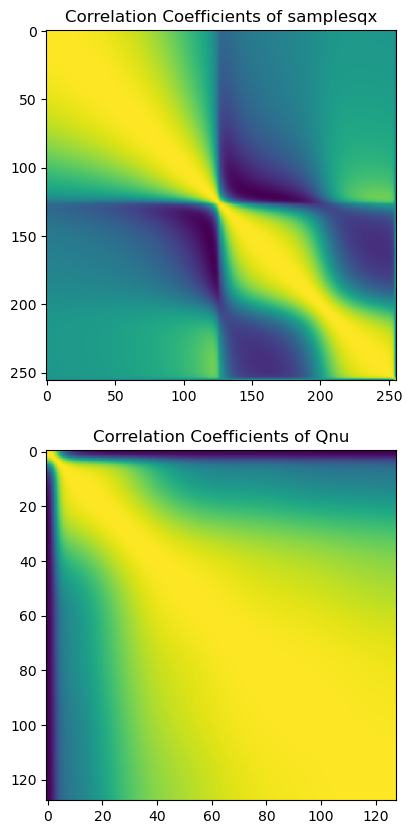

Correlation Coefficients z=3a done


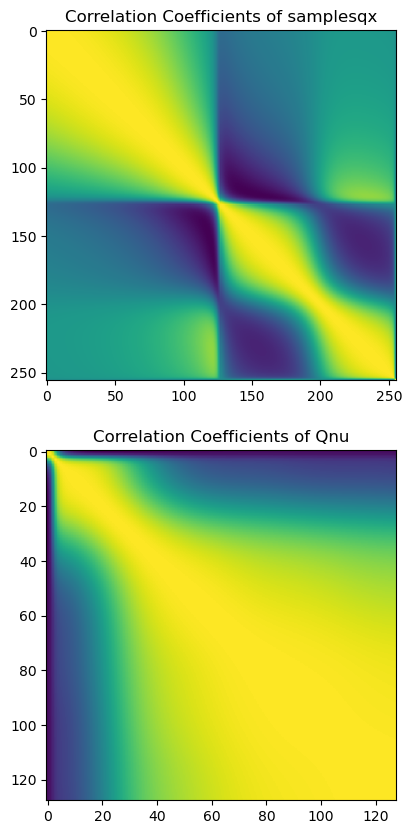

Correlation Coefficients z=4a done


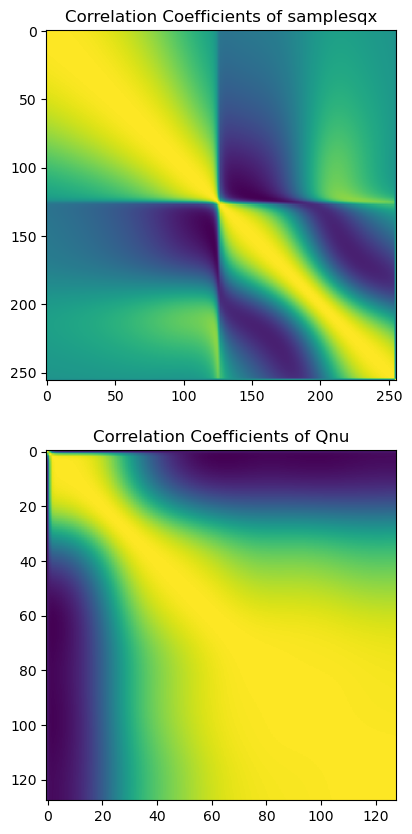

Correlation Coefficients z=5a done


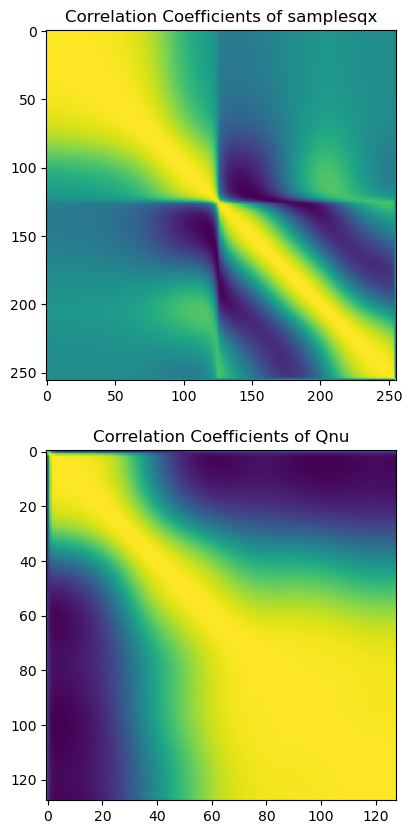

Correlation Coefficients z=6a done


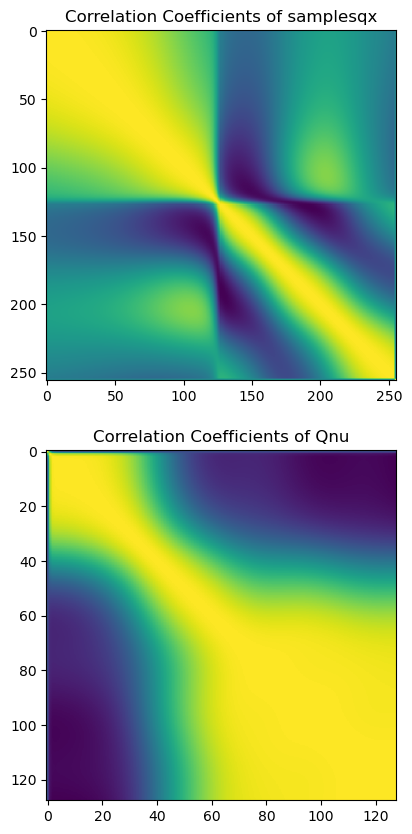

Correlation Coefficients z=7a done


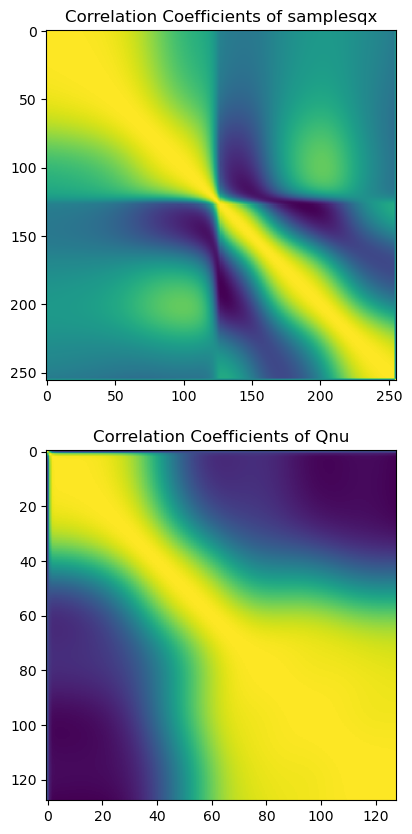

Correlation Coefficients z=8a done


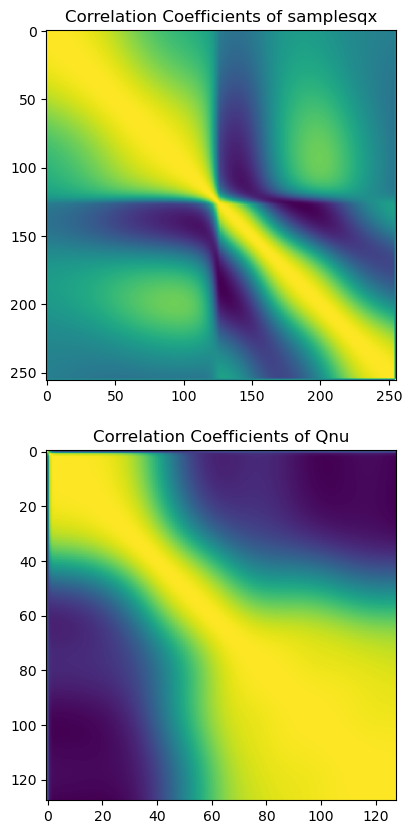

Correlation Coefficients z=9a done


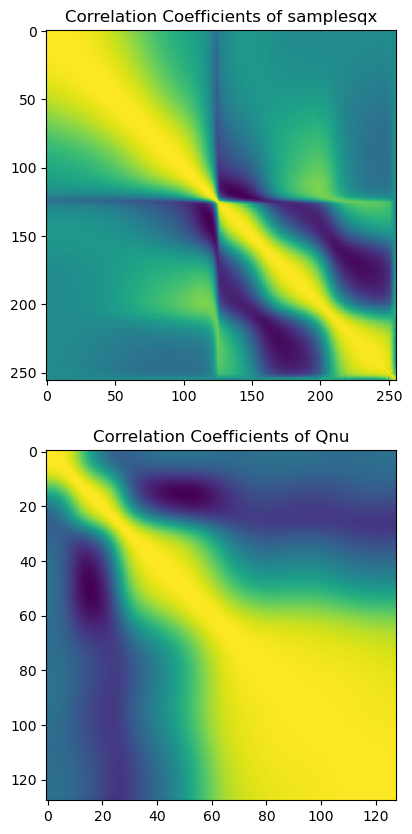

Correlation Coefficients z=10a done


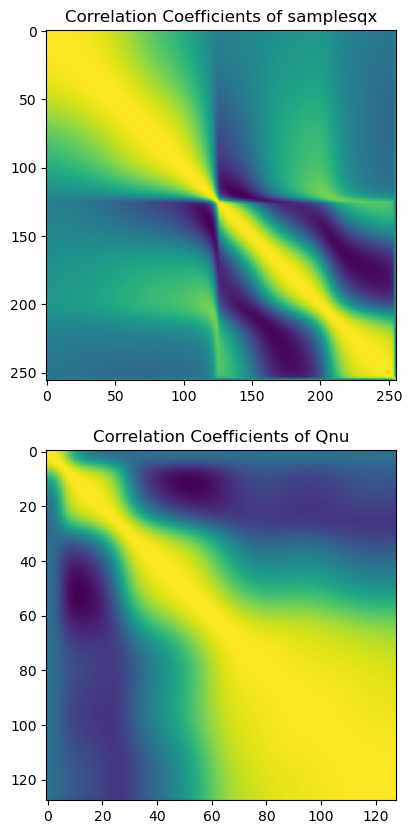

Correlation Coefficients z=11a done


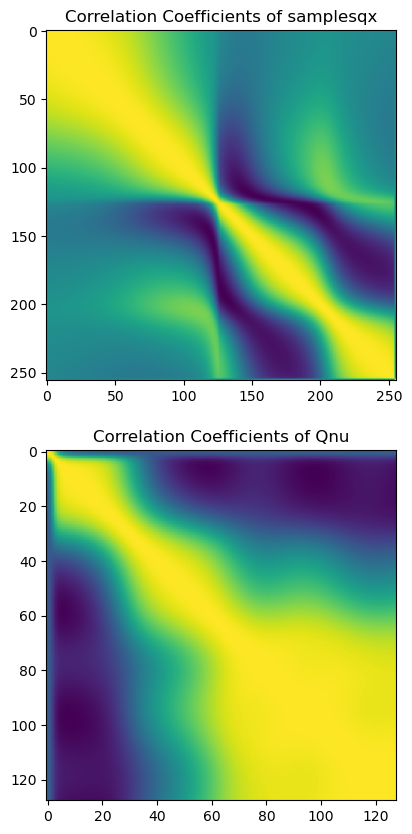

Correlation Coefficients z=12a done


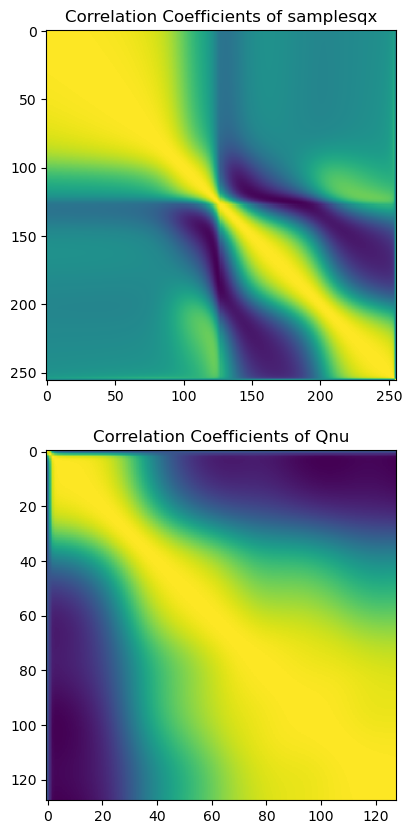

Correlation Coefficients z=mock done


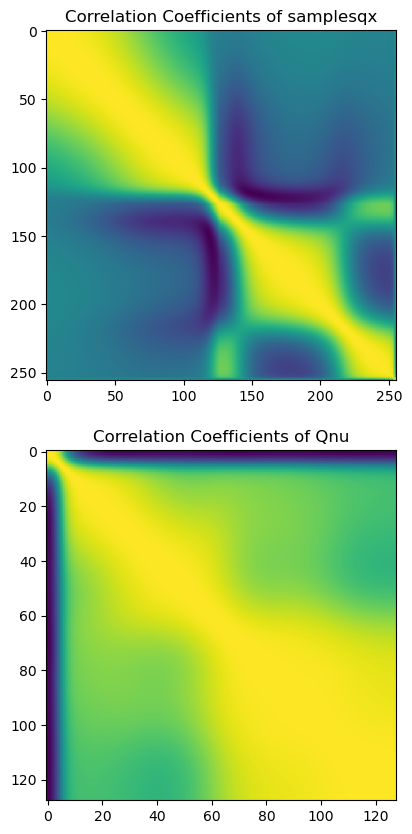

In [12]:
#correlation coefficients of samplesqx and Qnus
covsqx=[]
covsnu=[]
for i in range(0,13):
    covsqx.append(np.corrcoef(samplesqx[i].T))
    covsnu.append(np.corrcoef(Qnu[i].T))
    print("Correlation Coefficients",fits_comb[i].name,"done")
    #plot correlation coefficients
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Correlation Coefficients of samplesqx")
    ax[1].set_title("Correlation Coefficients of Qnu")
    ax[0].imshow(covsqx[i])
    ax[1].imshow(covsnu[i])
    #bar plot
    plt.show()

In [36]:
#identify position of inf and nan in cov
def find_inf_nan(cov):

    nanidx = tr.isnan(cov)
    infidx = tr.isinf(cov)
    nanidx = nanidx.nonzero()
    infidx = infidx.nonzero()
    print("nanidx",nanidx)
    print("infidx",infidx)
    return nanidx,infidx

for i in range(0,13):
    find_inf_nan(tr.tensor(covsnu[i]))
    find_inf_nan(tr.tensor(covsqx[i]))
    find_inf_nan(tr.tensor(covs[i]))
    print("Identify inf and nan",fits_comb[i].name,"done")

nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
Identify inf and nan z=1a done
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([[  0,  90],
        [  0,  91],
        [  0,  92],
        ...,
        [255,  87],
        [255,  88],
        [255,  89]])
infidx tensor([[  0,   0],
        [  0,   1],
        [  0,   2],
        ...,
        [254,  87],
        [254,  88],
        [254,  89]])
Identify inf and nan z=2a done
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx tensor([], size=(0, 2), dtype=torch.int64)
nanidx tensor([], size=(0, 2), dtype=torch.int64)
infidx

/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1191714627.py:15: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  find_inf_nan(tr.tensor(covs[i]))


/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:10: RuntimeWarning: covariance is not symmetric positive-semidefinite.
  pdfMc= np.random.multivariate_normal(p,Cp,(100,))
/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:15: RuntimeWarning: invalid value encountered in sqrt
  perror=1.96*np.diag(Cp)**(0.5)


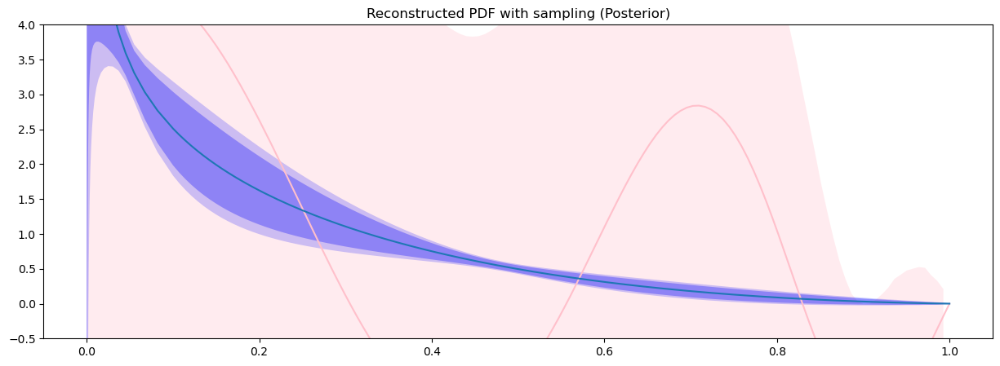

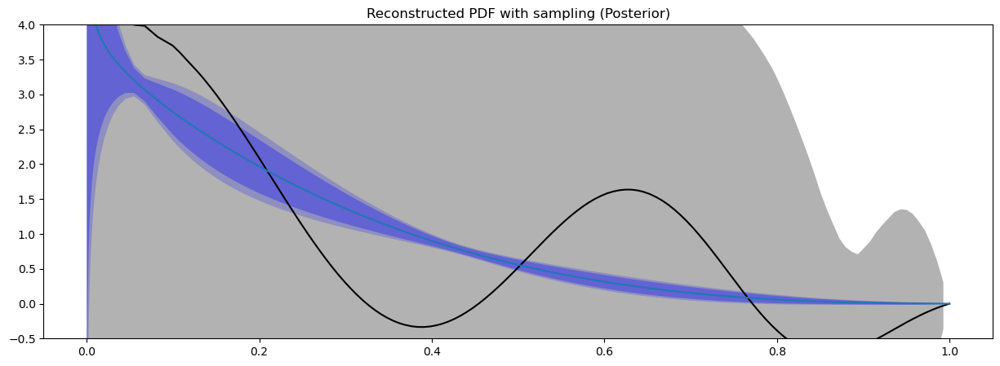

/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:18: RuntimeWarning: invalid value encountered in sqrt
  qerror=1.96*np.diag(cov)**(0.5)
/local/scr/yacahuanamedra/TMPDIR/ipykernel_2004681/1165323192.py:21: RuntimeWarning: invalid value encountered in sqrt
  qerror=2.51*np.diag(cov)**(0.5)


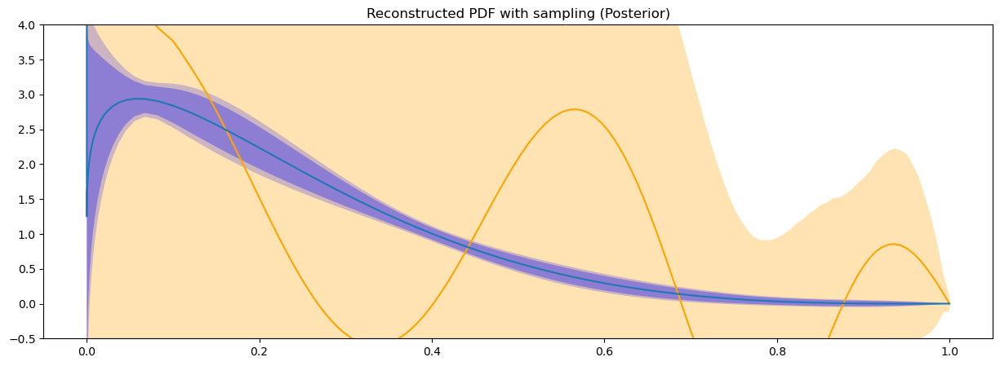

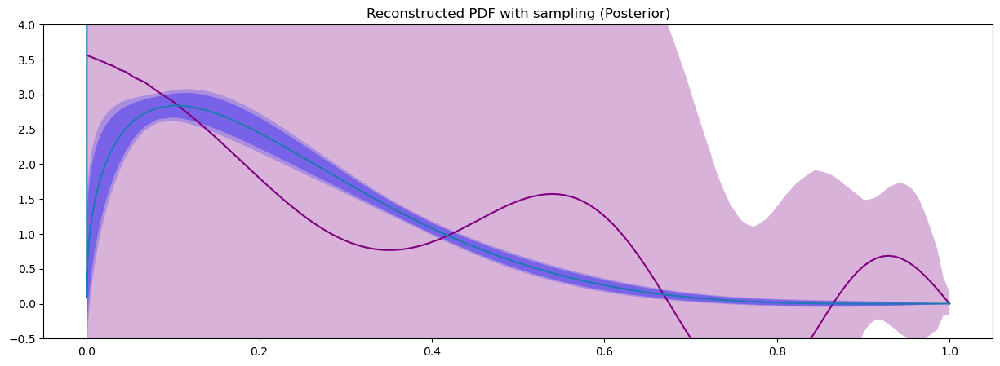

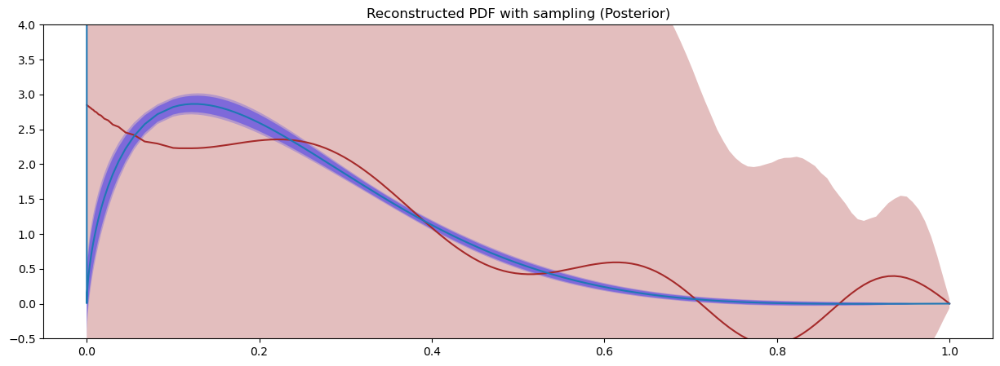

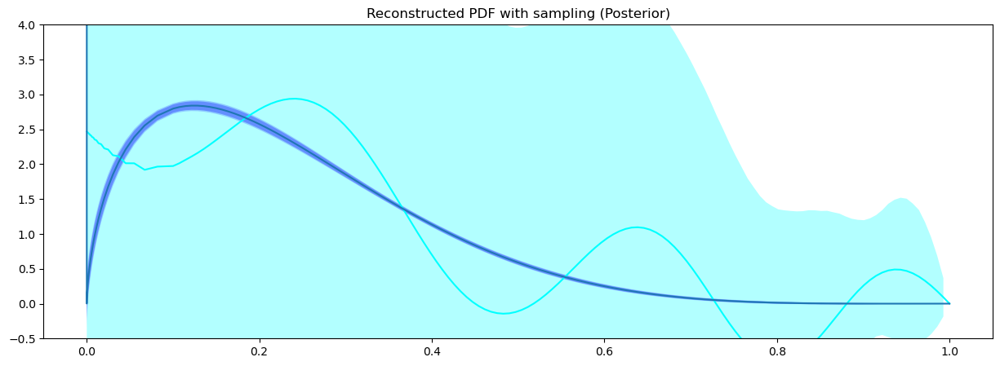

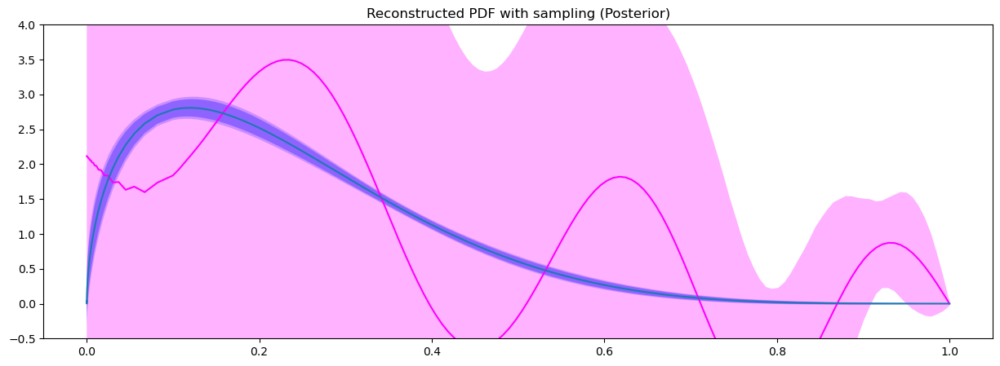

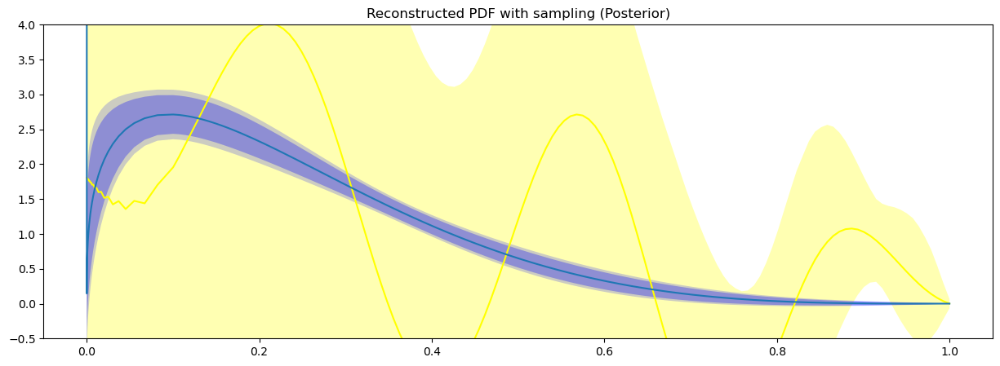

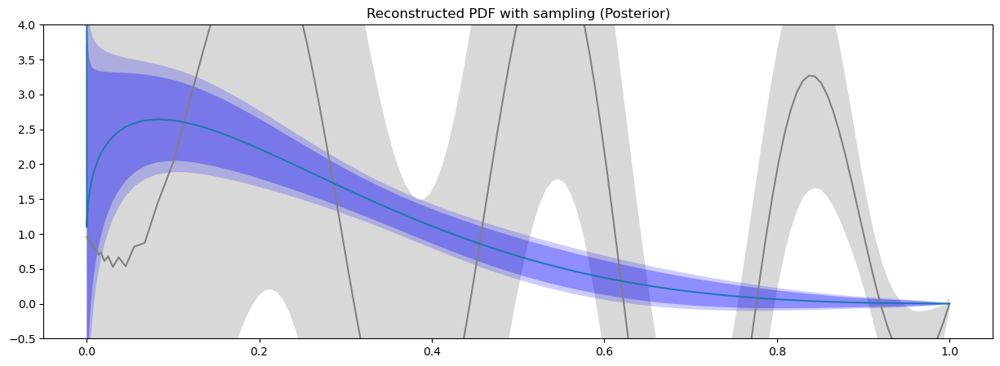

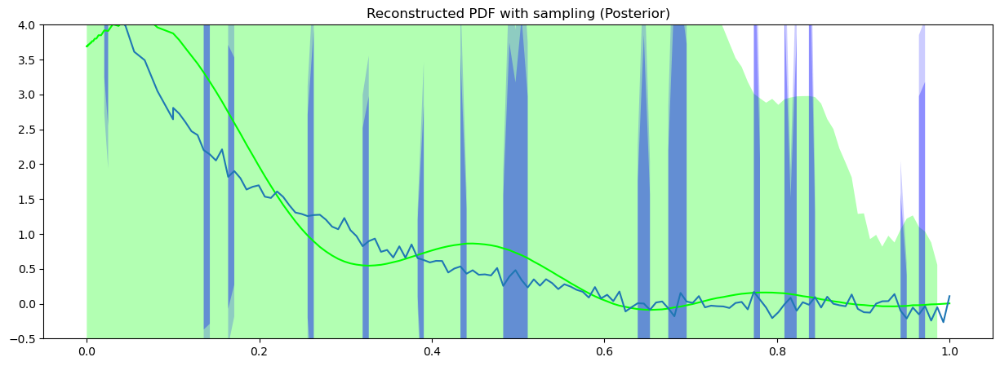

In [13]:
for i in range(3,13):
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    fig, ax= plt.subplots(1,figsize=(15, 5))
    ax.set_title("Reconstructed PDF with sampling (Posterior)")
    #ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    p,Cp = fits_comb[i].ComputePosterior()
    p,Cp = p.to("cpu"),Cp.to("cpu")
    Cp = 0.5*(Cp+Cp.T) #+1e-8*tr.eye(Cp.shape[0])
    #Mc=tr.distributions.MultivariateNormal(p,covariance_matrix=Cp)
    #pdfMc= np.random.multivariate_normal(p,Cp,(100,))
    #plot the data
    #pdfMc = Mc.sample((100,))
    #ax[0].plot(x_grid,pdfMc.T,alpha=0.1,color=col[i])
    #ax.plot(x_grid,p,label='z='+str(i+1),color=col[i])
    #perror=1.96*np.diag(Cp)**(0.5)
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::10])
    plt.plot(myGP0.x_grid.cpu(),qofx.cpu())
    qerror=1.96*np.diag(cov)**(0.5)
    ax.fill_between(x_grid, p - perror, p + perror, facecolor=col[i], alpha=0.3)
    ax.fill_between(x_grid, qofx - qerror, qofx + qerror, facecolor='blue', alpha=0.3)
    qerror=2.51*np.diag(cov)**(0.5)
    ax.fill_between(x_grid, qofx - qerror, qofx + qerror, facecolor='blue', alpha=0.2)
    plt.ylim([-0.5,4])
    plt.show()
    #p=fits_comb[i].Pd(fits_comb[i].x_grid.cpu(),*fits_comb[i].pd_args).numpy()

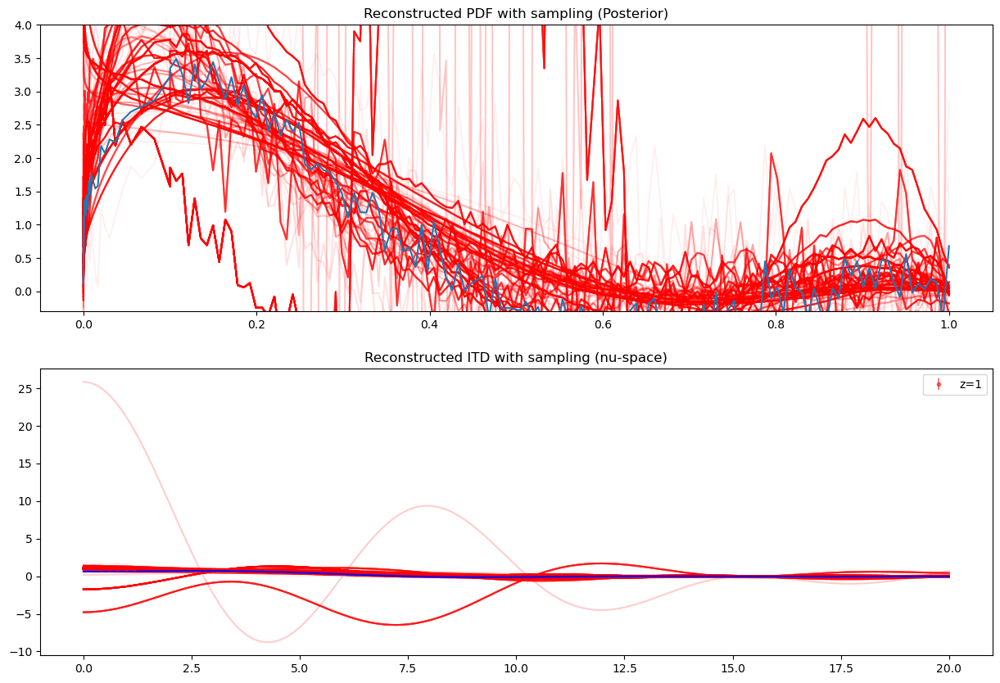

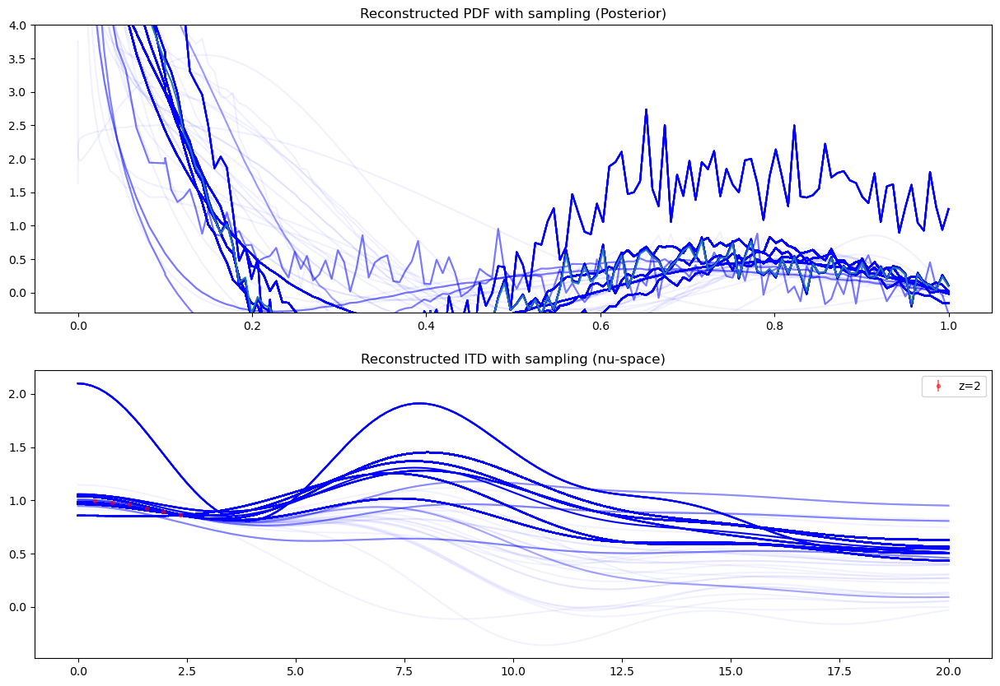

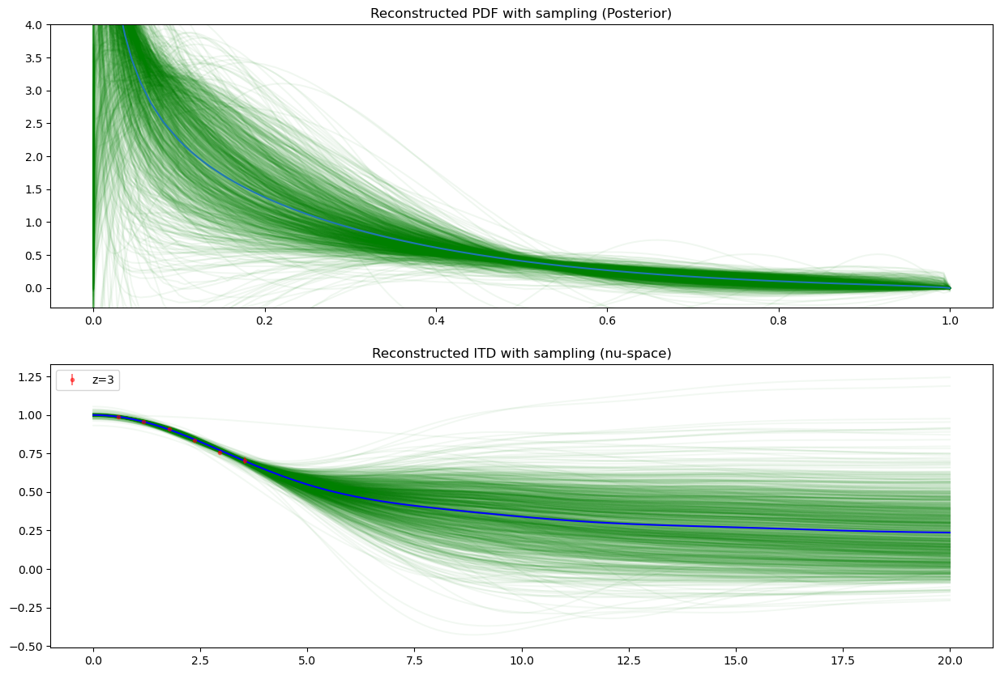

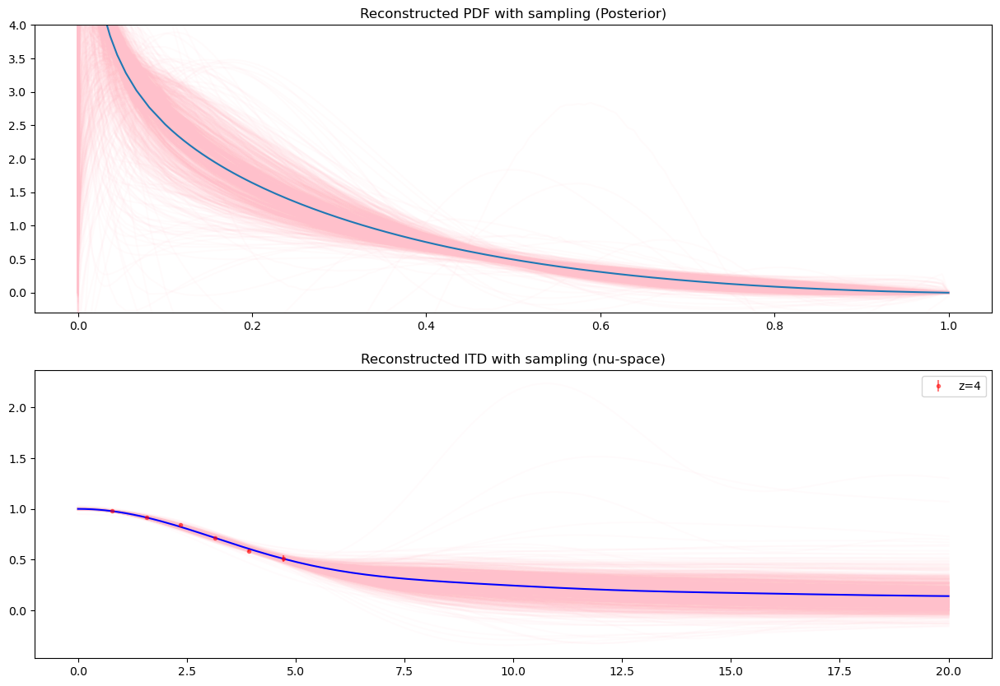

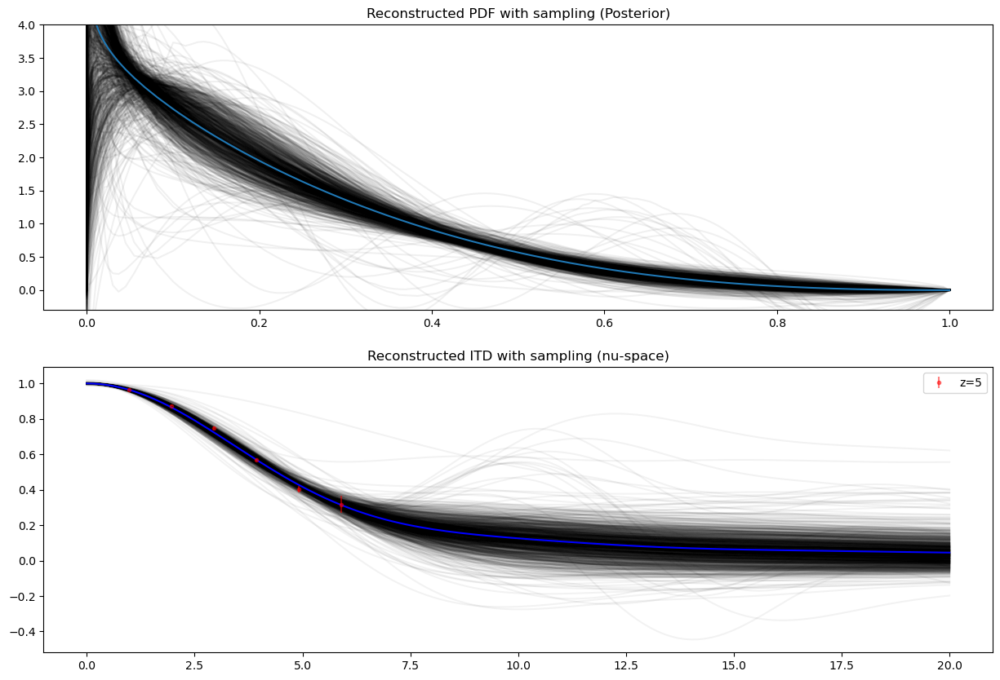

...

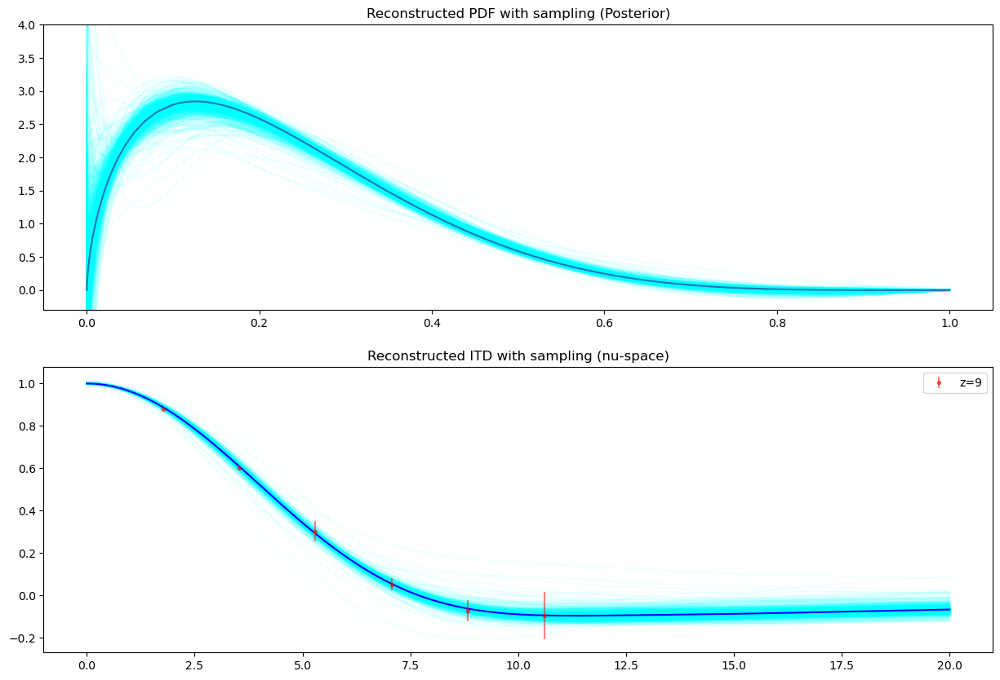

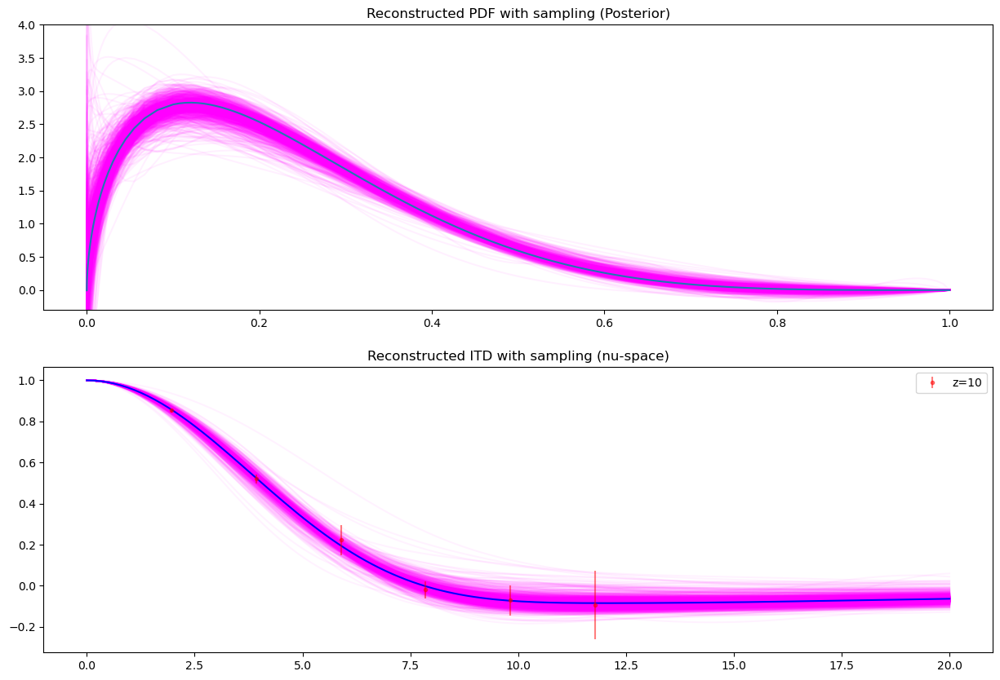

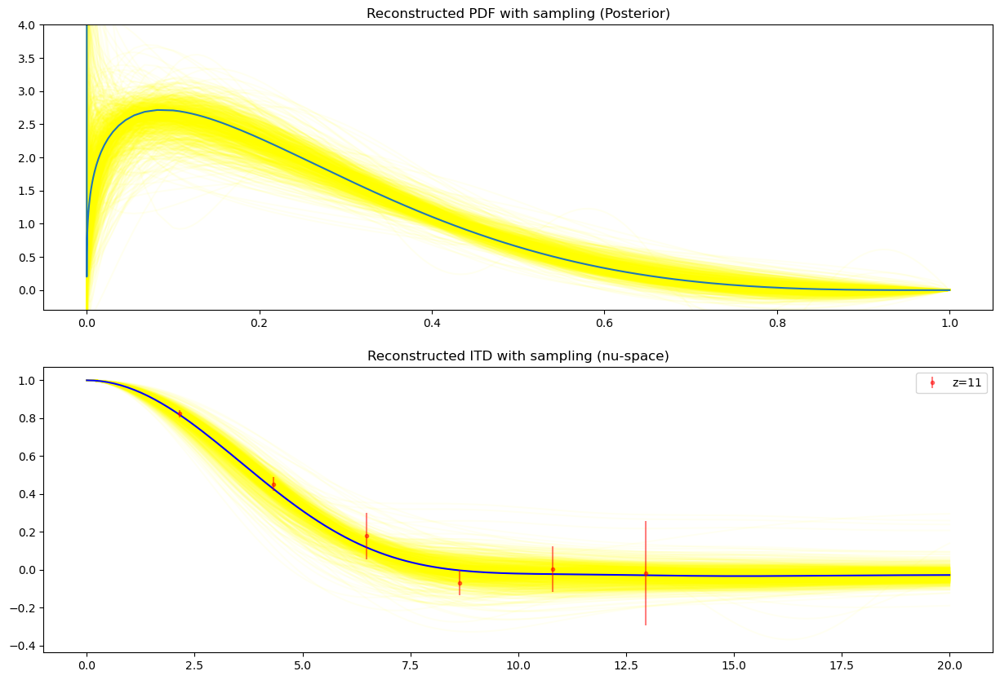

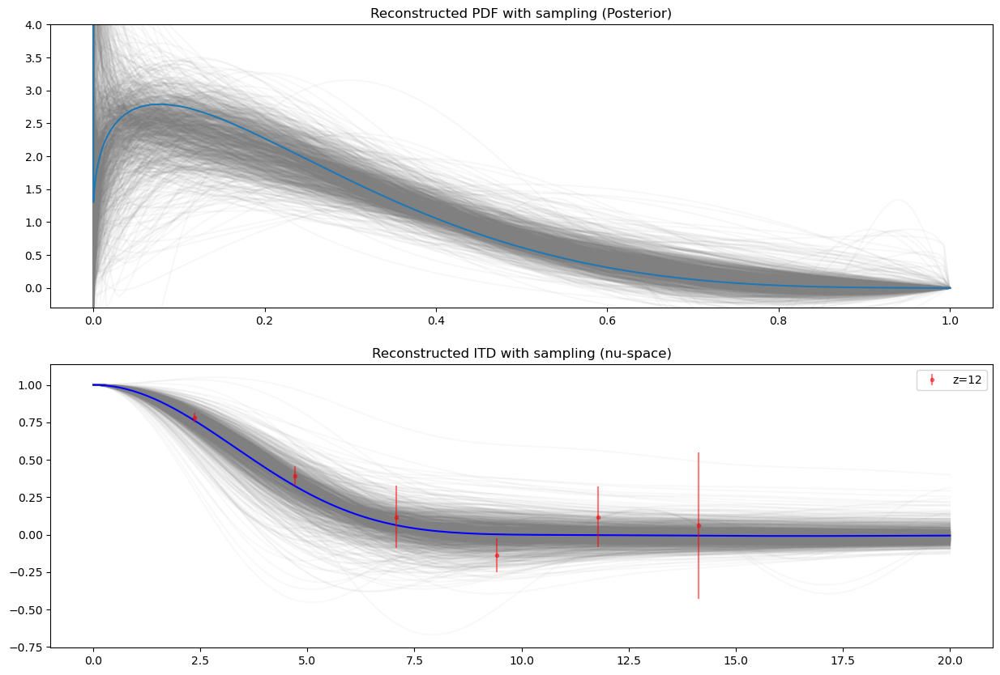

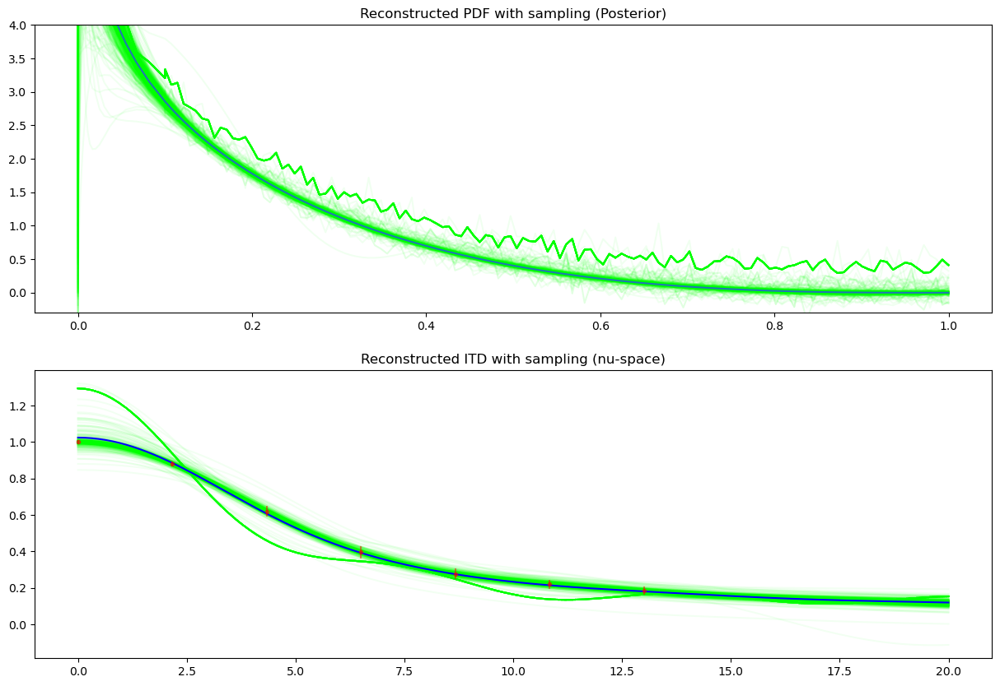

In [6]:
for i in range(0,13):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::100])
    cov = 0.5*(cov+cov.T) +1e-5*tr.eye(cov.shape[0])
    pms=tr.stack(pms)
    nn = np.linspace(0,20,128)
    iB = np.zeros((nn.shape[0],Nx))
    fe=FE2_Integrator(x_grid)
    for k in range(nn.shape[0]):
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    ttQ = pms@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    for j in range(len(pms)):
        ax[0].plot(x_gri0,pms[j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofx,label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])

    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i==12:
        numock = np.linspace(0,13,7)
        jM = pseudo_data(numock,-0.3,2.9,1.0,0.02,.2,0.2,1000)
        M = np.mean(jM,axis=0)
        eM = np.std(jM,axis=0)
        
        plt.errorbar(numock,M,eM,fmt='.',alpha=0.5,label='mock data',color='red')
        break
    plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color='red')
    plt.legend()
    plt.show()

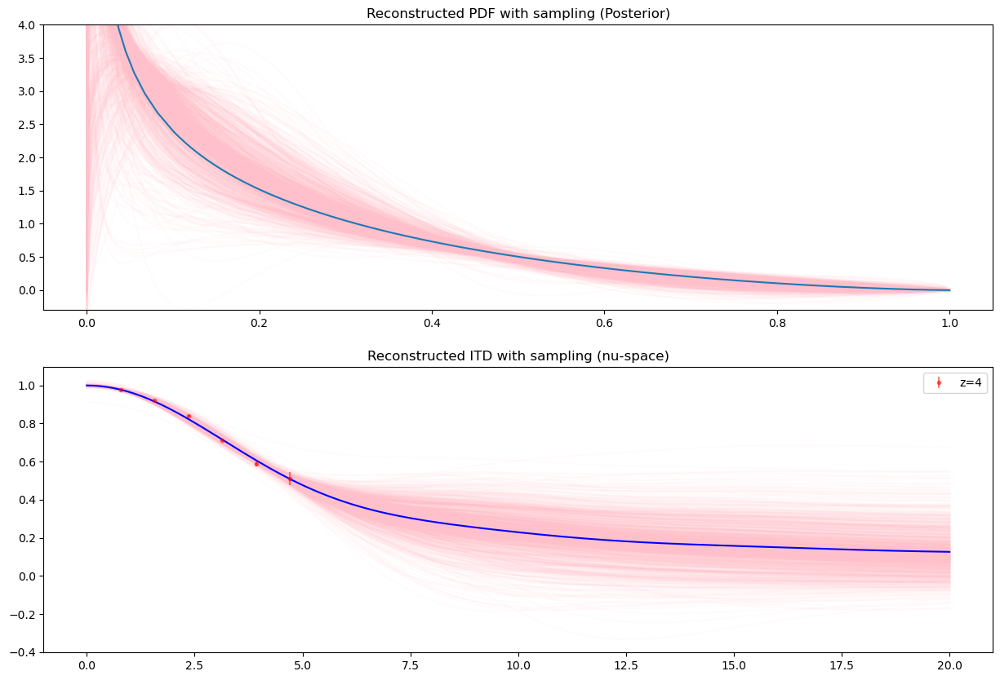

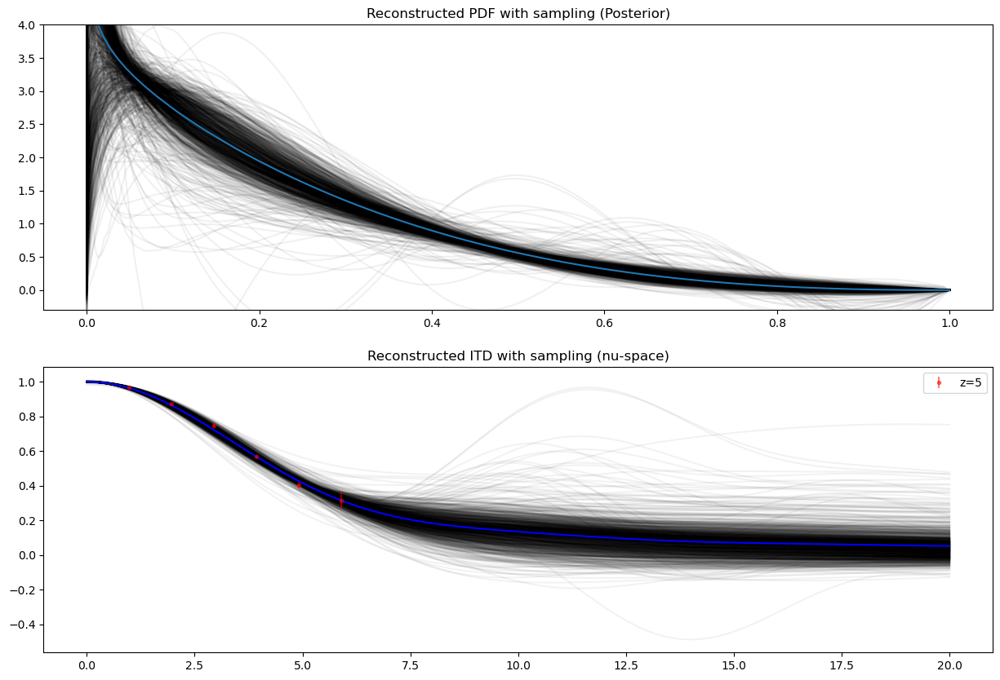

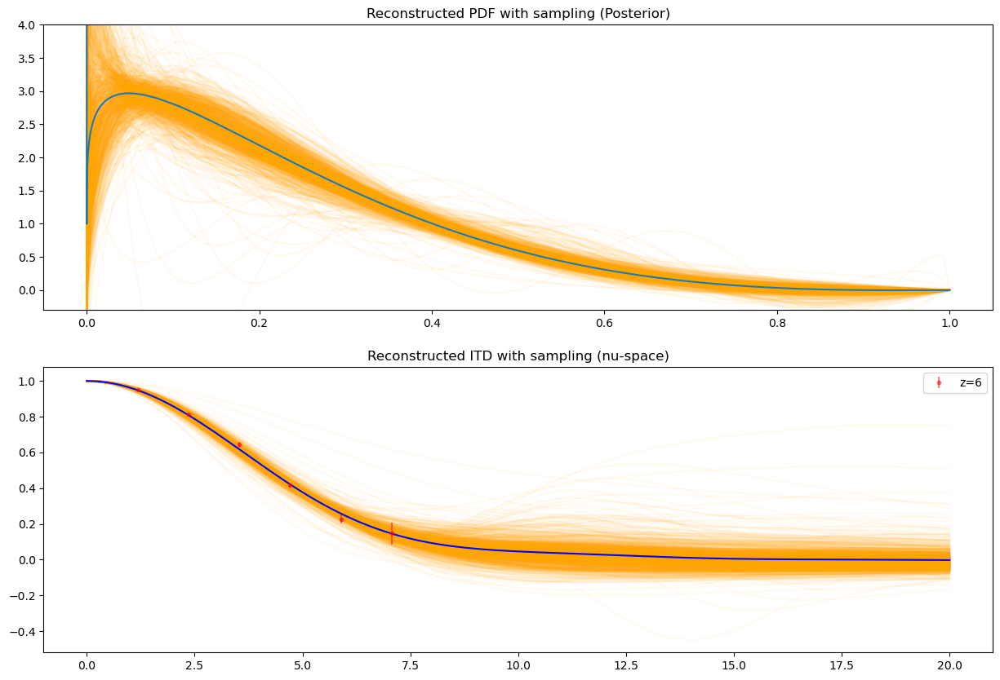

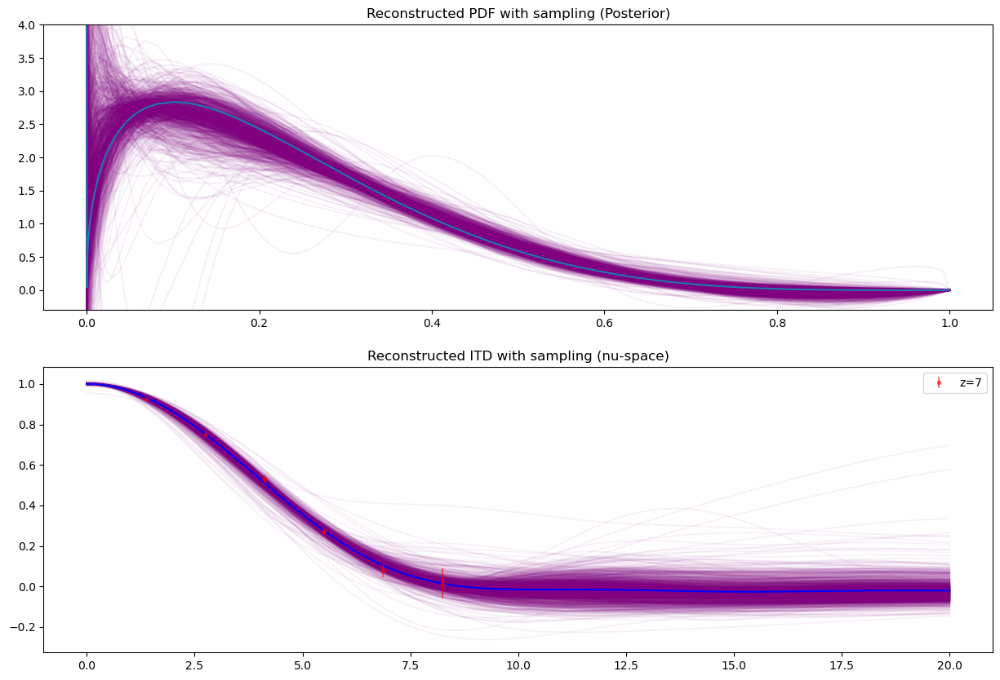

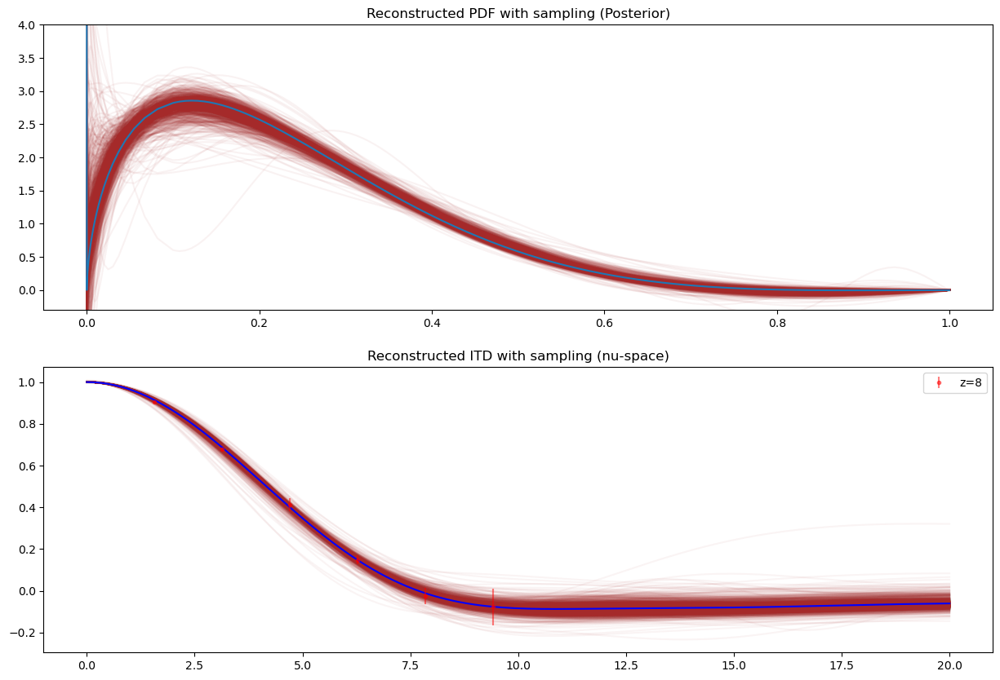

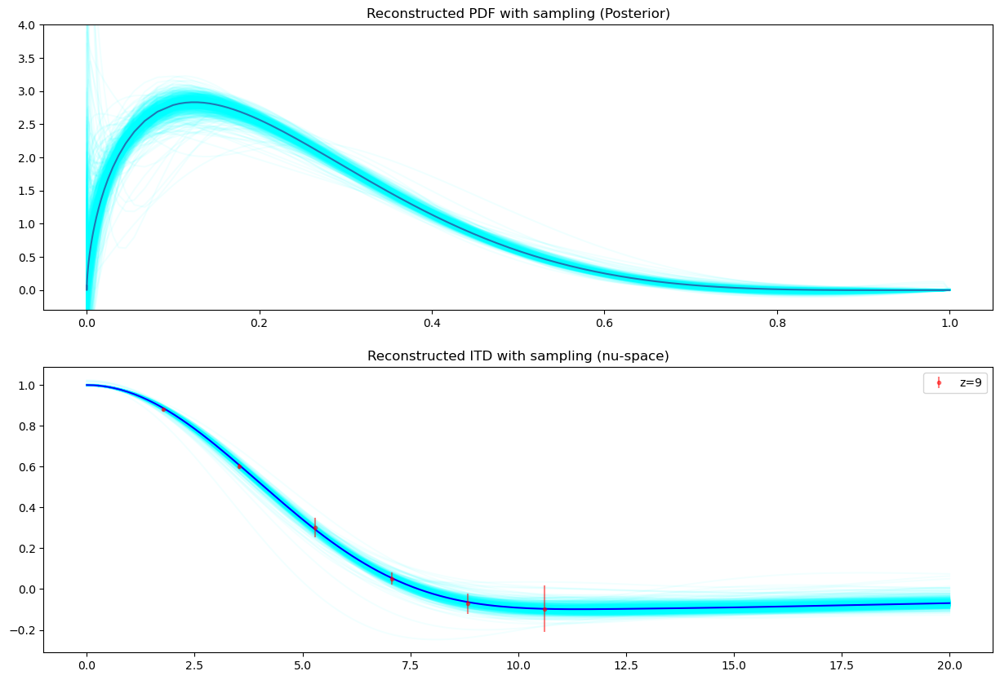

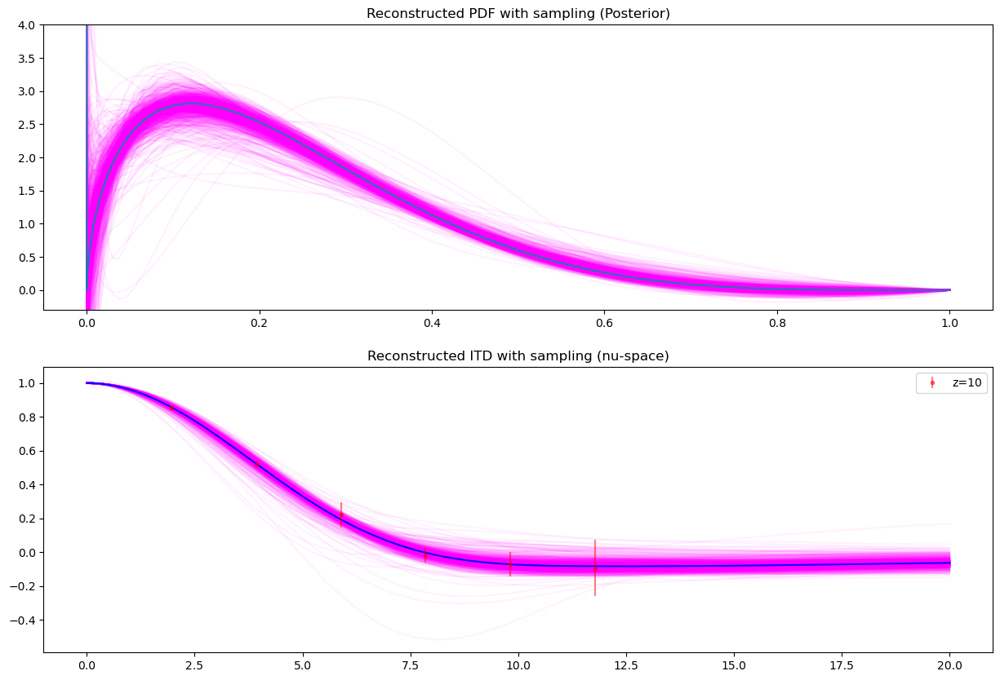

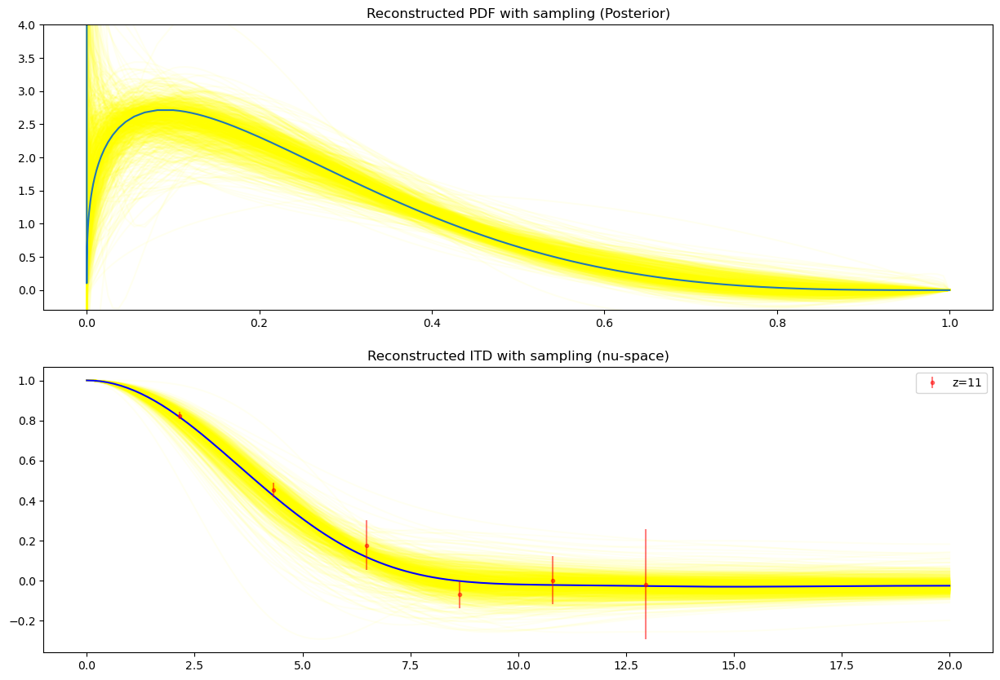

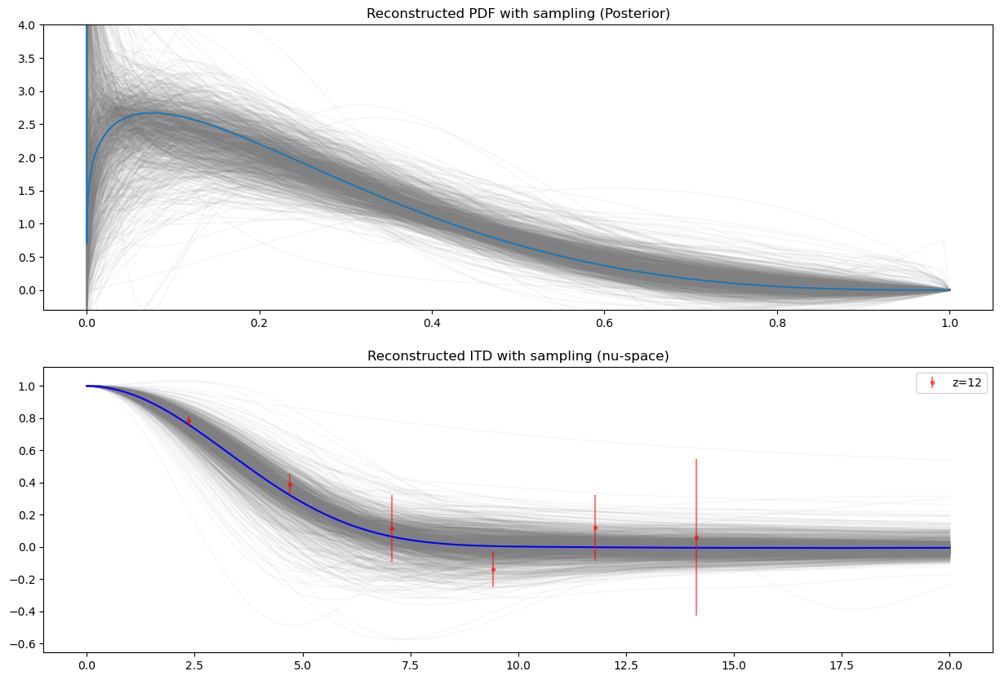

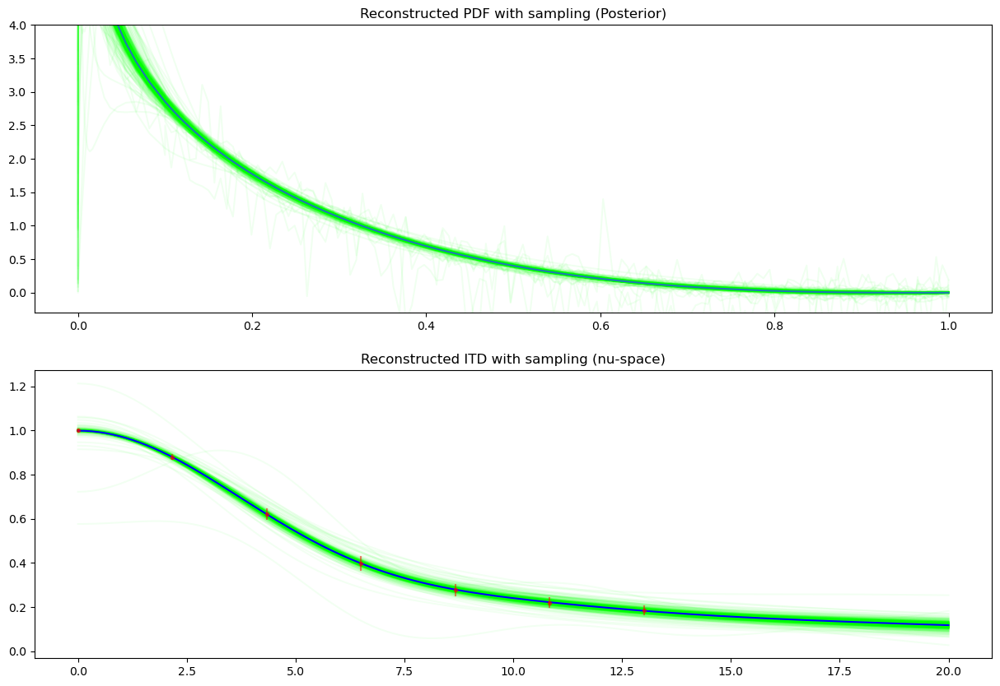

In [104]:
for i in range(3,13):
    fig, ax= plt.subplots(2,figsize=(15, 10))
    ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
    ax[1].set_title("Reconstructed ITD with sampling (nu-space)")
    qofx,cov,pms=fits_comb[i].Uncertaintyanalysis(traces[i][::100])
    cov = 0.5*(cov+cov.T) +1e-5*tr.eye(cov.shape[0])
    pms=tr.stack(pms)
    nn = np.linspace(0,20,128)
    iB = np.zeros((nn.shape[0],Nx))
    fe=FE2_Integrator(x_grid)
    for k in range(nn.shape[0]):
        iB[k,:] = fe.set_up_integration(Kernel= lambda x : np.cos(nn[k]*x))
    ttQ = pms@iB.T
    col=['red','blue','green','pink','black','orange','purple','brown','cyan','magenta','yellow','grey','lime']
    for j in range(len(pms)):
        ax[0].plot(x_gri0,pms[j],color=col[i],alpha=0.06)
    ax[0].plot(x_gri0,qofx,label=fits_comb[i].name)
    ax[0].set_ylim([-0.3,4])

    #plot ttQ with the mean
    mttQ = ttQ.mean(axis=0)
    covttQ = np.corrcoef(ttQ.T)
    ax[1].plot(nn,ttQ.T,color=col[i],alpha=0.05)
    ax[1].plot(nn,mttQ,color='blue')
    if i==12:
        numock = np.linspace(0,13,7)
        jM = pseudo_data(numock,-0.3,2.9,1.0,0.02,.2,0.2,1000)
        M = np.mean(jM,axis=0)
        eM = np.std(jM,axis=0)
        
        plt.errorbar(numock,M,eM,fmt='.',alpha=0.5,label='mock data',color='red')
        break
    plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color='red')
    plt.legend()
    plt.show()

This plots were generated with a nugget term. 

# Compare results 

In [10]:
# Función para procesar un archivo .dat y convertirlo a tensor
def dat_to_tensor(file_path):
    try:
        # Leer el archivo .dat en un arreglo de numpy
        data_array = np.loadtxt(file_path)
        # Convertir a tensor de PyTorch
        data_tensor = tr.tensor(data_array, dtype=tr.float32)
        return data_tensor
    except Exception as e:
        print(f"Error al procesar el archivo {file_path}: {e}")
        return None

# Función para agrupar archivos según patrones (por ejemplo, 'real', 'imag', 'z3', etc.)
def group_files_by_pattern(files, patterns):
    grouped_files = {pattern: [] for pattern in patterns}
    for file in files:
        for pattern in patterns:
            if re.search(pattern, file):
                grouped_files[pattern].append(file)
    return grouped_files

In [ ]:
import os
import re

# Ruta de la carpeta que contiene los archivos .dat
folder_path = "/sciclone/pscr/yacahuanamedra/results_z369"  # Cambia esto a tu carpeta

# Listar todos los archivos .dat en la carpeta
all_files = [f for f in os.listdir(folder_path) if f.endswith('.dat')]

# Definir patrones para agrupar archivos (por ejemplo, 'real', 'imag', 'z3', 'z6', etc.)
patterns = ['real', 'imag', 'z3', 'z6', 'z9']

# Agrupar archivos por patrones
grouped_files = group_files_by_pattern(all_files, patterns)

# Procesar cada grupo de archivos y convertirlos a tensores
for pattern, files in grouped_files.items():
    print(f"Procesando archivos para el patrón: {pattern}")
    for file in files:
        file_path = os.path.join(folder_path, file)
        tensor = dat_to_tensor(file_path)
        if tensor is not None:
            # Imprimir la forma del tensor y su nombre
            print(f"Archivo: {file} -> Tensor shape: {tensor.shape}")
            # Opcional: Guardar el tensor si es necesario
            tensor_save_path = os.path.join(folder_path, f"{file}.pt")
            tr.save(tensor, tensor_save_path)
            print(f"Tensor guardado en: {tensor_save_path}")

Procesando archivos para el patrón: real
Archivo: grid_mean_M_real_z3.dat -> Tensor shape: torch.Size([50])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z3.dat.pt
Archivo: grid_mean_q_real_z3.dat -> Tensor shape: torch.Size([251])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z3.dat.pt
Archivo: hd_mean_q_real_z6.dat -> Tensor shape: torch.Size([100])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z6.dat.pt
Archivo: grid_error_q_real_z3.dat -> Tensor shape: torch.Size([251])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z3.dat.pt
Archivo: hd_mean_M_real_z6.dat -> Tensor shape: torch.Size([52])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z6.dat.pt
Archivo: grid_error_M_real_z3.dat -> Tensor shape: torch.Size([50])
Tensor guardado en: /sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z3.dat.pt
Archivo: hd_error_

In [11]:
jk_x_grid=dat_to_tensor("/sciclone/pscr/yacahuanamedra/results_z369/jk_x_grid.dat")
grid_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z6.dat.pt",weights_only=False)
grid_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_M_real_z3.dat.pt",weights_only=False)
grid_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z6.dat.pt",weights_only=False)
grid_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_error_q_real_z3.dat.pt",weights_only=False)
grid_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z3.dat.pt",weights_only=False)
grid_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_q_real_z6.dat.pt",weights_only=False)
grid_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z3.dat.pt",weights_only=False)
grid_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/grid_mean_M_real_z6.dat.pt",weights_only=False)
print("jk_x_grid",jk_x_grid.shape,"\ngrid_error_M_real_z6",grid_error_M_real_z6.shape,"\ngrid_error_M_real_z3",grid_error_M_real_z3.shape,"\ngrid_error_q_real_z6",grid_error_q_real_z6.shape,"\ngrid_error_q_real_z3",grid_error_q_real_z3.shape,"\ngrid_mean_q_real_z3",grid_mean_q_real_z3.shape,"\ngrid_mean_q_real_z6",grid_mean_q_real_z6.shape,"\ngrid_mean_M_real_z3",grid_mean_M_real_z3.shape,"\ngrid_mean_M_real_z6",grid_mean_M_real_z6.shape)
hd_error_M_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z3.dat.pt",weights_only=False)
hd_error_M_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z6.dat.pt",weights_only=False)
hd_error_M_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_imag_z9.dat.pt",weights_only=False)
print("hd_error_M_imag_z3",hd_error_M_imag_z3.shape,"\nhd_error_M_imag_z6",hd_error_M_imag_z6.shape,"\nhd_error_M_imag_z9",hd_error_M_imag_z9.shape)
hd_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z3.dat.pt",weights_only=False)
hd_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z6.dat.pt",weights_only=False)
hd_error_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_M_real_z9.dat.pt",weights_only=False)
print("hd_error_M_real_z3",hd_error_M_real_z3.shape,"\nhd_error_M_real_z6",hd_error_M_real_z6.shape,"\nhd_error_M_real_z9",hd_error_M_real_z9.shape)
hd_error_q_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z3.dat.pt",weights_only=False)
hd_error_q_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z6.dat.pt",weights_only=False)
hd_error_q_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_imag_z9.dat.pt",weights_only=False)
print("hd_error_q_imag_z3",hd_error_q_imag_z3.shape,"\nhd_error_q_imag_z6",hd_error_q_imag_z6.shape,"\nhd_error_q_imag_z9",hd_error_q_imag_z9.shape)
hd_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z3.dat.pt",weights_only=False)
hd_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z6.dat.pt",weights_only=False)
hd_error_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_error_q_real_z9.dat.pt",weights_only=False)
print("hd_error_q_real_z3",hd_error_q_real_z3.shape,"\nhd_error_q_real_z6",hd_error_q_real_z6.shape,"\nhd_error_q_real_z9",hd_error_q_real_z9.shape)
hd_mean_M_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z3.dat.pt",weights_only=False)
hd_mean_M_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z6.dat.pt",weights_only=False)
hd_mean_M_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_imag_z9.dat.pt",weights_only=False)
print("hd_mean_M_imag_z3",hd_mean_M_imag_z3.shape,"\nhd_mean_M_imag_z6",hd_mean_M_imag_z6.shape,"\nhd_mean_M_imag_z9",hd_mean_M_imag_z9.shape)
hd_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z3.dat.pt",weights_only=False)
hd_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z6.dat.pt",weights_only=False)
hd_mean_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_M_real_z9.dat.pt",weights_only=False)
print("hd_mean_M_real_z3",hd_mean_M_real_z3.shape,"\nhd_mean_M_real_z6",hd_mean_M_real_z6.shape,"\nhd_mean_M_real_z9",hd_mean_M_real_z9.shape)
hd_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z3.dat.pt",weights_only=False)
hd_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z6.dat.pt",weights_only=False)
hd_mean_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_real_z9.dat.pt",weights_only=False)
print("hd_mean_q_real_z3",hd_mean_q_real_z3.shape,"\nhd_mean_q_real_z6",hd_mean_q_real_z6.shape,"\nhd_mean_q_real_z9",hd_mean_q_real_z9.shape)
hd_mean_q_imag_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z3.dat.pt",weights_only=False)
hd_mean_q_imag_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z6.dat.pt",weights_only=False)
hd_mean_q_imag_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_mean_q_imag_z9.dat.pt",weights_only=False)
print("hd_mean_q_imag_z3",hd_mean_q_imag_z3.shape,"\nhd_mean_q_imag_z6",hd_mean_q_imag_z6.shape,"\nhd_mean_q_imag_z9",hd_mean_q_imag_z9.shape)
hd_nu_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z3.dat.pt",weights_only=False)
hd_nu_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z6.dat.pt",weights_only=False)
hd_nu_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_nu_grid_z9.dat.pt",weights_only=False)
print("hd_nu_grid_z3",hd_nu_grid_z3.shape,"\nhd_nu_grid_z6",hd_nu_grid_z6.shape,"\nhd_nu_grid_z9",hd_nu_grid_z9.shape)
hd_x_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z3.dat.pt",weights_only=False)
hd_x_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z6.dat.pt",weights_only=False)
hd_x_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hd_x_grid_z9.dat.pt",weights_only=False)
print("hd_x_grid_z3",hd_x_grid_z3.shape,"\nhd_x_grid_z6",hd_x_grid_z6.shape,"\nhd_x_grid_z9",hd_x_grid_z9.shape)
hmc_mean_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z3.dat.pt",weights_only=False)
hmc_mean_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z6.dat.pt",weights_only=False)
#hmc_mean_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_q_real_z9.dat.pt",weights_only=False)
print("hmc_mean_q_real_z3",hmc_mean_q_real_z3.shape,"\nhmc_mean_q_real_z6",hmc_mean_q_real_z6.shape)
hmc_mean_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z3.dat.pt",weights_only=False)
hmc_mean_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z6.dat.pt",weights_only=False)
#hmc_mean_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_mean_M_real_z9.dat.pt",weights_only=False)
print("hmc_mean_M_real_z3",hmc_mean_M_real_z3.shape,"\nhmc_mean_M_real_z6",hmc_mean_M_real_z6.shape)
hmc_error_q_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z3.dat.pt",weights_only=False)
hmc_error_q_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z6.dat.pt",weights_only=False)
#hmc_error_q_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_q_real_z9.dat.pt",weights_only=False)
print("hmc_error_q_real_z3",hmc_error_q_real_z3.shape,"\nhmc_error_q_real_z6",hmc_error_q_real_z6.shape)
hmc_error_M_real_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z3.dat.pt",weights_only=False)
hmc_error_M_real_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z6.dat.pt",weights_only=False)
#hmc_error_M_real_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/hmc_error_M_real_z9.dat.pt",weights_only=False)
print("hmc_error_M_real_z3",hmc_error_M_real_z3.shape,"\nhmc_error_M_real_z6",hmc_error_M_real_z6.shape)
jk_nu_grid_z3= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z3.dat.pt",weights_only=False)
jk_nu_grid_z6= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z6.dat.pt",weights_only=False)
jk_nu_grid_z9= tr.load("/sciclone/pscr/yacahuanamedra/results_z369/jk_nu_grid_z9.dat.pt",weights_only=False)


jk_x_grid torch.Size([251]) 
grid_error_M_real_z6 torch.Size([50]) 
grid_error_M_real_z3 torch.Size([50]) 
grid_error_q_real_z6 torch.Size([251]) 
grid_error_q_real_z3 torch.Size([251]) 
grid_mean_q_real_z3 torch.Size([251]) 
grid_mean_q_real_z6 torch.Size([251]) 
grid_mean_M_real_z3 torch.Size([50]) 
grid_mean_M_real_z6 torch.Size([50])
hd_error_M_imag_z3 torch.Size([52]) 
hd_error_M_imag_z6 torch.Size([52]) 
hd_error_M_imag_z9 torch.Size([52])
hd_error_M_real_z3 torch.Size([52]) 
hd_error_M_real_z6 torch.Size([52]) 
hd_error_M_real_z9 torch.Size([52])
hd_error_q_imag_z3 torch.Size([100]) 
hd_error_q_imag_z6 torch.Size([100]) 
hd_error_q_imag_z9 torch.Size([100])
hd_error_q_real_z3 torch.Size([100]) 
hd_error_q_real_z6 torch.Size([100]) 
hd_error_q_real_z9 torch.Size([100])
hd_mean_M_imag_z3 torch.Size([52]) 
hd_mean_M_imag_z6 torch.Size([52]) 
hd_mean_M_imag_z9 torch.Size([52])
hd_mean_M_real_z3 torch.Size([52]) 
hd_mean_M_real_z6 torch.Size([52]) 
hd_mean_M_real_z9 torch.Size([52])


/local/scr/yacahuanamedra/TMPDIR/ipykernel_1311891/3719416691.py:67: RuntimeWarning: invalid value encountered in sqrt
  Qerror=fCI*np.diag(covsnu[i])**0.5


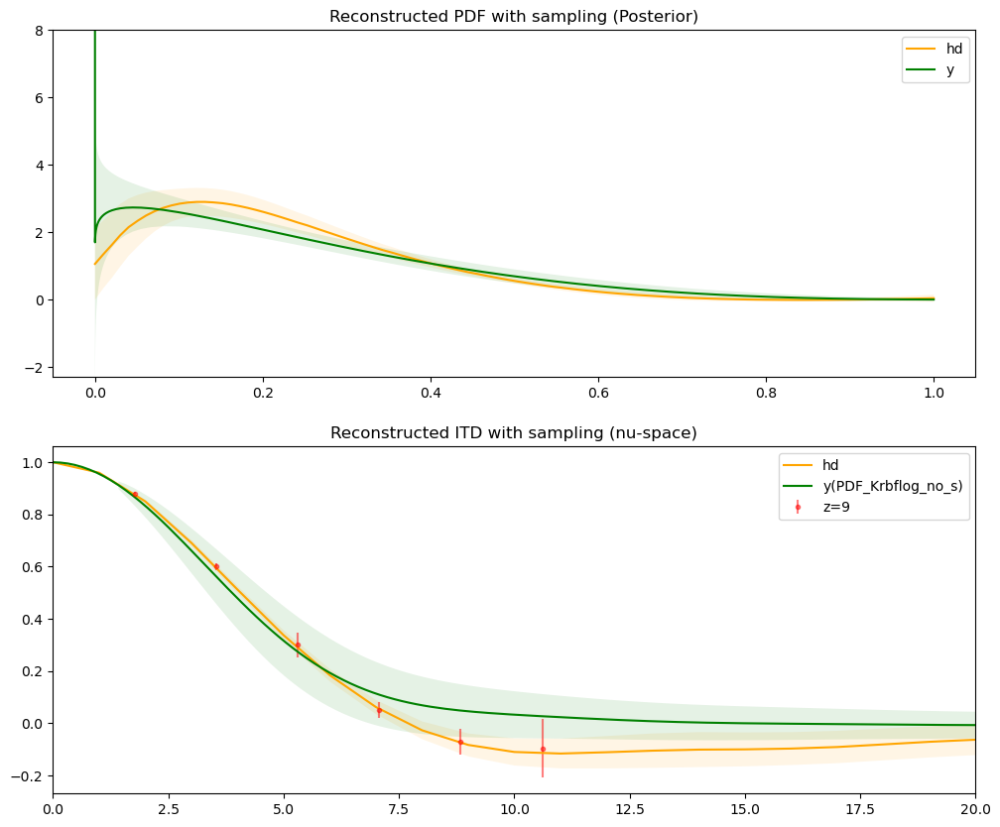

In [ ]:
#plot z3 and z6 and z9
fCI=1.
fig, ax= plt.subplots(2,figsize=(12, 10))
ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
ax[1].set_title("Reconstructed ITD with sampling (nu-space)")

col1=['l','green','blue','pink','black','red','purple','brown','orange','magenta','yellow','grey','lime']

#plot the data
#l=[2,5,8]
i=8
plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color="red")
if i==2:

    #####z=3
    #Herve
    ax[0].plot(hd_x_grid_z3,hd_mean_q_real_z3,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z3, hd_mean_q_real_z3 - hd_error_q_real_z3, hd_mean_q_real_z3 + hd_error_q_real_z3, facecolor='orange', alpha=0.1)
    #Joe
    ax[0].plot(jk_x_grid,hmc_mean_q_real_z3,label='jk',color='blue')
    ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z3 - hmc_error_q_real_z3, hmc_mean_q_real_z3 + hmc_error_q_real_z3, facecolor='blue', alpha=0.1)

    ######### z=3
    #Herve
    ax[1].plot(hd_nu_grid_z3,hd_mean_M_real_z3,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z3, hd_mean_M_real_z3 - hd_error_M_real_z3, hd_mean_M_real_z3 + hd_error_M_real_z3, facecolor='orange', alpha=0.1)
    #Joe
    ax[1].plot(jk_nu_grid_z3,hmc_mean_M_real_z3,label='jk',color='blue')
    ax[1].fill_between(jk_nu_grid_z3, hmc_mean_M_real_z3 - hmc_error_M_real_z3, hmc_mean_M_real_z3 + hmc_error_M_real_z3, facecolor='blue', alpha=0.1)

elif i==5:
    ##### z=6
    #Herve
    ax[0].plot(hd_x_grid_z6,hd_mean_q_real_z6,label='z=6',color='orange')
    ax[0].fill_between(hd_x_grid_z6, hd_mean_q_real_z6 - hd_error_q_real_z6, hd_mean_q_real_z6 + hd_error_q_real_z6, facecolor='orange', alpha=0.1)
    #Joe
    ax[0].plot(jk_x_grid,hmc_mean_q_real_z6,label='jk',color='blue')
    ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z6 - hmc_error_q_real_z6, hmc_mean_q_real_z6 + hmc_error_q_real_z6, facecolor='blue', alpha=0.1)
    
    ####### z=6
    #Herve
    ax[1].plot(hd_nu_grid_z6,hd_mean_M_real_z6,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z6, hd_mean_M_real_z6 - hd_error_M_real_z6, hd_mean_M_real_z6 + hd_error_M_real_z6, facecolor='orange', alpha=0.1)
    #Joe
    ax[1].plot(jk_nu_grid_z6,hmc_mean_M_real_z6,label='jk',color='blue')
    ax[1].fill_between(jk_nu_grid_z6, hmc_mean_M_real_z6 - hmc_error_M_real_z6, hmc_mean_M_real_z6 + hmc_error_M_real_z6, facecolor='blue', alpha=0.1)
elif i==8:

    #z=9
    ax[0].plot(hd_x_grid_z9,hd_mean_q_real_z9,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z9, hd_mean_q_real_z9 - hd_error_q_real_z9, hd_mean_q_real_z9 + hd_error_q_real_z9, facecolor='orange', alpha=0.1)
    #Joe
    #ax[0].plot(jk_x_grid,hmc_mean_q_real_z9,label='jk',color='blue')
    #ax[0].fill_between(jk_x_grid, hmc_mean_q_real_z9 - hmc_error_q_real_z9, hmc_mean_q_real_z9 + hmc_error_q_real_z9, facecolor='blue', alpha=0.1)
    #mine

    ###z=9
    ax[1].plot(hd_nu_grid_z9,hd_mean_M_real_z9,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z9, hd_mean_M_real_z9 - hd_error_M_real_z9, hd_mean_M_real_z9 + hd_error_M_real_z9, facecolor='orange', alpha=0.1)

#mine
ax[0].plot(x_gri0,qofxs[i],label='y',color='green')
qerror=fCI*np.diag(np.abs(covs[i]))**(0.5)
ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='green', alpha=0.1)
#mine
mttQ=Qofvs[i]
Qerror=fCI*np.diag(covsnu[i])**0.5
ax[1].plot(nn,mttQ,label='y('+modelname+'_'+kernelname+')',color='green')
ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor='green', alpha=0.1)

#legends
ax[0].legend()

#ylimit
ax[0].set_ylim([-2.3,8])
#limit the x axis
plt.xlim([0,20])

ax[1].legend()

#save plot as pdf
plt.savefig('z='+str(i+1)+'a('+modelname+'_'+kernelname+')'+'CI='+str(fCI)+'.pdf')
plt.show()

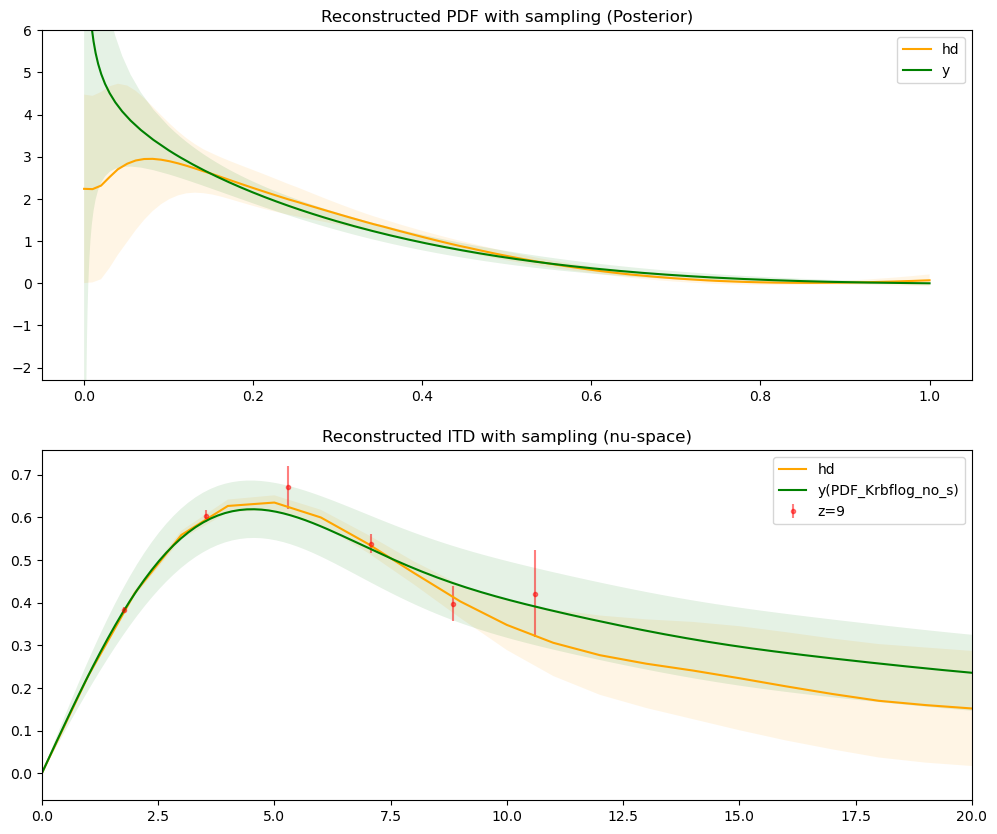

In [14]:
#plot imaginary part
fCI=1.
fig, ax= plt.subplots(2,figsize=(12, 10))
ax[0].set_title("Reconstructed PDF with sampling (Posterior)")
ax[1].set_title("Reconstructed ITD with sampling (nu-space)")

col1=['l','green','blue','pink','black','red','purple','brown','orange','magenta','yellow','grey','lime']

i=8
plt.errorbar(nu.T[i],rM.T[i],yerr=rMe.T[i],fmt='.',alpha=0.5,label='z='+str(i+1),color="red")

if i==2:
    
    #####z=3
    #Herve
    ax[0].plot(hd_x_grid_z3,hd_mean_q_imag_z3,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z3, hd_mean_q_imag_z3 - hd_error_q_imag_z3, hd_mean_q_imag_z3 + hd_error_q_imag_z3, facecolor='orange', alpha=0.1)


    ######### z=3
    #Herve
    ax[1].plot(hd_nu_grid_z3,hd_mean_M_imag_z3,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z3, hd_mean_M_imag_z3 - hd_error_M_imag_z3, hd_mean_M_imag_z3 + hd_error_M_imag_z3, facecolor='orange', alpha=0.1)

elif i==5:

    ##### z=6
    #Herve
    ax[0].plot(hd_x_grid_z6,hd_mean_q_imag_z6,label='z=6',color='orange')
    ax[0].fill_between(hd_x_grid_z6, hd_mean_q_imag_z6 - hd_error_q_imag_z6, hd_mean_q_imag_z6 + hd_error_q_imag_z6, facecolor='orange', alpha=0.1)
    
    ####### z=6
    #Herve
    ax[1].plot(hd_nu_grid_z6,hd_mean_M_imag_z6,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z6, hd_mean_M_imag_z6 - hd_error_M_imag_z6, hd_mean_M_imag_z6 + hd_error_M_imag_z6, facecolor='orange', alpha=0.1)

elif i==8:

    #z=9
    ax[0].plot(hd_x_grid_z9,hd_mean_q_imag_z9,label='hd',color='orange')
    ax[0].fill_between(hd_x_grid_z9, hd_mean_q_imag_z9 - hd_error_q_imag_z9, hd_mean_q_imag_z9 + hd_error_q_imag_z9, facecolor='orange', alpha=0.1)
    #mine

    ###z=9
    ax[1].plot(hd_nu_grid_z9,hd_mean_M_imag_z9,label='hd',color='orange')
    ax[1].fill_between(hd_nu_grid_z9, hd_mean_M_imag_z9 - hd_error_M_imag_z9, hd_mean_M_imag_z9 + hd_error_M_imag_z9, facecolor='orange', alpha=0.1)

#mine
ax[0].plot(x_gri0,qofxs[i],label='y',color='green')
qerror=fCI*np.diag(np.abs(covs[i]))**(0.5)
ax[0].fill_between(x_gri0, qofxs[i] - qerror, qofxs[i] + qerror, facecolor='green', alpha=0.1)
#mine
mttQ=Qofvs[i]
Qerror=fCI*np.diag(covsnu[i])**0.5
ax[1].plot(nn,mttQ,label='y('+modelname+'_'+kernelname+')',color='green')
ax[1].fill_between(nn, mttQ - Qerror, mttQ + Qerror, facecolor='green', alpha=0.1)

#legends
ax[0].legend()

#ylimit
ax[0].set_ylim([-2.3,6])
#limit the x axis
plt.xlim([0,20])

ax[1].legend()

#save plot as pdf
plt.savefig(ITD+'z='+str(i+1)+'a('+modelname+'_'+kernelname+')'+'CI='+str(fCI)+'.pdf')
plt.show()